**Installation of SimPy""
If not available**

In [24]:
#!pip install simpy

**Import of required modules**

In [25]:
import simpy
import numpy as np
import numpy.random as random

**Parameters settings**

In [26]:
MAXSIMTIME = 50000
VERBOSE = True
LAMBDA = 6.8
MU = 8.0
POPULATION = 50000000
MAXWAITTIME = 3
LOGGED = True
PLOTTED = True
RENEGED = True

**Discrete-Event Simulation model**


**The definition of a job**.

The properties of a job are


1. job execution time
2. job arrival time
3. job maximum waiting time

In [27]:
class Job:
    def __init__(self, name, arrtime, duration, maxwaittime):
        self.name = name
        self.arrtime = arrtime
        self.duration = duration
        self.maxwaittime = maxwaittime

    def __str__(self):
        return '%s at %.3f, duration %.3f, max waiting %.3f' %(self.name, self.arrtime, self.duration, self.maxwaittime)

**The definition of server**

 There are 2 arguments needed for a server:
 1. env: SimPy environment
 2. queue discipline: FIFO - First In First Out

In [28]:
class Server:
    def __init__(self, env, strat = 'FIFO'):
        self.env = env
        self.strat = strat
        self.Jobs = list(())
        self.serversleeping = None
        ### Statistics
        self.waitingTime = 0
        self.idleTime = 0
        self.jobsDone = 0
        ### Register a new server process
        env.process(self.serve())

    def serve(self):
        while True:
            ''' Do nothing, just change server to idle
            and then yield a wait event which takes infinite time
            '''
            if len(self.Jobs) == 0:
                self.serversleeping = env.process(self.waiting(self.env))
                t1 = self.env.now
                yield self.serversleeping
                ### Accumulate the server idle time
                self.idleTime += self.env.now - t1
            else:
                ### Get the first job to be served
                if self.strat == 'SJF':
                    self.Jobs.sort(key = SJF)
                    j = self.Jobs.pop(0)
                else: # FIFO by default
                    j = self.Jobs.pop(0)
                if LOGGED:
                    qlog.write('%.4f\t%d\t%d\n' 
                        %(self.env.now, 1 if len(self.Jobs) > 0 else 0, len(self.Jobs)))

                ### Sum up the waiting time
                self.waitingTime += self.env.now - j.arrtime
                ### Yield an event for the job finish
                yield self.env.timeout(j.duration)
                ### Sum up the jobs done 
                self.jobsDone += 1

    def waiting(self, env):
        try:
            if VERBOSE:
                print('Server is idle at %.2f' %self.env.now)
            yield self.env.timeout(MAXSIMTIME)
        except simpy.Interrupt as i:
            if VERBOSE:
                 print('Server waken up and works at %.2f' %self.env.now)
                    

**The arrival process**

The arrival process is exponentially distributed which is parameterized by
1. number of servers
2. maximum number of population
3. arrival rate $\lambda$
4. service rate $\mu$
*Note that, the implementation of the arrival process embeds both arrival and service distributions.*

In [29]:
class JobGenerator:
    def __init__(self, env, server, nrjobs = 10000000, lam = 5, mu = 8, maxwait = 6):
        self.server = server
        self.nrjobs = nrjobs
        self.interarrivaltime = 1/lam
        self.servicetime = 1/mu
        self.maxwaittime = maxwait
        ## Statistics
        self.totalJob = 0
        ### Register a new job generator process
        env.process(self.generateJobs(env))
        
    def generateJobs(self, env):
        while True:
            ### Yield an event for new job arrival
            jobInterarrival = random.exponential(self.interarrivaltime)
            yield env.timeout(jobInterarrival)

            ### Generate service time and add job to the list
            job_duration = random.exponential(self.servicetime)
            job = Job('Job %s' %(self.totalJob + 1), env.now, job_duration, self.maxwaittime)
            self.server.Jobs.append(job)
            ### Register new process for renege job
            if RENEGED:
                env.process(self.renegeJob(env, job))
            if VERBOSE:
                print('Finish %s: t = %.2f, l = %.2f, dt = %.2f' 
                    %(job.name, env.now, job.duration, jobInterarrival))
            self.totalJob += 1

            ### If server is idle, wake it up'''
            if not self.server.serversleeping.triggered:
                self.server.serversleeping.interrupt('Wake up, please.')
    
    def renegeJob(self, env, job):
        yield env.timeout(job.maxwaittime)
        if job in self.server.Jobs:
            if VERBOSE:
                print('RENEGE ', job)
            self.server.Jobs.remove(job)


**Open the log file**

If requested.

In [31]:
if LOGGED:
    if RENEGED:
        qlog = open('mm1SD-l%d-m%d-w%d.csv' %(LAMBDA, MU, MAXWAITTIME), 'w')
    else:
        qlog = open('mm1-l%d-m%d.csv' %(LAMBDA, MU), 'w')
    qlog.write('0\t0\t0\n' )

**Start SimPy environment**

In [32]:
env = simpy.Environment()
MyServer = Server(env, 'FIFO')
MyJobGenerator = JobGenerator(env, MyServer, POPULATION, LAMBDA, MU, MAXWAITTIME)

**Run the simulation** 

In [33]:
env.run(until = MAXSIMTIME)

Server is idle at 0.00
Finish Job 1: t = 0.09, l = 0.03, dt = 0.09
Server waken up and works at 0.09
Server is idle at 0.12
Finish Job 2: t = 0.14, l = 0.07, dt = 0.04
Server waken up and works at 0.14
Server is idle at 0.21
Finish Job 3: t = 0.42, l = 0.25, dt = 0.28
Server waken up and works at 0.42
Finish Job 4: t = 0.50, l = 0.04, dt = 0.08
Server is idle at 0.71
Finish Job 5: t = 0.85, l = 0.19, dt = 0.36
Server waken up and works at 0.85
Server is idle at 1.04
Finish Job 6: t = 1.42, l = 0.12, dt = 0.57
Server waken up and works at 1.42
Finish Job 7: t = 1.45, l = 0.09, dt = 0.03
Finish Job 8: t = 1.54, l = 0.07, dt = 0.09
Finish Job 9: t = 1.65, l = 0.11, dt = 0.11
Finish Job 10: t = 1.70, l = 0.10, dt = 0.05
Finish Job 11: t = 1.86, l = 0.03, dt = 0.16
Finish Job 12: t = 1.91, l = 0.03, dt = 0.05
Finish Job 13: t = 1.94, l = 0.34, dt = 0.03
Finish Job 14: t = 2.22, l = 0.35, dt = 0.29
Finish Job 15: t = 2.30, l = 0.05, dt = 0.08
Finish Job 16: t = 2.67, l = 0.02, dt = 0.37
Serv

Finish Job 2961: t = 422.53, l = 0.06, dt = 0.16
Finish Job 2962: t = 422.68, l = 0.01, dt = 0.15
Finish Job 2963: t = 422.97, l = 0.11, dt = 0.29
Finish Job 2964: t = 423.05, l = 0.14, dt = 0.08
Finish Job 2965: t = 423.15, l = 0.13, dt = 0.10
Finish Job 2966: t = 423.42, l = 0.16, dt = 0.26
Finish Job 2967: t = 423.79, l = 0.02, dt = 0.37
Finish Job 2968: t = 423.86, l = 0.03, dt = 0.07
Finish Job 2969: t = 424.22, l = 0.20, dt = 0.36
Finish Job 2970: t = 424.28, l = 0.14, dt = 0.06
Finish Job 2971: t = 424.37, l = 0.07, dt = 0.09
Finish Job 2972: t = 424.72, l = 0.10, dt = 0.35
Finish Job 2973: t = 424.87, l = 0.11, dt = 0.15
Finish Job 2974: t = 424.92, l = 0.01, dt = 0.05
Server is idle at 425.13
Finish Job 2975: t = 425.31, l = 0.17, dt = 0.39
Server waken up and works at 425.31
Finish Job 2976: t = 425.35, l = 0.04, dt = 0.04
Finish Job 2977: t = 425.37, l = 0.00, dt = 0.01
Server is idle at 425.52
Finish Job 2978: t = 425.59, l = 0.09, dt = 0.22
Server waken up and works at 425

Finish Job 5276: t = 761.82, l = 0.05, dt = 0.43
Finish Job 5277: t = 761.83, l = 0.21, dt = 0.01
Finish Job 5278: t = 761.88, l = 0.05, dt = 0.05
Finish Job 5279: t = 761.97, l = 0.08, dt = 0.09
Finish Job 5280: t = 762.02, l = 0.00, dt = 0.05
Finish Job 5281: t = 762.41, l = 0.09, dt = 0.39
Finish Job 5282: t = 762.63, l = 0.09, dt = 0.21
Finish Job 5283: t = 762.63, l = 0.05, dt = 0.01
Finish Job 5284: t = 762.71, l = 0.03, dt = 0.08
Finish Job 5285: t = 762.83, l = 0.35, dt = 0.12
Finish Job 5286: t = 762.83, l = 0.08, dt = 0.00
Finish Job 5287: t = 762.85, l = 0.04, dt = 0.02
Finish Job 5288: t = 762.89, l = 0.04, dt = 0.03
Finish Job 5289: t = 762.89, l = 0.04, dt = 0.01
Finish Job 5290: t = 763.16, l = 0.16, dt = 0.27
Finish Job 5291: t = 763.16, l = 0.11, dt = 0.00
Finish Job 5292: t = 763.34, l = 0.06, dt = 0.18
Finish Job 5293: t = 763.46, l = 0.07, dt = 0.11
Finish Job 5294: t = 763.52, l = 0.04, dt = 0.06
Finish Job 5295: t = 764.06, l = 0.38, dt = 0.54
Finish Job 5296: t =

Finish Job 7929: t = 1155.68, l = 0.40, dt = 0.32
Server waken up and works at 1155.68
Finish Job 7930: t = 1155.79, l = 0.08, dt = 0.11
Finish Job 7931: t = 1155.85, l = 0.09, dt = 0.06
Finish Job 7932: t = 1156.00, l = 0.07, dt = 0.16
Finish Job 7933: t = 1156.06, l = 0.05, dt = 0.05
Finish Job 7934: t = 1156.08, l = 0.17, dt = 0.03
Finish Job 7935: t = 1156.13, l = 0.33, dt = 0.04
Finish Job 7936: t = 1156.20, l = 0.04, dt = 0.07
Finish Job 7937: t = 1156.36, l = 0.07, dt = 0.16
Finish Job 7938: t = 1156.46, l = 0.23, dt = 0.10
Finish Job 7939: t = 1156.83, l = 0.09, dt = 0.37
Finish Job 7940: t = 1157.24, l = 0.07, dt = 0.41
Server is idle at 1157.35
Finish Job 7941: t = 1157.49, l = 0.02, dt = 0.25
Server waken up and works at 1157.49
Finish Job 7942: t = 1157.51, l = 0.03, dt = 0.02
Finish Job 7943: t = 1157.51, l = 0.04, dt = 0.00
Server is idle at 1157.58
Finish Job 7944: t = 1157.78, l = 0.17, dt = 0.27
Server waken up and works at 1157.78
Finish Job 7945: t = 1157.84, l = 0.1

Finish Job 9970: t = 1459.90, l = 0.38, dt = 0.04
Finish Job 9971: t = 1460.16, l = 0.06, dt = 0.26
Finish Job 9972: t = 1460.28, l = 0.00, dt = 0.11
Finish Job 9973: t = 1460.45, l = 0.22, dt = 0.18
Finish Job 9974: t = 1460.49, l = 0.15, dt = 0.04
Finish Job 9975: t = 1460.64, l = 0.18, dt = 0.15
Finish Job 9976: t = 1460.67, l = 0.06, dt = 0.03
Finish Job 9977: t = 1460.85, l = 0.14, dt = 0.18
Finish Job 9978: t = 1461.04, l = 0.13, dt = 0.19
Finish Job 9979: t = 1461.11, l = 0.07, dt = 0.07
Finish Job 9980: t = 1461.30, l = 0.26, dt = 0.20
Finish Job 9981: t = 1461.47, l = 0.02, dt = 0.17
Finish Job 9982: t = 1461.47, l = 0.05, dt = 0.00
Finish Job 9983: t = 1461.74, l = 0.08, dt = 0.27
Server is idle at 1462.22
Finish Job 9984: t = 1462.25, l = 0.11, dt = 0.51
Server waken up and works at 1462.25
Finish Job 9985: t = 1462.30, l = 0.44, dt = 0.05
Finish Job 9986: t = 1462.71, l = 0.28, dt = 0.41
Finish Job 9987: t = 1462.82, l = 0.08, dt = 0.10
Finish Job 9988: t = 1463.07, l = 0.0

Finish Job 11877: t = 1739.45, l = 0.01, dt = 0.04
Finish Job 11878: t = 1739.51, l = 0.28, dt = 0.07
Finish Job 11879: t = 1739.61, l = 0.33, dt = 0.10
Finish Job 11880: t = 1739.71, l = 0.06, dt = 0.10
Finish Job 11881: t = 1739.84, l = 0.25, dt = 0.14
Finish Job 11882: t = 1739.94, l = 0.46, dt = 0.10
Finish Job 11883: t = 1740.18, l = 0.10, dt = 0.24
Finish Job 11884: t = 1740.18, l = 0.14, dt = 0.00
Finish Job 11885: t = 1740.46, l = 0.04, dt = 0.27
Finish Job 11886: t = 1740.63, l = 0.02, dt = 0.17
Finish Job 11887: t = 1740.90, l = 0.07, dt = 0.27
Finish Job 11888: t = 1740.99, l = 0.13, dt = 0.10
Finish Job 11889: t = 1741.02, l = 0.40, dt = 0.02
Finish Job 11890: t = 1741.27, l = 0.24, dt = 0.25
Finish Job 11891: t = 1741.66, l = 0.20, dt = 0.39
Finish Job 11892: t = 1741.72, l = 0.02, dt = 0.05
Finish Job 11893: t = 1741.81, l = 0.12, dt = 0.09
Finish Job 11894: t = 1742.11, l = 0.30, dt = 0.30
Finish Job 11895: t = 1742.19, l = 0.15, dt = 0.08
Finish Job 11896: t = 1742.22, 

Finish Job 12231: t = 1794.26, l = 0.01, dt = 0.04
Finish Job 12232: t = 1794.49, l = 0.11, dt = 0.23
Finish Job 12233: t = 1794.54, l = 0.06, dt = 0.05
Server is idle at 1794.97
Finish Job 12234: t = 1795.08, l = 0.13, dt = 0.54
Server waken up and works at 1795.08
Server is idle at 1795.21
Finish Job 12235: t = 1795.24, l = 0.08, dt = 0.16
Server waken up and works at 1795.24
Server is idle at 1795.32
Finish Job 12236: t = 1795.34, l = 0.01, dt = 0.10
Server waken up and works at 1795.34
Server is idle at 1795.35
Finish Job 12237: t = 1795.36, l = 0.04, dt = 0.02
Server waken up and works at 1795.36
Finish Job 12238: t = 1795.37, l = 0.53, dt = 0.01
Finish Job 12239: t = 1795.38, l = 0.24, dt = 0.02
Finish Job 12240: t = 1795.93, l = 0.12, dt = 0.55
Finish Job 12241: t = 1796.01, l = 0.14, dt = 0.08
Finish Job 12242: t = 1796.10, l = 0.26, dt = 0.09
Finish Job 12243: t = 1796.25, l = 0.08, dt = 0.15
Finish Job 12244: t = 1796.50, l = 0.16, dt = 0.24
Finish Job 12245: t = 1796.64, l =

Finish Job 13905: t = 2049.15, l = 0.08, dt = 0.12
Finish Job 13906: t = 2049.25, l = 0.11, dt = 0.11
Finish Job 13907: t = 2049.45, l = 0.09, dt = 0.19
Finish Job 13908: t = 2049.48, l = 0.12, dt = 0.04
Finish Job 13909: t = 2049.50, l = 0.05, dt = 0.02
Finish Job 13910: t = 2049.50, l = 0.04, dt = 0.00
Finish Job 13911: t = 2049.52, l = 0.02, dt = 0.01
Finish Job 13912: t = 2049.52, l = 0.02, dt = 0.01
Finish Job 13913: t = 2049.70, l = 0.13, dt = 0.18
Finish Job 13914: t = 2049.78, l = 0.35, dt = 0.08
Finish Job 13915: t = 2049.97, l = 0.07, dt = 0.19
Finish Job 13916: t = 2050.03, l = 0.14, dt = 0.07
Finish Job 13917: t = 2050.05, l = 0.10, dt = 0.01
Finish Job 13918: t = 2050.33, l = 0.20, dt = 0.29
Finish Job 13919: t = 2050.46, l = 0.19, dt = 0.12
Finish Job 13920: t = 2050.48, l = 0.01, dt = 0.02
Finish Job 13921: t = 2050.50, l = 0.13, dt = 0.02
Finish Job 13922: t = 2050.57, l = 0.03, dt = 0.07
Finish Job 13923: t = 2050.64, l = 0.08, dt = 0.07
Finish Job 13924: t = 2050.75, 

Finish Job 15295: t = 2252.58, l = 0.00, dt = 0.12
Finish Job 15296: t = 2252.65, l = 0.03, dt = 0.07
Finish Job 15297: t = 2252.69, l = 0.14, dt = 0.04
Finish Job 15298: t = 2252.83, l = 0.18, dt = 0.14
Finish Job 15299: t = 2252.84, l = 0.05, dt = 0.02
Finish Job 15300: t = 2252.94, l = 0.01, dt = 0.10
Finish Job 15301: t = 2253.10, l = 0.19, dt = 0.16
Finish Job 15302: t = 2253.18, l = 0.06, dt = 0.08
Finish Job 15303: t = 2253.20, l = 0.07, dt = 0.02
Finish Job 15304: t = 2253.29, l = 0.09, dt = 0.09
Finish Job 15305: t = 2253.42, l = 0.55, dt = 0.13
Finish Job 15306: t = 2253.43, l = 0.23, dt = 0.01
Finish Job 15307: t = 2253.50, l = 0.06, dt = 0.07
Finish Job 15308: t = 2253.54, l = 0.13, dt = 0.04
Finish Job 15309: t = 2253.74, l = 0.11, dt = 0.20
Finish Job 15310: t = 2253.78, l = 0.19, dt = 0.05
Finish Job 15311: t = 2253.99, l = 0.04, dt = 0.21
Finish Job 15312: t = 2254.20, l = 0.10, dt = 0.20
Finish Job 15313: t = 2254.20, l = 0.06, dt = 0.01
Finish Job 15314: t = 2254.21, 

Server is idle at 2605.96
Finish Job 17713: t = 2606.05, l = 0.12, dt = 0.23
Server waken up and works at 2606.05
Server is idle at 2606.17
Finish Job 17714: t = 2606.58, l = 0.20, dt = 0.53
Server waken up and works at 2606.58
Server is idle at 2606.78
Finish Job 17715: t = 2606.91, l = 0.10, dt = 0.33
Server waken up and works at 2606.91
Finish Job 17716: t = 2606.95, l = 0.07, dt = 0.04
Finish Job 17717: t = 2607.07, l = 0.10, dt = 0.12
Finish Job 17718: t = 2607.11, l = 0.13, dt = 0.05
Finish Job 17719: t = 2607.14, l = 0.18, dt = 0.03
Finish Job 17720: t = 2607.20, l = 0.00, dt = 0.06
Finish Job 17721: t = 2607.21, l = 0.02, dt = 0.01
Finish Job 17722: t = 2607.39, l = 0.55, dt = 0.18
Finish Job 17723: t = 2607.40, l = 0.17, dt = 0.02
Finish Job 17724: t = 2607.42, l = 0.00, dt = 0.02
Finish Job 17725: t = 2607.63, l = 0.33, dt = 0.21
Finish Job 17726: t = 2607.75, l = 0.05, dt = 0.12
Finish Job 17727: t = 2608.37, l = 0.17, dt = 0.63
Finish Job 17728: t = 2608.55, l = 0.01, dt = 

Finish Job 20234: t = 2980.40, l = 0.11, dt = 0.04
Finish Job 20235: t = 2980.48, l = 0.02, dt = 0.08
Finish Job 20236: t = 2980.59, l = 0.01, dt = 0.11
Finish Job 20237: t = 2980.73, l = 0.03, dt = 0.14
Finish Job 20238: t = 2980.81, l = 0.01, dt = 0.08
Finish Job 20239: t = 2980.85, l = 0.14, dt = 0.04
Finish Job 20240: t = 2980.92, l = 0.02, dt = 0.07
Finish Job 20241: t = 2981.04, l = 0.09, dt = 0.11
Finish Job 20242: t = 2981.34, l = 0.07, dt = 0.31
Finish Job 20243: t = 2981.59, l = 0.07, dt = 0.25
Finish Job 20244: t = 2981.65, l = 0.09, dt = 0.06
Finish Job 20245: t = 2981.92, l = 0.11, dt = 0.27
Finish Job 20246: t = 2981.94, l = 0.03, dt = 0.02
Finish Job 20247: t = 2981.94, l = 0.06, dt = 0.01
Finish Job 20248: t = 2981.95, l = 0.18, dt = 0.01
Finish Job 20249: t = 2981.99, l = 0.01, dt = 0.04
Finish Job 20250: t = 2982.16, l = 0.24, dt = 0.17
Finish Job 20251: t = 2982.27, l = 0.13, dt = 0.12
Finish Job 20252: t = 2982.35, l = 0.04, dt = 0.08
Finish Job 20253: t = 2982.52, 

Finish Job 22715: t = 3343.09, l = 0.02, dt = 0.12
Finish Job 22716: t = 3343.14, l = 0.04, dt = 0.05
Finish Job 22717: t = 3343.29, l = 0.50, dt = 0.15
Finish Job 22718: t = 3343.63, l = 0.02, dt = 0.34
Finish Job 22719: t = 3343.66, l = 0.27, dt = 0.03
Finish Job 22720: t = 3343.94, l = 0.06, dt = 0.28
Finish Job 22721: t = 3344.03, l = 0.01, dt = 0.09
Finish Job 22722: t = 3344.10, l = 0.22, dt = 0.07
Finish Job 22723: t = 3344.46, l = 0.44, dt = 0.36
Finish Job 22724: t = 3344.59, l = 0.18, dt = 0.13
Server is idle at 3345.09
Finish Job 22725: t = 3345.21, l = 0.50, dt = 0.62
Server waken up and works at 3345.21
Finish Job 22726: t = 3345.22, l = 0.08, dt = 0.01
Finish Job 22727: t = 3345.55, l = 0.19, dt = 0.33
Finish Job 22728: t = 3345.61, l = 0.44, dt = 0.06
Finish Job 22729: t = 3346.04, l = 0.25, dt = 0.42
Finish Job 22730: t = 3346.10, l = 0.05, dt = 0.06
Finish Job 22731: t = 3346.24, l = 0.12, dt = 0.14
Finish Job 22732: t = 3346.47, l = 0.03, dt = 0.23
Finish Job 22733: t

Finish Job 25163: t = 3706.19, l = 0.16, dt = 0.01
Finish Job 25164: t = 3706.19, l = 0.29, dt = 0.00
Finish Job 25165: t = 3706.25, l = 0.18, dt = 0.06
Finish Job 25166: t = 3706.29, l = 0.05, dt = 0.04
Finish Job 25167: t = 3706.39, l = 0.04, dt = 0.10
Finish Job 25168: t = 3706.42, l = 0.05, dt = 0.03
Finish Job 25169: t = 3706.44, l = 0.09, dt = 0.01
Finish Job 25170: t = 3706.99, l = 0.18, dt = 0.55
Finish Job 25171: t = 3707.09, l = 0.01, dt = 0.10
Finish Job 25172: t = 3707.10, l = 0.11, dt = 0.01
Finish Job 25173: t = 3707.23, l = 0.13, dt = 0.12
Finish Job 25174: t = 3707.24, l = 0.28, dt = 0.01
Finish Job 25175: t = 3707.58, l = 0.01, dt = 0.34
Finish Job 25176: t = 3707.78, l = 0.01, dt = 0.20
Finish Job 25177: t = 3708.39, l = 0.07, dt = 0.61
Finish Job 25178: t = 3708.46, l = 0.07, dt = 0.07
Finish Job 25179: t = 3708.51, l = 0.18, dt = 0.06
Finish Job 25180: t = 3708.70, l = 0.08, dt = 0.18
Finish Job 25181: t = 3708.99, l = 0.01, dt = 0.30
Finish Job 25182: t = 3709.06, 

Finish Job 28024: t = 4134.16, l = 0.10, dt = 0.04
Finish Job 28025: t = 4134.22, l = 0.06, dt = 0.07
Finish Job 28026: t = 4134.36, l = 0.36, dt = 0.14
Finish Job 28027: t = 4134.50, l = 0.05, dt = 0.14
Finish Job 28028: t = 4134.59, l = 0.02, dt = 0.10
Finish Job 28029: t = 4134.92, l = 0.20, dt = 0.32
Finish Job 28030: t = 4135.06, l = 0.08, dt = 0.14
Finish Job 28031: t = 4135.33, l = 0.05, dt = 0.27
Finish Job 28032: t = 4135.73, l = 0.26, dt = 0.40
Finish Job 28033: t = 4135.84, l = 0.23, dt = 0.11
Finish Job 28034: t = 4135.98, l = 0.08, dt = 0.14
Finish Job 28035: t = 4136.01, l = 0.10, dt = 0.03
Finish Job 28036: t = 4136.28, l = 0.24, dt = 0.27
Finish Job 28037: t = 4136.65, l = 0.07, dt = 0.37
Finish Job 28038: t = 4136.68, l = 0.09, dt = 0.04
Finish Job 28039: t = 4137.55, l = 0.03, dt = 0.86
Finish Job 28040: t = 4137.56, l = 0.49, dt = 0.02
Finish Job 28041: t = 4137.63, l = 0.03, dt = 0.06
Finish Job 28042: t = 4137.66, l = 0.13, dt = 0.03
Finish Job 28043: t = 4138.02, 

Finish Job 30561: t = 4501.55, l = 0.19, dt = 0.12
Finish Job 30562: t = 4501.96, l = 0.08, dt = 0.41
Finish Job 30563: t = 4501.98, l = 0.05, dt = 0.01
Finish Job 30564: t = 4502.68, l = 0.04, dt = 0.70
Finish Job 30565: t = 4502.84, l = 0.02, dt = 0.16
Finish Job 30566: t = 4503.04, l = 0.02, dt = 0.20
Finish Job 30567: t = 4503.07, l = 0.12, dt = 0.03
Finish Job 30568: t = 4503.19, l = 0.08, dt = 0.12
Finish Job 30569: t = 4503.55, l = 0.05, dt = 0.35
Finish Job 30570: t = 4503.59, l = 0.14, dt = 0.04
Finish Job 30571: t = 4503.66, l = 0.04, dt = 0.07
Finish Job 30572: t = 4503.69, l = 0.07, dt = 0.03
Finish Job 30573: t = 4503.79, l = 0.06, dt = 0.11
Finish Job 30574: t = 4503.85, l = 0.06, dt = 0.06
Finish Job 30575: t = 4503.90, l = 0.19, dt = 0.04
Finish Job 30576: t = 4504.19, l = 0.17, dt = 0.30
Finish Job 30577: t = 4504.48, l = 0.11, dt = 0.29
Finish Job 30578: t = 4504.54, l = 0.06, dt = 0.06
Finish Job 30579: t = 4504.91, l = 0.00, dt = 0.36
Finish Job 30580: t = 4504.94, 

Finish Job 32472: t = 4778.58, l = 0.15, dt = 0.50
Finish Job 32473: t = 4778.97, l = 0.09, dt = 0.39
Finish Job 32474: t = 4779.03, l = 0.11, dt = 0.06
Finish Job 32475: t = 4779.11, l = 0.01, dt = 0.08
Server is idle at 4779.29
Finish Job 32476: t = 4779.67, l = 0.36, dt = 0.56
Server waken up and works at 4779.67
Finish Job 32477: t = 4779.96, l = 0.07, dt = 0.29
Server is idle at 4780.10
Finish Job 32478: t = 4780.20, l = 0.08, dt = 0.23
Server waken up and works at 4780.20
Server is idle at 4780.27
Finish Job 32479: t = 4780.43, l = 0.00, dt = 0.23
Server waken up and works at 4780.43
Server is idle at 4780.43
Finish Job 32480: t = 4780.52, l = 0.09, dt = 0.09
Server waken up and works at 4780.52
Finish Job 32481: t = 4780.53, l = 0.06, dt = 0.01
Finish Job 32482: t = 4780.58, l = 0.02, dt = 0.05
Finish Job 32483: t = 4780.62, l = 0.16, dt = 0.05
Finish Job 32484: t = 4780.81, l = 0.17, dt = 0.19
Finish Job 32485: t = 4780.82, l = 0.10, dt = 0.01
Finish Job 32486: t = 4780.85, l =

Finish Job 34631: t = 5084.92, l = 0.18, dt = 0.19
Finish Job 34632: t = 5084.96, l = 0.02, dt = 0.04
Server is idle at 5085.18
Finish Job 34633: t = 5085.41, l = 0.12, dt = 0.45
Server waken up and works at 5085.41
Server is idle at 5085.53
Finish Job 34634: t = 5086.02, l = 0.09, dt = 0.61
Server waken up and works at 5086.02
Server is idle at 5086.11
Finish Job 34635: t = 5086.36, l = 0.04, dt = 0.34
Server waken up and works at 5086.36
Server is idle at 5086.40
Finish Job 34636: t = 5086.57, l = 0.24, dt = 0.21
Server waken up and works at 5086.57
Finish Job 34637: t = 5086.64, l = 0.09, dt = 0.07
Finish Job 34638: t = 5086.68, l = 0.11, dt = 0.04
Finish Job 34639: t = 5086.90, l = 0.03, dt = 0.22
Finish Job 34640: t = 5086.97, l = 0.16, dt = 0.07
Finish Job 34641: t = 5087.00, l = 0.05, dt = 0.03
Finish Job 34642: t = 5087.23, l = 0.01, dt = 0.22
Server is idle at 5087.26
Finish Job 34643: t = 5087.27, l = 0.27, dt = 0.05
Server waken up and works at 5087.27
Finish Job 34644: t = 

Server is idle at 5489.06
Finish Job 37334: t = 5489.10, l = 0.28, dt = 0.38
Server waken up and works at 5489.10
Finish Job 37335: t = 5489.13, l = 0.27, dt = 0.02
Finish Job 37336: t = 5489.29, l = 0.09, dt = 0.17
Finish Job 37337: t = 5489.40, l = 0.12, dt = 0.11
Finish Job 37338: t = 5489.41, l = 0.27, dt = 0.01
Finish Job 37339: t = 5489.47, l = 0.56, dt = 0.06
Finish Job 37340: t = 5489.57, l = 0.04, dt = 0.10
Finish Job 37341: t = 5489.58, l = 0.01, dt = 0.01
Finish Job 37342: t = 5489.97, l = 0.02, dt = 0.39
Finish Job 37343: t = 5490.01, l = 0.03, dt = 0.04
Finish Job 37344: t = 5490.06, l = 0.13, dt = 0.05
Finish Job 37345: t = 5490.07, l = 0.11, dt = 0.01
Finish Job 37346: t = 5490.28, l = 0.07, dt = 0.21
Finish Job 37347: t = 5490.60, l = 0.24, dt = 0.32
Finish Job 37348: t = 5491.14, l = 0.05, dt = 0.54
Finish Job 37349: t = 5491.17, l = 0.09, dt = 0.03
Finish Job 37350: t = 5491.28, l = 0.06, dt = 0.11
Finish Job 37351: t = 5491.30, l = 0.16, dt = 0.01
Finish Job 37352: t

Finish Job 40057: t = 5890.87, l = 0.02, dt = 0.43
Finish Job 40058: t = 5890.92, l = 0.01, dt = 0.04
Finish Job 40059: t = 5891.09, l = 0.15, dt = 0.18
Finish Job 40060: t = 5891.59, l = 0.09, dt = 0.49
Server is idle at 5892.02
Finish Job 40061: t = 5892.26, l = 0.10, dt = 0.67
Server waken up and works at 5892.26
Server is idle at 5892.36
Finish Job 40062: t = 5892.57, l = 0.06, dt = 0.31
Server waken up and works at 5892.57
Server is idle at 5892.63
Finish Job 40063: t = 5892.71, l = 0.11, dt = 0.14
Server waken up and works at 5892.71
Finish Job 40064: t = 5892.77, l = 0.04, dt = 0.05
Finish Job 40065: t = 5892.81, l = 0.02, dt = 0.04
Finish Job 40066: t = 5892.84, l = 0.23, dt = 0.03
Server is idle at 5893.11
Finish Job 40067: t = 5893.36, l = 0.03, dt = 0.52
Server waken up and works at 5893.36
Server is idle at 5893.39
Finish Job 40068: t = 5893.40, l = 0.10, dt = 0.05
Server waken up and works at 5893.40
Server is idle at 5893.50
Finish Job 40069: t = 5893.60, l = 0.10, dt = 0

Finish Job 43094: t = 6341.30, l = 0.35, dt = 0.15
Finish Job 43095: t = 6341.35, l = 0.37, dt = 0.05
Finish Job 43096: t = 6341.36, l = 0.34, dt = 0.02
Finish Job 43097: t = 6341.36, l = 0.31, dt = 0.00
Finish Job 43098: t = 6341.45, l = 0.05, dt = 0.08
Finish Job 43099: t = 6341.63, l = 0.04, dt = 0.18
Finish Job 43100: t = 6341.81, l = 0.05, dt = 0.18
Finish Job 43101: t = 6341.82, l = 0.08, dt = 0.01
Finish Job 43102: t = 6342.40, l = 0.05, dt = 0.58
Finish Job 43103: t = 6342.47, l = 0.19, dt = 0.07
Finish Job 43104: t = 6342.55, l = 0.10, dt = 0.09
Finish Job 43105: t = 6342.67, l = 0.51, dt = 0.11
Finish Job 43106: t = 6342.73, l = 0.08, dt = 0.06
Finish Job 43107: t = 6342.78, l = 0.01, dt = 0.05
Finish Job 43108: t = 6342.89, l = 0.22, dt = 0.11
Finish Job 43109: t = 6343.45, l = 0.06, dt = 0.56
Finish Job 43110: t = 6343.58, l = 0.01, dt = 0.12
Finish Job 43111: t = 6343.63, l = 0.03, dt = 0.06
Finish Job 43112: t = 6343.84, l = 0.29, dt = 0.20
Finish Job 43113: t = 6344.24, 

Finish Job 46390: t = 6803.80, l = 0.03, dt = 0.07
Finish Job 46391: t = 6803.91, l = 0.08, dt = 0.12
Server is idle at 6804.01
Finish Job 46392: t = 6804.06, l = 0.10, dt = 0.14
Server waken up and works at 6804.06
Finish Job 46393: t = 6804.14, l = 0.09, dt = 0.09
Server is idle at 6804.25
Finish Job 46394: t = 6804.25, l = 0.30, dt = 0.11
Server waken up and works at 6804.25
Finish Job 46395: t = 6804.32, l = 0.10, dt = 0.08
Server is idle at 6804.65
Finish Job 46396: t = 6804.69, l = 0.05, dt = 0.36
Server waken up and works at 6804.69
Server is idle at 6804.74
Finish Job 46397: t = 6804.87, l = 0.26, dt = 0.19
Server waken up and works at 6804.87
Finish Job 46398: t = 6805.04, l = 0.02, dt = 0.17
Finish Job 46399: t = 6805.04, l = 0.20, dt = 0.00
Finish Job 46400: t = 6805.14, l = 0.07, dt = 0.10
Finish Job 46401: t = 6805.34, l = 0.16, dt = 0.19
Finish Job 46402: t = 6805.40, l = 0.14, dt = 0.06
Finish Job 46403: t = 6805.45, l = 0.50, dt = 0.06
Finish Job 46404: t = 6805.54, l =

Server is idle at 7143.57
Finish Job 48702: t = 7143.74, l = 0.22, dt = 0.39
Server waken up and works at 7143.74
Finish Job 48703: t = 7143.77, l = 0.02, dt = 0.03
Server is idle at 7143.98
Finish Job 48704: t = 7144.24, l = 0.27, dt = 0.47
Server waken up and works at 7144.24
Finish Job 48705: t = 7144.28, l = 0.45, dt = 0.04
Finish Job 48706: t = 7144.33, l = 0.00, dt = 0.05
Finish Job 48707: t = 7144.41, l = 0.12, dt = 0.08
Finish Job 48708: t = 7144.45, l = 0.14, dt = 0.04
Finish Job 48709: t = 7144.47, l = 0.12, dt = 0.01
Finish Job 48710: t = 7144.75, l = 0.14, dt = 0.28
Finish Job 48711: t = 7144.87, l = 0.14, dt = 0.12
Finish Job 48712: t = 7145.02, l = 0.34, dt = 0.15
Finish Job 48713: t = 7145.10, l = 0.10, dt = 0.08
Finish Job 48714: t = 7145.15, l = 0.10, dt = 0.06
Finish Job 48715: t = 7145.25, l = 0.03, dt = 0.09
Finish Job 48716: t = 7145.43, l = 0.19, dt = 0.18
Finish Job 48717: t = 7145.48, l = 0.13, dt = 0.05
Finish Job 48718: t = 7145.61, l = 0.08, dt = 0.12
Finish 

Finish Job 51084: t = 7499.28, l = 0.02, dt = 0.24
Server is idle at 7499.51
Finish Job 51085: t = 7499.60, l = 0.27, dt = 0.32
Server waken up and works at 7499.60
Finish Job 51086: t = 7499.67, l = 0.08, dt = 0.08
Server is idle at 7499.95
Finish Job 51087: t = 7499.96, l = 0.07, dt = 0.29
Server waken up and works at 7499.96
Server is idle at 7500.03
Finish Job 51088: t = 7500.24, l = 0.05, dt = 0.28
Server waken up and works at 7500.24
Server is idle at 7500.29
Finish Job 51089: t = 7500.50, l = 0.18, dt = 0.26
Server waken up and works at 7500.50
Finish Job 51090: t = 7500.55, l = 0.00, dt = 0.05
Finish Job 51091: t = 7500.56, l = 0.23, dt = 0.01
Finish Job 51092: t = 7500.85, l = 0.58, dt = 0.29
Finish Job 51093: t = 7500.91, l = 0.09, dt = 0.06
Finish Job 51094: t = 7501.03, l = 0.04, dt = 0.13
Finish Job 51095: t = 7501.05, l = 0.06, dt = 0.02
Finish Job 51096: t = 7501.13, l = 0.11, dt = 0.08
Finish Job 51097: t = 7501.34, l = 0.06, dt = 0.20
Finish Job 51098: t = 7501.53, l =

Server is idle at 7862.92
Finish Job 53591: t = 7862.93, l = 0.03, dt = 0.11
Server waken up and works at 7862.93
Server is idle at 7862.96
Finish Job 53592: t = 7862.96, l = 0.16, dt = 0.03
Server waken up and works at 7862.96
Finish Job 53593: t = 7863.02, l = 0.05, dt = 0.06
Server is idle at 7863.17
Finish Job 53594: t = 7863.25, l = 0.00, dt = 0.23
Server waken up and works at 7863.25
Server is idle at 7863.25
Finish Job 53595: t = 7863.26, l = 0.01, dt = 0.02
Server waken up and works at 7863.26
Server is idle at 7863.28
Finish Job 53596: t = 7863.46, l = 0.22, dt = 0.19
Server waken up and works at 7863.46
Server is idle at 7863.68
Finish Job 53597: t = 7863.87, l = 0.16, dt = 0.41
Server waken up and works at 7863.87
Server is idle at 7864.02
Finish Job 53598: t = 7864.16, l = 0.01, dt = 0.30
Server waken up and works at 7864.16
Server is idle at 7864.17
Finish Job 53599: t = 7864.22, l = 0.04, dt = 0.06
Server waken up and works at 7864.22
Finish Job 53600: t = 7864.24, l = 0.

Finish Job 56306: t = 8268.76, l = 0.06, dt = 0.18
Finish Job 56307: t = 8268.86, l = 0.12, dt = 0.10
Server is idle at 8269.07
Finish Job 56308: t = 8269.20, l = 0.46, dt = 0.34
Server waken up and works at 8269.20
Finish Job 56309: t = 8269.46, l = 0.12, dt = 0.26
Finish Job 56310: t = 8269.75, l = 0.22, dt = 0.29
Finish Job 56311: t = 8269.89, l = 0.00, dt = 0.14
Finish Job 56312: t = 8269.96, l = 0.12, dt = 0.07
Finish Job 56313: t = 8270.12, l = 0.35, dt = 0.16
Finish Job 56314: t = 8270.12, l = 0.04, dt = 0.00
Finish Job 56315: t = 8270.26, l = 0.17, dt = 0.14
Finish Job 56316: t = 8270.47, l = 0.21, dt = 0.22
Finish Job 56317: t = 8270.57, l = 0.03, dt = 0.09
Finish Job 56318: t = 8270.72, l = 0.08, dt = 0.15
Finish Job 56319: t = 8270.95, l = 0.04, dt = 0.23
Finish Job 56320: t = 8270.95, l = 0.01, dt = 0.00
Finish Job 56321: t = 8270.96, l = 0.19, dt = 0.00
Server is idle at 8271.24
Finish Job 56322: t = 8271.40, l = 0.08, dt = 0.45
Server waken up and works at 8271.40
Server 

Finish Job 58486: t = 8601.11, l = 0.00, dt = 0.18
Finish Job 58487: t = 8601.23, l = 0.05, dt = 0.12
Server is idle at 8601.34
Finish Job 58488: t = 8601.38, l = 0.03, dt = 0.15
Server waken up and works at 8601.38
Finish Job 58489: t = 8601.40, l = 0.24, dt = 0.02
Finish Job 58490: t = 8601.41, l = 0.16, dt = 0.01
Finish Job 58491: t = 8601.42, l = 0.12, dt = 0.01
Finish Job 58492: t = 8601.48, l = 0.04, dt = 0.06
Finish Job 58493: t = 8601.60, l = 0.12, dt = 0.12
Finish Job 58494: t = 8601.73, l = 0.03, dt = 0.13
Finish Job 58495: t = 8601.78, l = 0.15, dt = 0.06
Finish Job 58496: t = 8601.85, l = 0.06, dt = 0.07
Finish Job 58497: t = 8602.01, l = 0.08, dt = 0.15
Finish Job 58498: t = 8602.19, l = 0.09, dt = 0.18
Finish Job 58499: t = 8602.24, l = 0.05, dt = 0.06
Finish Job 58500: t = 8602.29, l = 0.26, dt = 0.05
Finish Job 58501: t = 8602.49, l = 0.01, dt = 0.20
Finish Job 58502: t = 8602.57, l = 0.34, dt = 0.08
Finish Job 58503: t = 8602.87, l = 0.02, dt = 0.30
Finish Job 58504: t

Finish Job 61208: t = 9007.98, l = 0.14, dt = 0.64
Finish Job 61209: t = 9008.10, l = 0.03, dt = 0.12
Finish Job 61210: t = 9008.14, l = 0.01, dt = 0.05
Finish Job 61211: t = 9008.25, l = 0.09, dt = 0.11
Finish Job 61212: t = 9008.28, l = 0.08, dt = 0.03
Finish Job 61213: t = 9008.40, l = 0.02, dt = 0.12
Finish Job 61214: t = 9008.60, l = 0.03, dt = 0.20
Finish Job 61215: t = 9008.63, l = 0.00, dt = 0.03
Finish Job 61216: t = 9008.85, l = 0.10, dt = 0.22
Finish Job 61217: t = 9009.01, l = 0.42, dt = 0.16
Finish Job 61218: t = 9009.03, l = 0.15, dt = 0.02
Finish Job 61219: t = 9009.08, l = 0.06, dt = 0.05
Finish Job 61220: t = 9009.22, l = 0.01, dt = 0.14
Finish Job 61221: t = 9009.22, l = 0.10, dt = 0.00
Finish Job 61222: t = 9009.29, l = 0.09, dt = 0.07
Finish Job 61223: t = 9009.59, l = 0.45, dt = 0.30
Finish Job 61224: t = 9009.68, l = 0.18, dt = 0.09
Finish Job 61225: t = 9009.70, l = 0.60, dt = 0.02
Finish Job 61226: t = 9009.77, l = 0.13, dt = 0.07
Finish Job 61227: t = 9009.81, 

Finish Job 64111: t = 9427.14, l = 0.43, dt = 0.08
Server waken up and works at 9427.14
Finish Job 64112: t = 9427.15, l = 0.12, dt = 0.01
Finish Job 64113: t = 9427.30, l = 0.27, dt = 0.15
Finish Job 64114: t = 9427.40, l = 0.12, dt = 0.10
Finish Job 64115: t = 9427.49, l = 0.11, dt = 0.09
Finish Job 64116: t = 9427.73, l = 0.35, dt = 0.24
Finish Job 64117: t = 9427.78, l = 0.11, dt = 0.05
Finish Job 64118: t = 9427.80, l = 0.00, dt = 0.02
Finish Job 64119: t = 9427.98, l = 0.23, dt = 0.18
Finish Job 64120: t = 9427.99, l = 0.11, dt = 0.02
Finish Job 64121: t = 9428.12, l = 0.04, dt = 0.12
Finish Job 64122: t = 9428.30, l = 0.26, dt = 0.19
Finish Job 64123: t = 9428.31, l = 0.28, dt = 0.00
Finish Job 64124: t = 9428.77, l = 0.31, dt = 0.47
Finish Job 64125: t = 9428.96, l = 0.22, dt = 0.19
Finish Job 64126: t = 9429.33, l = 0.03, dt = 0.37
Finish Job 64127: t = 9429.61, l = 0.02, dt = 0.28
Finish Job 64128: t = 9429.75, l = 1.00, dt = 0.14
Finish Job 64129: t = 9429.98, l = 0.05, dt =

Finish Job 66840: t = 9834.11, l = 0.36, dt = 0.01
Finish Job 66841: t = 9834.15, l = 0.04, dt = 0.04
Finish Job 66842: t = 9834.17, l = 0.14, dt = 0.02
Finish Job 66843: t = 9834.53, l = 0.00, dt = 0.36
Server is idle at 9835.10
Finish Job 66844: t = 9835.34, l = 0.05, dt = 0.81
Server waken up and works at 9835.34
Server is idle at 9835.38
Finish Job 66845: t = 9835.71, l = 0.05, dt = 0.38
Server waken up and works at 9835.71
Server is idle at 9835.76
Finish Job 66846: t = 9835.86, l = 0.01, dt = 0.14
Server waken up and works at 9835.86
Server is idle at 9835.87
Finish Job 66847: t = 9836.02, l = 0.03, dt = 0.16
Server waken up and works at 9836.02
Finish Job 66848: t = 9836.02, l = 0.29, dt = 0.00
Finish Job 66849: t = 9836.27, l = 0.21, dt = 0.25
Server is idle at 9836.54
Finish Job 66850: t = 9836.60, l = 0.03, dt = 0.33
Server waken up and works at 9836.60
Server is idle at 9836.64
Finish Job 66851: t = 9836.84, l = 0.20, dt = 0.23
Server waken up and works at 9836.84
Server is 

Server is idle at 10263.13
Finish Job 69754: t = 10263.21, l = 0.01, dt = 0.63
Server waken up and works at 10263.21
Server is idle at 10263.23
Finish Job 69755: t = 10263.29, l = 0.01, dt = 0.08
Server waken up and works at 10263.29
Server is idle at 10263.31
Finish Job 69756: t = 10263.38, l = 0.02, dt = 0.09
Server waken up and works at 10263.38
Server is idle at 10263.40
Finish Job 69757: t = 10263.55, l = 0.01, dt = 0.17
Server waken up and works at 10263.55
Server is idle at 10263.55
Finish Job 69758: t = 10264.18, l = 0.11, dt = 0.63
Server waken up and works at 10264.18
Finish Job 69759: t = 10264.19, l = 0.36, dt = 0.01
Finish Job 69760: t = 10264.21, l = 0.01, dt = 0.02
Finish Job 69761: t = 10264.24, l = 0.07, dt = 0.03
Finish Job 69762: t = 10264.49, l = 0.05, dt = 0.25
Finish Job 69763: t = 10264.55, l = 0.03, dt = 0.06
Finish Job 69764: t = 10264.68, l = 0.34, dt = 0.14
Finish Job 69765: t = 10264.69, l = 0.17, dt = 0.01
Finish Job 69766: t = 10264.79, l = 0.01, dt = 0.10

Finish Job 72317: t = 10635.36, l = 0.09, dt = 0.32
Finish Job 72318: t = 10635.65, l = 0.01, dt = 0.29
Finish Job 72319: t = 10635.73, l = 0.01, dt = 0.08
Finish Job 72320: t = 10635.77, l = 0.87, dt = 0.03
Finish Job 72321: t = 10635.79, l = 0.29, dt = 0.02
Finish Job 72322: t = 10635.91, l = 0.02, dt = 0.12
Finish Job 72323: t = 10635.92, l = 0.03, dt = 0.01
Finish Job 72324: t = 10636.00, l = 0.20, dt = 0.08
Finish Job 72325: t = 10636.16, l = 0.00, dt = 0.16
Finish Job 72326: t = 10636.41, l = 0.47, dt = 0.25
Finish Job 72327: t = 10636.53, l = 0.05, dt = 0.12
Finish Job 72328: t = 10636.60, l = 0.09, dt = 0.07
Finish Job 72329: t = 10636.83, l = 0.64, dt = 0.23
Finish Job 72330: t = 10636.93, l = 0.40, dt = 0.10
Finish Job 72331: t = 10637.00, l = 0.07, dt = 0.06
Finish Job 72332: t = 10637.04, l = 0.02, dt = 0.05
Finish Job 72333: t = 10637.23, l = 0.02, dt = 0.19
Finish Job 72334: t = 10637.42, l = 0.14, dt = 0.19
Finish Job 72335: t = 10637.53, l = 0.06, dt = 0.12
Finish Job 7

Finish Job 74854: t = 11011.12, l = 0.16, dt = 0.15
Finish Job 74855: t = 11011.31, l = 0.01, dt = 0.20
Finish Job 74856: t = 11011.66, l = 0.00, dt = 0.35
Server is idle at 11011.78
Finish Job 74857: t = 11012.03, l = 0.09, dt = 0.38
Server waken up and works at 11012.03
Finish Job 74858: t = 11012.10, l = 0.11, dt = 0.06
Server is idle at 11012.23
Finish Job 74859: t = 11012.34, l = 0.17, dt = 0.24
Server waken up and works at 11012.34
Finish Job 74860: t = 11012.46, l = 0.03, dt = 0.12
Server is idle at 11012.54
Finish Job 74861: t = 11013.20, l = 0.06, dt = 0.74
Server waken up and works at 11013.20
Server is idle at 11013.25
Finish Job 74862: t = 11013.29, l = 0.18, dt = 0.10
Server waken up and works at 11013.29
Finish Job 74863: t = 11013.39, l = 0.28, dt = 0.10
Finish Job 74864: t = 11013.57, l = 0.43, dt = 0.18
Finish Job 74865: t = 11013.62, l = 0.10, dt = 0.04
Finish Job 74866: t = 11013.82, l = 0.14, dt = 0.20
Finish Job 74867: t = 11013.88, l = 0.08, dt = 0.06
Finish Job 7

Finish Job 78692: t = 11577.53, l = 0.30, dt = 0.10
Finish Job 78693: t = 11577.78, l = 0.30, dt = 0.24
Finish Job 78694: t = 11577.95, l = 0.11, dt = 0.17
Finish Job 78695: t = 11578.23, l = 0.03, dt = 0.28
Finish Job 78696: t = 11578.27, l = 0.16, dt = 0.04
Finish Job 78697: t = 11578.31, l = 0.01, dt = 0.04
Finish Job 78698: t = 11578.60, l = 0.16, dt = 0.28
Server is idle at 11578.79
Finish Job 78699: t = 11579.05, l = 0.53, dt = 0.46
Server waken up and works at 11579.05
Finish Job 78700: t = 11579.16, l = 0.02, dt = 0.10
Finish Job 78701: t = 11579.27, l = 0.02, dt = 0.11
Finish Job 78702: t = 11579.46, l = 0.14, dt = 0.19
Finish Job 78703: t = 11579.69, l = 0.00, dt = 0.23
Server is idle at 11579.76
Finish Job 78704: t = 11579.96, l = 0.01, dt = 0.28
Server waken up and works at 11579.96
Server is idle at 11579.97
Finish Job 78705: t = 11580.12, l = 0.12, dt = 0.16
Server waken up and works at 11580.12
Finish Job 78706: t = 11580.15, l = 0.12, dt = 0.03
Finish Job 78707: t = 115

Finish Job 81195: t = 11946.36, l = 0.58, dt = 0.27
Finish Job 81196: t = 11946.49, l = 0.09, dt = 0.13
Finish Job 81197: t = 11946.82, l = 0.04, dt = 0.33
Finish Job 81198: t = 11947.23, l = 0.07, dt = 0.41
Finish Job 81199: t = 11947.43, l = 0.30, dt = 0.20
Finish Job 81200: t = 11947.61, l = 0.17, dt = 0.18
Finish Job 81201: t = 11947.62, l = 0.25, dt = 0.01
Finish Job 81202: t = 11947.65, l = 0.26, dt = 0.03
Finish Job 81203: t = 11947.75, l = 0.05, dt = 0.10
Finish Job 81204: t = 11947.81, l = 0.28, dt = 0.06
Finish Job 81205: t = 11947.83, l = 0.08, dt = 0.01
Finish Job 81206: t = 11948.00, l = 0.02, dt = 0.17
Finish Job 81207: t = 11948.06, l = 0.18, dt = 0.06
Finish Job 81208: t = 11948.09, l = 0.01, dt = 0.03
Finish Job 81209: t = 11948.11, l = 0.01, dt = 0.01
Finish Job 81210: t = 11948.33, l = 0.18, dt = 0.23
Finish Job 81211: t = 11948.71, l = 0.07, dt = 0.37
Finish Job 81212: t = 11948.82, l = 0.04, dt = 0.11
Finish Job 81213: t = 11948.89, l = 0.06, dt = 0.07
Finish Job 8

Finish Job 83939: t = 12350.43, l = 0.05, dt = 0.02
Server is idle at 12350.74
Finish Job 83940: t = 12350.77, l = 0.13, dt = 0.34
Server waken up and works at 12350.77
Finish Job 83941: t = 12350.78, l = 0.04, dt = 0.01
Finish Job 83942: t = 12350.92, l = 0.09, dt = 0.14
Server is idle at 12351.03
Finish Job 83943: t = 12351.05, l = 0.25, dt = 0.13
Server waken up and works at 12351.05
Finish Job 83944: t = 12351.05, l = 0.02, dt = 0.00
Server is idle at 12351.32
Finish Job 83945: t = 12351.34, l = 0.09, dt = 0.28
Server waken up and works at 12351.34
Finish Job 83946: t = 12351.41, l = 0.02, dt = 0.07
Server is idle at 12351.44
Finish Job 83947: t = 12351.57, l = 0.13, dt = 0.17
Server waken up and works at 12351.57
Finish Job 83948: t = 12351.68, l = 0.17, dt = 0.11
Finish Job 83949: t = 12351.74, l = 0.12, dt = 0.06
Finish Job 83950: t = 12351.76, l = 0.03, dt = 0.02
Finish Job 83951: t = 12351.77, l = 0.22, dt = 0.01
Finish Job 83952: t = 12351.86, l = 0.09, dt = 0.10
Server is id

Finish Job 86591: t = 12738.92, l = 0.12, dt = 0.38
Finish Job 86592: t = 12739.23, l = 0.17, dt = 0.31
Finish Job 86593: t = 12739.29, l = 0.06, dt = 0.06
Finish Job 86594: t = 12739.46, l = 0.04, dt = 0.17
Finish Job 86595: t = 12739.47, l = 0.16, dt = 0.01
Finish Job 86596: t = 12739.59, l = 0.06, dt = 0.12
Finish Job 86597: t = 12739.63, l = 0.08, dt = 0.04
Finish Job 86598: t = 12739.77, l = 0.01, dt = 0.15
Finish Job 86599: t = 12739.80, l = 0.05, dt = 0.03
Finish Job 86600: t = 12739.81, l = 0.02, dt = 0.01
Finish Job 86601: t = 12740.28, l = 0.22, dt = 0.47
Finish Job 86602: t = 12740.31, l = 0.07, dt = 0.04
Finish Job 86603: t = 12740.48, l = 0.10, dt = 0.16
Finish Job 86604: t = 12740.84, l = 0.21, dt = 0.37
Finish Job 86605: t = 12740.89, l = 0.06, dt = 0.05
Finish Job 86606: t = 12741.03, l = 0.12, dt = 0.14
Finish Job 86607: t = 12741.17, l = 0.23, dt = 0.14
Finish Job 86608: t = 12741.45, l = 0.00, dt = 0.29
Finish Job 86609: t = 12741.53, l = 0.09, dt = 0.08
Finish Job 8

Finish Job 89583: t = 13167.06, l = 0.07, dt = 0.66
Finish Job 89584: t = 13167.46, l = 0.24, dt = 0.40
Finish Job 89585: t = 13167.52, l = 0.12, dt = 0.06
Finish Job 89586: t = 13167.59, l = 0.13, dt = 0.08
Finish Job 89587: t = 13167.69, l = 0.10, dt = 0.09
Finish Job 89588: t = 13167.85, l = 0.35, dt = 0.16
Finish Job 89589: t = 13167.88, l = 0.02, dt = 0.03
Finish Job 89590: t = 13167.93, l = 0.10, dt = 0.05
Finish Job 89591: t = 13167.95, l = 0.23, dt = 0.02
Finish Job 89592: t = 13168.48, l = 0.08, dt = 0.53
Finish Job 89593: t = 13169.05, l = 0.36, dt = 0.57
Finish Job 89594: t = 13169.09, l = 0.14, dt = 0.05
Finish Job 89595: t = 13169.09, l = 0.18, dt = 0.00
Finish Job 89596: t = 13169.26, l = 0.17, dt = 0.16
Finish Job 89597: t = 13169.35, l = 0.01, dt = 0.10
Finish Job 89598: t = 13169.37, l = 0.12, dt = 0.02
Finish Job 89599: t = 13169.38, l = 0.09, dt = 0.01
Finish Job 89600: t = 13169.53, l = 0.02, dt = 0.15
Finish Job 89601: t = 13169.61, l = 0.25, dt = 0.08
Finish Job 8

Finish Job 92160: t = 13539.49, l = 0.74, dt = 0.14
Finish Job 92161: t = 13539.52, l = 0.04, dt = 0.03
Finish Job 92162: t = 13539.72, l = 0.31, dt = 0.20
Finish Job 92163: t = 13539.82, l = 0.24, dt = 0.11
Finish Job 92164: t = 13539.84, l = 0.05, dt = 0.01
Finish Job 92165: t = 13539.86, l = 0.07, dt = 0.03
Finish Job 92166: t = 13539.93, l = 0.02, dt = 0.07
Finish Job 92167: t = 13539.97, l = 0.17, dt = 0.05
Finish Job 92168: t = 13540.04, l = 0.24, dt = 0.07
Finish Job 92169: t = 13540.06, l = 0.22, dt = 0.01
Finish Job 92170: t = 13540.15, l = 0.24, dt = 0.09
Finish Job 92171: t = 13540.28, l = 0.05, dt = 0.13
Finish Job 92172: t = 13540.66, l = 0.15, dt = 0.38
Finish Job 92173: t = 13540.82, l = 0.06, dt = 0.17
Finish Job 92174: t = 13541.02, l = 0.00, dt = 0.20
Finish Job 92175: t = 13541.12, l = 0.25, dt = 0.10
Finish Job 92176: t = 13541.15, l = 0.03, dt = 0.03
Finish Job 92177: t = 13541.25, l = 0.20, dt = 0.10
Finish Job 92178: t = 13541.26, l = 0.17, dt = 0.00
Finish Job 9

Finish Job 95157: t = 13986.44, l = 0.16, dt = 0.03
Server is idle at 13986.68
Finish Job 95158: t = 13986.95, l = 0.24, dt = 0.51
Server waken up and works at 13986.95
Finish Job 95159: t = 13987.01, l = 0.18, dt = 0.05
Finish Job 95160: t = 13987.17, l = 0.04, dt = 0.16
Finish Job 95161: t = 13987.20, l = 0.02, dt = 0.03
Finish Job 95162: t = 13987.22, l = 0.13, dt = 0.01
Finish Job 95163: t = 13987.38, l = 0.21, dt = 0.16
Finish Job 95164: t = 13987.58, l = 0.15, dt = 0.21
Finish Job 95165: t = 13987.62, l = 0.17, dt = 0.03
Finish Job 95166: t = 13987.64, l = 0.01, dt = 0.02
Finish Job 95167: t = 13987.83, l = 0.15, dt = 0.20
Finish Job 95168: t = 13987.88, l = 0.15, dt = 0.05
Finish Job 95169: t = 13987.92, l = 0.07, dt = 0.04
Finish Job 95170: t = 13988.06, l = 0.06, dt = 0.13
Finish Job 95171: t = 13988.08, l = 0.21, dt = 0.02
Finish Job 95172: t = 13988.10, l = 0.04, dt = 0.02
Finish Job 95173: t = 13988.36, l = 0.07, dt = 0.26
Finish Job 95174: t = 13988.37, l = 0.16, dt = 0.01

Server is idle at 14299.89
Finish Job 97234: t = 14299.97, l = 0.25, dt = 0.53
Server waken up and works at 14299.97
Finish Job 97235: t = 14300.05, l = 0.08, dt = 0.07
Finish Job 97236: t = 14300.08, l = 0.05, dt = 0.03
Finish Job 97237: t = 14300.22, l = 0.14, dt = 0.14
Finish Job 97238: t = 14300.45, l = 0.12, dt = 0.23
Finish Job 97239: t = 14300.59, l = 0.01, dt = 0.14
Finish Job 97240: t = 14300.63, l = 0.13, dt = 0.04
Finish Job 97241: t = 14300.64, l = 0.22, dt = 0.01
Finish Job 97242: t = 14300.75, l = 0.00, dt = 0.10
Finish Job 97243: t = 14300.78, l = 0.18, dt = 0.03
Finish Job 97244: t = 14300.88, l = 0.16, dt = 0.10
Finish Job 97245: t = 14301.00, l = 0.02, dt = 0.12
Finish Job 97246: t = 14301.02, l = 0.28, dt = 0.02
Finish Job 97247: t = 14301.06, l = 0.05, dt = 0.05
Finish Job 97248: t = 14301.12, l = 0.23, dt = 0.06
Finish Job 97249: t = 14301.15, l = 0.52, dt = 0.03
Finish Job 97250: t = 14301.18, l = 0.19, dt = 0.04
Finish Job 97251: t = 14301.35, l = 0.17, dt = 0.16

Server is idle at 14671.93
Finish Job 99772: t = 14672.04, l = 0.01, dt = 0.38
Server waken up and works at 14672.04
Server is idle at 14672.05
Finish Job 99773: t = 14672.35, l = 0.07, dt = 0.31
Server waken up and works at 14672.35
Server is idle at 14672.42
Finish Job 99774: t = 14672.50, l = 1.09, dt = 0.15
Server waken up and works at 14672.50
Finish Job 99775: t = 14672.55, l = 0.05, dt = 0.05
Finish Job 99776: t = 14672.57, l = 0.04, dt = 0.03
Finish Job 99777: t = 14672.75, l = 0.15, dt = 0.18
Finish Job 99778: t = 14672.92, l = 0.26, dt = 0.17
Finish Job 99779: t = 14673.24, l = 0.08, dt = 0.33
Finish Job 99780: t = 14673.33, l = 0.12, dt = 0.09
Finish Job 99781: t = 14673.40, l = 0.03, dt = 0.07
Finish Job 99782: t = 14673.48, l = 0.00, dt = 0.09
Finish Job 99783: t = 14673.59, l = 0.03, dt = 0.11
Finish Job 99784: t = 14673.62, l = 0.10, dt = 0.03
Finish Job 99785: t = 14673.78, l = 0.14, dt = 0.16
Finish Job 99786: t = 14673.95, l = 0.08, dt = 0.17
Finish Job 99787: t = 146

Finish Job 102324: t = 15037.46, l = 0.04, dt = 0.21
Finish Job 102325: t = 15037.47, l = 0.12, dt = 0.02
Finish Job 102326: t = 15037.76, l = 0.05, dt = 0.28
Finish Job 102327: t = 15037.81, l = 0.09, dt = 0.05
Finish Job 102328: t = 15037.87, l = 0.01, dt = 0.06
Finish Job 102329: t = 15037.92, l = 0.23, dt = 0.04
Finish Job 102330: t = 15038.14, l = 0.29, dt = 0.22
Finish Job 102331: t = 15038.25, l = 0.06, dt = 0.11
Finish Job 102332: t = 15038.32, l = 0.02, dt = 0.07
Finish Job 102333: t = 15039.07, l = 0.01, dt = 0.75
Server is idle at 15039.13
Finish Job 102334: t = 15039.19, l = 0.27, dt = 0.12
Server waken up and works at 15039.19
Finish Job 102335: t = 15039.21, l = 0.28, dt = 0.02
Finish Job 102336: t = 15039.21, l = 0.19, dt = 0.01
Finish Job 102337: t = 15039.28, l = 0.22, dt = 0.07
Finish Job 102338: t = 15039.35, l = 0.02, dt = 0.06
Finish Job 102339: t = 15039.38, l = 0.01, dt = 0.03
Finish Job 102340: t = 15039.46, l = 0.03, dt = 0.09
Finish Job 102341: t = 15039.51, l

Server waken up and works at 15446.61
Server is idle at 15446.70
Finish Job 105105: t = 15446.89, l = 0.01, dt = 0.29
Server waken up and works at 15446.89
Server is idle at 15446.91
Finish Job 105106: t = 15447.08, l = 0.19, dt = 0.19
Server waken up and works at 15447.08
Finish Job 105107: t = 15447.13, l = 0.00, dt = 0.05
Finish Job 105108: t = 15447.19, l = 0.01, dt = 0.06
Finish Job 105109: t = 15447.24, l = 0.00, dt = 0.05
Server is idle at 15447.28
Finish Job 105110: t = 15447.47, l = 0.01, dt = 0.23
Server waken up and works at 15447.47
Server is idle at 15447.48
Finish Job 105111: t = 15447.54, l = 0.20, dt = 0.08
Server waken up and works at 15447.54
Finish Job 105112: t = 15447.61, l = 0.12, dt = 0.07
Finish Job 105113: t = 15447.77, l = 0.03, dt = 0.16
Finish Job 105114: t = 15447.80, l = 0.09, dt = 0.03
Server is idle at 15447.99
Finish Job 105115: t = 15448.17, l = 0.30, dt = 0.38
Server waken up and works at 15448.17
Server is idle at 15448.47
Finish Job 105116: t = 1544

Finish Job 106896: t = 15704.03, l = 0.03, dt = 0.21
Server is idle at 15704.11
Finish Job 106897: t = 15704.18, l = 0.01, dt = 0.15
Server waken up and works at 15704.18
Server is idle at 15704.19
Finish Job 106898: t = 15704.36, l = 0.05, dt = 0.18
Server waken up and works at 15704.36
Server is idle at 15704.42
Finish Job 106899: t = 15704.56, l = 0.37, dt = 0.20
Server waken up and works at 15704.56
Server is idle at 15704.93
Finish Job 106900: t = 15705.11, l = 0.25, dt = 0.55
Server waken up and works at 15705.11
Finish Job 106901: t = 15705.17, l = 0.01, dt = 0.06
Finish Job 106902: t = 15705.36, l = 0.98, dt = 0.19
Finish Job 106903: t = 15705.55, l = 0.09, dt = 0.20
Finish Job 106904: t = 15706.07, l = 0.02, dt = 0.51
Finish Job 106905: t = 15706.09, l = 0.06, dt = 0.02
Finish Job 106906: t = 15706.11, l = 0.29, dt = 0.02
Finish Job 106907: t = 15706.27, l = 0.26, dt = 0.17
Finish Job 106908: t = 15706.28, l = 0.10, dt = 0.01
Finish Job 106909: t = 15706.59, l = 0.21, dt = 0.3

Finish Job 109128: t = 16038.46, l = 0.25, dt = 0.01
Finish Job 109129: t = 16038.70, l = 0.43, dt = 0.24
Finish Job 109130: t = 16038.72, l = 0.09, dt = 0.03
Finish Job 109131: t = 16038.94, l = 0.02, dt = 0.21
Finish Job 109132: t = 16039.04, l = 0.01, dt = 0.10
Finish Job 109133: t = 16039.11, l = 0.08, dt = 0.07
Finish Job 109134: t = 16039.33, l = 0.10, dt = 0.22
Finish Job 109135: t = 16039.37, l = 0.01, dt = 0.04
Finish Job 109136: t = 16039.45, l = 0.03, dt = 0.08
Server is idle at 16039.65
Finish Job 109137: t = 16039.71, l = 0.06, dt = 0.26
Server waken up and works at 16039.71
Server is idle at 16039.77
Finish Job 109138: t = 16040.02, l = 0.01, dt = 0.31
Server waken up and works at 16040.02
Server is idle at 16040.03
Finish Job 109139: t = 16040.34, l = 0.12, dt = 0.32
Server waken up and works at 16040.34
Server is idle at 16040.46
Finish Job 109140: t = 16040.90, l = 0.04, dt = 0.56
Server waken up and works at 16040.90
Finish Job 109141: t = 16040.90, l = 0.08, dt = 0.0

Finish Job 112333: t = 16490.95, l = 0.09, dt = 0.20
Finish Job 112334: t = 16490.99, l = 0.18, dt = 0.04
Finish Job 112335: t = 16491.34, l = 0.05, dt = 0.35
Server is idle at 16491.47
Finish Job 112336: t = 16491.48, l = 0.03, dt = 0.14
Server waken up and works at 16491.48
Server is idle at 16491.50
Finish Job 112337: t = 16491.89, l = 0.01, dt = 0.41
Server waken up and works at 16491.89
Server is idle at 16491.89
Finish Job 112338: t = 16491.91, l = 0.07, dt = 0.02
Server waken up and works at 16491.91
Server is idle at 16491.98
Finish Job 112339: t = 16492.01, l = 0.15, dt = 0.10
Server waken up and works at 16492.01
Finish Job 112340: t = 16492.06, l = 0.05, dt = 0.05
Finish Job 112341: t = 16492.07, l = 0.11, dt = 0.01
Finish Job 112342: t = 16492.15, l = 0.12, dt = 0.08
Server is idle at 16492.44
Finish Job 112343: t = 16492.69, l = 0.18, dt = 0.54
Server waken up and works at 16492.69
Server is idle at 16492.87
Finish Job 112344: t = 16493.05, l = 0.10, dt = 0.36
Server waken

Finish Job 114524: t = 16802.26, l = 0.04, dt = 0.09
Finish Job 114525: t = 16802.36, l = 0.09, dt = 0.10
Finish Job 114526: t = 16802.54, l = 0.13, dt = 0.18
Finish Job 114527: t = 16802.91, l = 0.08, dt = 0.37
Finish Job 114528: t = 16802.95, l = 0.11, dt = 0.04
Finish Job 114529: t = 16803.15, l = 0.18, dt = 0.20
Finish Job 114530: t = 16803.20, l = 0.24, dt = 0.05
Finish Job 114531: t = 16803.22, l = 0.01, dt = 0.02
Finish Job 114532: t = 16803.48, l = 0.28, dt = 0.26
Finish Job 114533: t = 16803.61, l = 0.04, dt = 0.13
Finish Job 114534: t = 16803.94, l = 0.05, dt = 0.33
Finish Job 114535: t = 16804.40, l = 0.05, dt = 0.46
Finish Job 114536: t = 16804.43, l = 0.00, dt = 0.03
Server is idle at 16804.53
Finish Job 114537: t = 16804.71, l = 0.11, dt = 0.28
Server waken up and works at 16804.71
Finish Job 114538: t = 16804.80, l = 0.02, dt = 0.09
Server is idle at 16804.84
Finish Job 114539: t = 16804.87, l = 0.50, dt = 0.07
Server waken up and works at 16804.87
Finish Job 114540: t =

Server waken up and works at 17222.93
Server is idle at 17222.94
Finish Job 117382: t = 17223.26, l = 0.06, dt = 0.33
Server waken up and works at 17223.26
Server is idle at 17223.32
Finish Job 117383: t = 17223.34, l = 0.07, dt = 0.08
Server waken up and works at 17223.34
Finish Job 117384: t = 17223.37, l = 0.07, dt = 0.03
Finish Job 117385: t = 17223.38, l = 0.07, dt = 0.01
Server is idle at 17223.55
Finish Job 117386: t = 17223.58, l = 0.18, dt = 0.20
Server waken up and works at 17223.58
Server is idle at 17223.76
Finish Job 117387: t = 17224.03, l = 0.05, dt = 0.45
Server waken up and works at 17224.03
Finish Job 117388: t = 17224.04, l = 0.02, dt = 0.01
Finish Job 117389: t = 17224.05, l = 0.08, dt = 0.01
Server is idle at 17224.19
Finish Job 117390: t = 17224.19, l = 0.00, dt = 0.14
Server waken up and works at 17224.19
Server is idle at 17224.19
Finish Job 117391: t = 17224.27, l = 0.25, dt = 0.08
Server waken up and works at 17224.27
Finish Job 117392: t = 17224.39, l = 0.46,

Finish Job 119983: t = 17594.07, l = 0.32, dt = 0.59
Server waken up and works at 17594.07
Finish Job 119984: t = 17594.15, l = 0.06, dt = 0.08
Server is idle at 17594.44
Finish Job 119985: t = 17594.50, l = 0.07, dt = 0.35
Server waken up and works at 17594.50
Finish Job 119986: t = 17594.53, l = 0.15, dt = 0.03
Finish Job 119987: t = 17594.66, l = 0.01, dt = 0.14
Finish Job 119988: t = 17594.70, l = 0.13, dt = 0.03
Server is idle at 17594.87
Finish Job 119989: t = 17595.10, l = 0.06, dt = 0.40
Server waken up and works at 17595.10
Finish Job 119990: t = 17595.12, l = 0.16, dt = 0.02
Finish Job 119991: t = 17595.24, l = 0.02, dt = 0.13
Server is idle at 17595.34
Finish Job 119992: t = 17595.35, l = 0.11, dt = 0.10
Server waken up and works at 17595.35
Finish Job 119993: t = 17595.35, l = 0.09, dt = 0.01
Finish Job 119994: t = 17595.42, l = 0.17, dt = 0.07
Finish Job 119995: t = 17595.54, l = 0.05, dt = 0.12
Finish Job 119996: t = 17595.58, l = 0.10, dt = 0.03
Finish Job 119997: t = 17

Finish Job 122161: t = 17908.08, l = 0.20, dt = 0.25
Finish Job 122162: t = 17908.59, l = 0.03, dt = 0.51
Finish Job 122163: t = 17909.04, l = 0.09, dt = 0.45
Finish Job 122164: t = 17909.08, l = 0.06, dt = 0.04
Finish Job 122165: t = 17909.76, l = 0.09, dt = 0.68
Finish Job 122166: t = 17909.89, l = 0.31, dt = 0.13
Finish Job 122167: t = 17910.10, l = 0.13, dt = 0.20
Finish Job 122168: t = 17910.24, l = 0.01, dt = 0.14
Finish Job 122169: t = 17910.38, l = 0.57, dt = 0.15
Finish Job 122170: t = 17911.00, l = 0.22, dt = 0.61
Finish Job 122171: t = 17911.48, l = 0.15, dt = 0.49
Finish Job 122172: t = 17911.63, l = 0.00, dt = 0.14
Finish Job 122173: t = 17911.68, l = 0.04, dt = 0.05
Finish Job 122174: t = 17911.75, l = 0.03, dt = 0.07
Finish Job 122175: t = 17911.78, l = 0.16, dt = 0.03
Finish Job 122176: t = 17911.88, l = 0.14, dt = 0.10
Finish Job 122177: t = 17912.09, l = 0.03, dt = 0.21
Finish Job 122178: t = 17912.38, l = 0.01, dt = 0.29
Finish Job 122179: t = 17912.60, l = 0.11, dt 

Finish Job 125200: t = 18348.79, l = 0.19, dt = 0.07
Finish Job 125201: t = 18348.80, l = 0.05, dt = 0.01
Finish Job 125202: t = 18348.88, l = 0.31, dt = 0.08
Finish Job 125203: t = 18348.94, l = 0.09, dt = 0.06
Finish Job 125204: t = 18349.06, l = 0.01, dt = 0.12
Finish Job 125205: t = 18349.34, l = 0.22, dt = 0.28
Finish Job 125206: t = 18349.38, l = 0.08, dt = 0.04
Finish Job 125207: t = 18349.49, l = 0.08, dt = 0.11
Finish Job 125208: t = 18349.56, l = 0.01, dt = 0.07
Finish Job 125209: t = 18349.58, l = 0.17, dt = 0.02
Finish Job 125210: t = 18349.86, l = 0.20, dt = 0.28
Finish Job 125211: t = 18350.03, l = 0.05, dt = 0.17
Finish Job 125212: t = 18350.23, l = 0.10, dt = 0.20
Finish Job 125213: t = 18350.28, l = 0.15, dt = 0.04
Finish Job 125214: t = 18350.43, l = 0.02, dt = 0.15
Finish Job 125215: t = 18350.63, l = 0.02, dt = 0.21
Finish Job 125216: t = 18350.72, l = 0.15, dt = 0.09
Finish Job 125217: t = 18350.82, l = 0.08, dt = 0.10
Finish Job 125218: t = 18350.83, l = 0.16, dt 

Finish Job 127846: t = 18724.27, l = 0.07, dt = 0.59
Server waken up and works at 18724.27
Server is idle at 18724.34
Finish Job 127847: t = 18724.36, l = 0.09, dt = 0.10
Server waken up and works at 18724.36
Finish Job 127848: t = 18724.44, l = 0.01, dt = 0.07
Server is idle at 18724.47
Finish Job 127849: t = 18724.91, l = 0.02, dt = 0.47
Server waken up and works at 18724.91
Server is idle at 18724.92
Finish Job 127850: t = 18724.95, l = 0.00, dt = 0.04
Server waken up and works at 18724.95
Finish Job 127851: t = 18724.95, l = 0.18, dt = 0.00
Finish Job 127852: t = 18724.97, l = 0.01, dt = 0.02
Finish Job 127853: t = 18724.99, l = 0.18, dt = 0.01
Finish Job 127854: t = 18725.15, l = 0.25, dt = 0.16
Finish Job 127855: t = 18725.22, l = 0.29, dt = 0.07
Finish Job 127856: t = 18725.25, l = 0.05, dt = 0.04
Finish Job 127857: t = 18725.35, l = 0.56, dt = 0.10
Finish Job 127858: t = 18725.42, l = 0.01, dt = 0.06
Finish Job 127859: t = 18725.78, l = 0.06, dt = 0.36
Finish Job 127860: t = 18

Finish Job 130189: t = 19066.19, l = 0.06, dt = 0.23
Finish Job 130190: t = 19066.23, l = 0.05, dt = 0.04
Finish Job 130191: t = 19066.34, l = 0.06, dt = 0.11
Finish Job 130192: t = 19066.42, l = 0.25, dt = 0.08
Finish Job 130193: t = 19066.60, l = 0.22, dt = 0.18
Finish Job 130194: t = 19066.90, l = 0.18, dt = 0.30
Finish Job 130195: t = 19067.10, l = 0.35, dt = 0.19
Finish Job 130196: t = 19067.36, l = 0.00, dt = 0.27
Finish Job 130197: t = 19067.47, l = 0.05, dt = 0.10
Finish Job 130198: t = 19067.54, l = 0.00, dt = 0.08
Finish Job 130199: t = 19067.56, l = 0.07, dt = 0.02
Finish Job 130200: t = 19067.57, l = 0.38, dt = 0.01
Finish Job 130201: t = 19067.75, l = 0.04, dt = 0.18
Finish Job 130202: t = 19068.08, l = 0.18, dt = 0.33
Finish Job 130203: t = 19068.31, l = 0.37, dt = 0.22
Finish Job 130204: t = 19068.36, l = 0.02, dt = 0.05
Finish Job 130205: t = 19068.40, l = 0.04, dt = 0.04
Finish Job 130206: t = 19068.45, l = 0.04, dt = 0.05
Finish Job 130207: t = 19068.51, l = 0.47, dt 

Server is idle at 19440.63
Finish Job 132833: t = 19440.76, l = 0.02, dt = 0.23
Server waken up and works at 19440.76
Server is idle at 19440.78
Finish Job 132834: t = 19440.79, l = 0.10, dt = 0.04
Server waken up and works at 19440.79
Server is idle at 19440.90
Finish Job 132835: t = 19441.14, l = 0.09, dt = 0.35
Server waken up and works at 19441.14
Finish Job 132836: t = 19441.18, l = 0.16, dt = 0.04
Server is idle at 19441.39
Finish Job 132837: t = 19441.73, l = 0.11, dt = 0.55
Server waken up and works at 19441.73
Server is idle at 19441.84
Finish Job 132838: t = 19441.93, l = 0.08, dt = 0.20
Server waken up and works at 19441.93
Finish Job 132839: t = 19441.95, l = 0.18, dt = 0.03
Finish Job 132840: t = 19441.98, l = 0.16, dt = 0.03
Server is idle at 19442.35
Finish Job 132841: t = 19442.48, l = 0.03, dt = 0.49
Server waken up and works at 19442.48
Finish Job 132842: t = 19442.50, l = 0.06, dt = 0.03
Server is idle at 19442.56
Finish Job 132843: t = 19442.57, l = 0.10, dt = 0.07


Finish Job 135385: t = 19809.99, l = 0.19, dt = 0.26
Finish Job 135386: t = 19810.06, l = 0.26, dt = 0.07
Finish Job 135387: t = 19810.20, l = 0.07, dt = 0.14
Finish Job 135388: t = 19810.20, l = 0.03, dt = 0.00
Finish Job 135389: t = 19810.25, l = 0.09, dt = 0.06
Finish Job 135390: t = 19810.78, l = 0.33, dt = 0.53
Finish Job 135391: t = 19810.82, l = 0.20, dt = 0.04
Finish Job 135392: t = 19810.83, l = 0.32, dt = 0.02
Finish Job 135393: t = 19810.88, l = 0.07, dt = 0.05
Finish Job 135394: t = 19811.55, l = 0.02, dt = 0.67
Finish Job 135395: t = 19811.62, l = 0.34, dt = 0.07
Finish Job 135396: t = 19811.69, l = 0.09, dt = 0.08
Finish Job 135397: t = 19811.72, l = 0.14, dt = 0.02
Finish Job 135398: t = 19811.81, l = 0.00, dt = 0.09
Finish Job 135399: t = 19811.92, l = 0.02, dt = 0.12
Finish Job 135400: t = 19812.15, l = 0.07, dt = 0.23
Finish Job 135401: t = 19812.18, l = 0.11, dt = 0.02
Finish Job 135402: t = 19812.38, l = 0.01, dt = 0.20
Finish Job 135403: t = 19812.43, l = 0.09, dt 

Finish Job 138436: t = 20256.87, l = 0.06, dt = 0.05
Finish Job 138437: t = 20256.94, l = 0.17, dt = 0.08
Finish Job 138438: t = 20257.01, l = 0.39, dt = 0.06
Finish Job 138439: t = 20257.17, l = 0.03, dt = 0.16
Finish Job 138440: t = 20257.70, l = 0.11, dt = 0.53
Finish Job 138441: t = 20257.86, l = 0.09, dt = 0.16
Finish Job 138442: t = 20257.87, l = 0.02, dt = 0.01
Finish Job 138443: t = 20257.97, l = 0.28, dt = 0.10
Finish Job 138444: t = 20258.16, l = 0.09, dt = 0.19
Finish Job 138445: t = 20258.26, l = 0.17, dt = 0.10
Server is idle at 20258.64
Finish Job 138446: t = 20258.90, l = 0.14, dt = 0.64
Server waken up and works at 20258.90
Server is idle at 20259.04
Finish Job 138447: t = 20259.08, l = 0.00, dt = 0.18
Server waken up and works at 20259.08
Server is idle at 20259.09
Finish Job 138448: t = 20259.10, l = 0.31, dt = 0.02
Server waken up and works at 20259.10
Finish Job 138449: t = 20259.31, l = 0.00, dt = 0.20
Server is idle at 20259.42
Finish Job 138450: t = 20259.52, l =

Finish Job 141496: t = 20711.21, l = 0.61, dt = 0.12
Finish Job 141497: t = 20711.46, l = 0.02, dt = 0.26
Finish Job 141498: t = 20711.51, l = 0.02, dt = 0.04
Finish Job 141499: t = 20711.91, l = 0.06, dt = 0.40
Finish Job 141500: t = 20712.17, l = 0.13, dt = 0.26
Finish Job 141501: t = 20712.47, l = 0.22, dt = 0.30
Finish Job 141502: t = 20712.50, l = 0.33, dt = 0.03
Finish Job 141503: t = 20712.83, l = 0.14, dt = 0.33
Finish Job 141504: t = 20713.00, l = 0.19, dt = 0.17
Finish Job 141505: t = 20713.19, l = 0.29, dt = 0.19
Finish Job 141506: t = 20713.32, l = 0.34, dt = 0.13
Finish Job 141507: t = 20713.33, l = 0.00, dt = 0.02
Finish Job 141508: t = 20713.56, l = 0.03, dt = 0.22
Finish Job 141509: t = 20713.70, l = 0.16, dt = 0.14
Finish Job 141510: t = 20714.13, l = 0.03, dt = 0.44
Finish Job 141511: t = 20714.23, l = 0.05, dt = 0.10
Finish Job 141512: t = 20714.67, l = 0.21, dt = 0.43
Finish Job 141513: t = 20714.85, l = 0.10, dt = 0.18
Finish Job 141514: t = 20714.93, l = 0.09, dt 

Finish Job 144041: t = 21091.50, l = 0.13, dt = 0.10
Finish Job 144042: t = 21091.56, l = 0.15, dt = 0.06
Finish Job 144043: t = 21091.89, l = 0.00, dt = 0.33
Finish Job 144044: t = 21092.09, l = 0.04, dt = 0.20
Server is idle at 21092.14
Finish Job 144045: t = 21092.42, l = 0.05, dt = 0.32
Server waken up and works at 21092.42
Finish Job 144046: t = 21092.44, l = 0.04, dt = 0.02
Server is idle at 21092.50
Finish Job 144047: t = 21092.69, l = 0.02, dt = 0.25
Server waken up and works at 21092.69
Server is idle at 21092.71
Finish Job 144048: t = 21092.86, l = 0.09, dt = 0.17
Server waken up and works at 21092.86
Finish Job 144049: t = 21092.89, l = 0.19, dt = 0.03
Finish Job 144050: t = 21092.95, l = 0.30, dt = 0.06
Finish Job 144051: t = 21093.01, l = 0.31, dt = 0.06
Finish Job 144052: t = 21093.09, l = 0.28, dt = 0.08
Finish Job 144053: t = 21093.14, l = 0.24, dt = 0.05
Finish Job 144054: t = 21093.37, l = 0.27, dt = 0.23
Finish Job 144055: t = 21093.90, l = 0.01, dt = 0.52
Server is 

Finish Job 146587: t = 21458.16, l = 0.09, dt = 0.17
Server is idle at 21458.34
Finish Job 146588: t = 21458.36, l = 0.08, dt = 0.20
Server waken up and works at 21458.36
Finish Job 146589: t = 21458.43, l = 0.16, dt = 0.07
Finish Job 146590: t = 21458.44, l = 0.20, dt = 0.01
Server is idle at 21458.80
Finish Job 146591: t = 21459.21, l = 0.00, dt = 0.77
Server waken up and works at 21459.21
Server is idle at 21459.21
Finish Job 146592: t = 21459.36, l = 0.03, dt = 0.16
Server waken up and works at 21459.36
Server is idle at 21459.40
Finish Job 146593: t = 21459.61, l = 0.24, dt = 0.25
Server waken up and works at 21459.61
Server is idle at 21459.86
Finish Job 146594: t = 21459.92, l = 0.11, dt = 0.30
Server waken up and works at 21459.92
Finish Job 146595: t = 21459.98, l = 0.01, dt = 0.07
Finish Job 146596: t = 21460.03, l = 0.19, dt = 0.05
Server is idle at 21460.22
Finish Job 146597: t = 21460.31, l = 0.10, dt = 0.28
Server waken up and works at 21460.31
Finish Job 146598: t = 2146

Finish Job 148905: t = 21812.86, l = 0.04, dt = 0.15
Finish Job 148906: t = 21812.93, l = 0.01, dt = 0.07
Finish Job 148907: t = 21812.98, l = 0.32, dt = 0.05
Finish Job 148908: t = 21813.36, l = 0.00, dt = 0.38
Finish Job 148909: t = 21813.40, l = 0.03, dt = 0.04
Finish Job 148910: t = 21813.50, l = 0.09, dt = 0.10
Finish Job 148911: t = 21813.55, l = 0.08, dt = 0.04
Finish Job 148912: t = 21813.69, l = 0.01, dt = 0.15
Server is idle at 21813.84
Finish Job 148913: t = 21814.10, l = 0.03, dt = 0.41
Server waken up and works at 21814.10
Server is idle at 21814.14
Finish Job 148914: t = 21814.25, l = 0.06, dt = 0.15
Server waken up and works at 21814.25
Server is idle at 21814.31
Finish Job 148915: t = 21814.32, l = 0.08, dt = 0.07
Server waken up and works at 21814.32
Finish Job 148916: t = 21814.37, l = 0.03, dt = 0.05
Finish Job 148917: t = 21814.40, l = 0.01, dt = 0.03
Server is idle at 21814.44
Finish Job 148918: t = 21814.69, l = 0.00, dt = 0.29
Server waken up and works at 21814.6

Finish Job 151675: t = 22203.45, l = 0.13, dt = 0.28
Finish Job 151676: t = 22203.48, l = 0.01, dt = 0.04
Finish Job 151677: t = 22203.78, l = 0.04, dt = 0.30
Finish Job 151678: t = 22203.85, l = 0.06, dt = 0.07
Finish Job 151679: t = 22203.96, l = 0.23, dt = 0.11
Finish Job 151680: t = 22204.24, l = 0.06, dt = 0.29
Finish Job 151681: t = 22204.38, l = 0.30, dt = 0.14
Finish Job 151682: t = 22204.44, l = 0.03, dt = 0.06
Finish Job 151683: t = 22204.54, l = 0.19, dt = 0.10
Finish Job 151684: t = 22204.56, l = 0.21, dt = 0.02
Finish Job 151685: t = 22204.59, l = 0.02, dt = 0.03
Finish Job 151686: t = 22204.97, l = 0.10, dt = 0.39
Finish Job 151687: t = 22205.03, l = 0.10, dt = 0.06
Finish Job 151688: t = 22205.05, l = 0.04, dt = 0.02
Finish Job 151689: t = 22205.18, l = 0.08, dt = 0.13
Finish Job 151690: t = 22205.44, l = 0.16, dt = 0.26
Finish Job 151691: t = 22205.47, l = 0.03, dt = 0.04
Finish Job 151692: t = 22205.48, l = 0.07, dt = 0.01
Finish Job 151693: t = 22205.76, l = 0.07, dt 

Server is idle at 22574.08
Finish Job 154205: t = 22574.14, l = 0.01, dt = 0.12
Server waken up and works at 22574.14
Server is idle at 22574.15
Finish Job 154206: t = 22574.23, l = 0.06, dt = 0.09
Server waken up and works at 22574.23
Server is idle at 22574.30
Finish Job 154207: t = 22574.59, l = 0.10, dt = 0.36
Server waken up and works at 22574.59
Server is idle at 22574.69
Finish Job 154208: t = 22574.81, l = 0.12, dt = 0.21
Server waken up and works at 22574.81
Server is idle at 22574.93
Finish Job 154209: t = 22574.96, l = 0.19, dt = 0.15
Server waken up and works at 22574.96
Finish Job 154210: t = 22575.09, l = 0.01, dt = 0.14
Server is idle at 22575.15
Finish Job 154211: t = 22575.43, l = 0.05, dt = 0.34
Server waken up and works at 22575.43
Server is idle at 22575.49
Finish Job 154212: t = 22575.53, l = 0.05, dt = 0.09
Server waken up and works at 22575.53
Server is idle at 22575.58
Finish Job 154213: t = 22575.59, l = 0.06, dt = 0.07
Server waken up and works at 22575.59
Fin

Finish Job 156450: t = 22908.39, l = 0.08, dt = 0.05
Finish Job 156451: t = 22908.81, l = 0.26, dt = 0.42
Finish Job 156452: t = 22908.87, l = 0.20, dt = 0.05
Finish Job 156453: t = 22908.98, l = 0.14, dt = 0.12
Finish Job 156454: t = 22909.00, l = 0.05, dt = 0.01
Finish Job 156455: t = 22909.05, l = 0.03, dt = 0.05
Finish Job 156456: t = 22909.09, l = 0.23, dt = 0.04
Finish Job 156457: t = 22909.19, l = 0.01, dt = 0.10
Finish Job 156458: t = 22909.36, l = 0.42, dt = 0.17
Finish Job 156459: t = 22909.46, l = 0.09, dt = 0.10
Finish Job 156460: t = 22909.74, l = 0.02, dt = 0.28
Finish Job 156461: t = 22909.88, l = 0.08, dt = 0.15
Finish Job 156462: t = 22910.30, l = 0.19, dt = 0.41
Finish Job 156463: t = 22910.32, l = 0.09, dt = 0.03
Finish Job 156464: t = 22910.46, l = 0.42, dt = 0.13
Finish Job 156465: t = 22910.51, l = 0.06, dt = 0.05
Finish Job 156466: t = 22910.82, l = 0.02, dt = 0.31
Finish Job 156467: t = 22911.03, l = 0.09, dt = 0.21
Finish Job 156468: t = 22911.13, l = 0.08, dt 

Finish Job 159296: t = 23319.39, l = 0.09, dt = 0.19
Finish Job 159297: t = 23319.47, l = 0.14, dt = 0.08
Finish Job 159298: t = 23319.55, l = 0.04, dt = 0.08
Finish Job 159299: t = 23319.78, l = 0.09, dt = 0.23
Finish Job 159300: t = 23320.07, l = 0.10, dt = 0.29
Server is idle at 23320.39
Finish Job 159301: t = 23320.57, l = 0.13, dt = 0.51
Server waken up and works at 23320.57
Finish Job 159302: t = 23320.68, l = 0.26, dt = 0.10
Finish Job 159303: t = 23320.73, l = 0.03, dt = 0.05
Finish Job 159304: t = 23320.74, l = 0.37, dt = 0.01
Finish Job 159305: t = 23320.97, l = 0.16, dt = 0.23
Finish Job 159306: t = 23321.06, l = 0.09, dt = 0.08
Finish Job 159307: t = 23321.15, l = 0.19, dt = 0.09
Finish Job 159308: t = 23321.54, l = 0.01, dt = 0.39
Finish Job 159309: t = 23321.63, l = 0.12, dt = 0.09
Finish Job 159310: t = 23321.72, l = 0.16, dt = 0.09
Finish Job 159311: t = 23321.76, l = 0.04, dt = 0.04
Server is idle at 23322.14
Finish Job 159312: t = 23322.56, l = 0.46, dt = 0.80
Server 

Finish Job 162134: t = 23746.43, l = 0.07, dt = 0.29
Finish Job 162135: t = 23746.59, l = 0.13, dt = 0.17
Finish Job 162136: t = 23746.60, l = 0.03, dt = 0.01
Finish Job 162137: t = 23746.63, l = 0.11, dt = 0.03
Finish Job 162138: t = 23746.77, l = 0.02, dt = 0.14
Finish Job 162139: t = 23746.79, l = 0.02, dt = 0.02
Finish Job 162140: t = 23747.12, l = 0.14, dt = 0.32
Finish Job 162141: t = 23747.20, l = 0.17, dt = 0.08
Finish Job 162142: t = 23747.57, l = 0.43, dt = 0.37
Finish Job 162143: t = 23747.68, l = 0.11, dt = 0.11
Finish Job 162144: t = 23747.74, l = 0.04, dt = 0.07
Finish Job 162145: t = 23747.76, l = 0.01, dt = 0.02
Finish Job 162146: t = 23747.89, l = 0.07, dt = 0.12
Finish Job 162147: t = 23747.90, l = 0.05, dt = 0.01
Finish Job 162148: t = 23747.91, l = 0.18, dt = 0.01
Finish Job 162149: t = 23748.37, l = 0.16, dt = 0.46
Finish Job 162150: t = 23748.41, l = 0.00, dt = 0.04
Finish Job 162151: t = 23748.44, l = 0.09, dt = 0.03
Server is idle at 23748.88
Finish Job 162152: 

Finish Job 164260: t = 24050.28, l = 0.14, dt = 0.39
Finish Job 164261: t = 24050.33, l = 0.15, dt = 0.05
Finish Job 164262: t = 24050.69, l = 0.25, dt = 0.36
Finish Job 164263: t = 24050.73, l = 0.03, dt = 0.03
Finish Job 164264: t = 24050.80, l = 0.02, dt = 0.07
Finish Job 164265: t = 24050.97, l = 0.00, dt = 0.17
Finish Job 164266: t = 24051.28, l = 0.04, dt = 0.31
Finish Job 164267: t = 24051.43, l = 0.20, dt = 0.15
Finish Job 164268: t = 24051.62, l = 0.02, dt = 0.19
Finish Job 164269: t = 24051.76, l = 0.11, dt = 0.14
Finish Job 164270: t = 24051.84, l = 0.29, dt = 0.08
Finish Job 164271: t = 24052.06, l = 0.13, dt = 0.22
Server is idle at 24052.41
Finish Job 164272: t = 24052.48, l = 0.11, dt = 0.42
Server waken up and works at 24052.48
Server is idle at 24052.59
Finish Job 164273: t = 24052.94, l = 0.40, dt = 0.46
Server waken up and works at 24052.94
Finish Job 164274: t = 24053.29, l = 0.22, dt = 0.35
Server is idle at 24053.55
Finish Job 164275: t = 24053.72, l = 0.00, dt = 

Finish Job 166926: t = 24443.67, l = 0.14, dt = 0.14
Finish Job 166927: t = 24443.80, l = 0.05, dt = 0.13
Finish Job 166928: t = 24443.84, l = 0.26, dt = 0.04
Finish Job 166929: t = 24443.87, l = 0.09, dt = 0.03
Finish Job 166930: t = 24443.93, l = 0.23, dt = 0.06
Finish Job 166931: t = 24443.99, l = 0.17, dt = 0.06
Finish Job 166932: t = 24444.31, l = 0.58, dt = 0.32
Finish Job 166933: t = 24444.53, l = 0.05, dt = 0.22
Finish Job 166934: t = 24444.77, l = 0.04, dt = 0.24
Finish Job 166935: t = 24444.78, l = 0.05, dt = 0.01
Finish Job 166936: t = 24445.00, l = 0.04, dt = 0.23
Finish Job 166937: t = 24445.38, l = 0.20, dt = 0.38
Finish Job 166938: t = 24445.44, l = 0.01, dt = 0.06
Finish Job 166939: t = 24445.92, l = 0.07, dt = 0.48
Finish Job 166940: t = 24446.04, l = 0.11, dt = 0.12
Finish Job 166941: t = 24446.24, l = 0.03, dt = 0.20
Server is idle at 24446.29
Finish Job 166942: t = 24446.44, l = 0.06, dt = 0.21
Server waken up and works at 24446.44
Server is idle at 24446.50
Finish 

Finish Job 169997: t = 24893.59, l = 0.35, dt = 0.47
Finish Job 169998: t = 24893.64, l = 0.00, dt = 0.04
Finish Job 169999: t = 24893.69, l = 0.14, dt = 0.05
Finish Job 170000: t = 24893.76, l = 0.09, dt = 0.07
Finish Job 170001: t = 24893.80, l = 0.04, dt = 0.04
Finish Job 170002: t = 24893.84, l = 0.24, dt = 0.04
Finish Job 170003: t = 24894.05, l = 0.16, dt = 0.21
Finish Job 170004: t = 24894.31, l = 0.14, dt = 0.26
Finish Job 170005: t = 24894.54, l = 0.04, dt = 0.23
Finish Job 170006: t = 24894.85, l = 0.05, dt = 0.31
Finish Job 170007: t = 24894.87, l = 0.03, dt = 0.02
Finish Job 170008: t = 24894.92, l = 0.11, dt = 0.05
Finish Job 170009: t = 24895.47, l = 0.09, dt = 0.55
Finish Job 170010: t = 24895.83, l = 0.09, dt = 0.36
Finish Job 170011: t = 24895.98, l = 0.15, dt = 0.14
Finish Job 170012: t = 24896.03, l = 0.41, dt = 0.05
Finish Job 170013: t = 24896.07, l = 0.10, dt = 0.04
Finish Job 170014: t = 24896.12, l = 0.03, dt = 0.05
Finish Job 170015: t = 24896.16, l = 0.03, dt 

Finish Job 173041: t = 25354.88, l = 0.18, dt = 0.10
Finish Job 173042: t = 25354.93, l = 0.15, dt = 0.05
Finish Job 173043: t = 25355.06, l = 0.03, dt = 0.13
Finish Job 173044: t = 25355.14, l = 0.17, dt = 0.08
Finish Job 173045: t = 25355.24, l = 0.13, dt = 0.10
Finish Job 173046: t = 25355.26, l = 0.00, dt = 0.01
Finish Job 173047: t = 25355.26, l = 0.23, dt = 0.00
Finish Job 173048: t = 25355.37, l = 0.03, dt = 0.11
Finish Job 173049: t = 25355.59, l = 0.00, dt = 0.22
Finish Job 173050: t = 25355.67, l = 0.07, dt = 0.07
Finish Job 173051: t = 25355.77, l = 0.22, dt = 0.11
Finish Job 173052: t = 25355.81, l = 0.04, dt = 0.04
Finish Job 173053: t = 25355.90, l = 0.07, dt = 0.08
Finish Job 173054: t = 25356.14, l = 0.14, dt = 0.25
Finish Job 173055: t = 25356.15, l = 0.08, dt = 0.01
Finish Job 173056: t = 25356.17, l = 0.09, dt = 0.02
Finish Job 173057: t = 25356.19, l = 0.06, dt = 0.02
Finish Job 173058: t = 25356.29, l = 0.02, dt = 0.11
Finish Job 173059: t = 25356.39, l = 0.02, dt 

Finish Job 174977: t = 25639.60, l = 0.04, dt = 0.17
Finish Job 174978: t = 25639.63, l = 0.05, dt = 0.03
Finish Job 174979: t = 25639.72, l = 0.10, dt = 0.08
Finish Job 174980: t = 25639.81, l = 0.07, dt = 0.09
Finish Job 174981: t = 25639.88, l = 0.27, dt = 0.07
Finish Job 174982: t = 25640.08, l = 0.15, dt = 0.21
Finish Job 174983: t = 25640.13, l = 0.09, dt = 0.04
Finish Job 174984: t = 25640.24, l = 0.04, dt = 0.11
Finish Job 174985: t = 25640.25, l = 0.59, dt = 0.01
Finish Job 174986: t = 25640.50, l = 0.01, dt = 0.25
Finish Job 174987: t = 25640.67, l = 0.27, dt = 0.17
Finish Job 174988: t = 25640.75, l = 0.44, dt = 0.08
Finish Job 174989: t = 25640.85, l = 0.04, dt = 0.11
Finish Job 174990: t = 25640.96, l = 0.09, dt = 0.11
Finish Job 174991: t = 25641.05, l = 0.00, dt = 0.09
Finish Job 174992: t = 25641.07, l = 0.08, dt = 0.03
Finish Job 174993: t = 25641.14, l = 0.00, dt = 0.07
Finish Job 174994: t = 25641.50, l = 0.07, dt = 0.36
Finish Job 174995: t = 25641.55, l = 0.09, dt 

Finish Job 177102: t = 25946.92, l = 0.13, dt = 0.34
Finish Job 177103: t = 25947.24, l = 0.07, dt = 0.32
Finish Job 177104: t = 25947.32, l = 0.00, dt = 0.08
Server is idle at 25947.47
Finish Job 177105: t = 25947.67, l = 0.05, dt = 0.35
Server waken up and works at 25947.67
Finish Job 177106: t = 25947.68, l = 0.04, dt = 0.02
Server is idle at 25947.76
Finish Job 177107: t = 25948.40, l = 0.12, dt = 0.72
Server waken up and works at 25948.40
Finish Job 177108: t = 25948.49, l = 0.12, dt = 0.09
Finish Job 177109: t = 25948.52, l = 0.22, dt = 0.03
Finish Job 177110: t = 25948.56, l = 0.01, dt = 0.04
Finish Job 177111: t = 25948.74, l = 0.02, dt = 0.18
Server is idle at 25948.88
Finish Job 177112: t = 25948.94, l = 0.02, dt = 0.20
Server waken up and works at 25948.94
Finish Job 177113: t = 25948.94, l = 0.06, dt = 0.00
Server is idle at 25949.02
Finish Job 177114: t = 25949.12, l = 0.11, dt = 0.18
Server waken up and works at 25949.12
Finish Job 177115: t = 25949.21, l = 0.01, dt = 0.0

Server is idle at 26309.12
Finish Job 179653: t = 26309.13, l = 0.17, dt = 0.03
Server waken up and works at 26309.13
Server is idle at 26309.30
Finish Job 179654: t = 26309.69, l = 0.11, dt = 0.56
Server waken up and works at 26309.69
Finish Job 179655: t = 26309.70, l = 0.05, dt = 0.01
Finish Job 179656: t = 26309.75, l = 0.01, dt = 0.05
Server is idle at 26309.86
Finish Job 179657: t = 26310.33, l = 0.12, dt = 0.57
Server waken up and works at 26310.33
Server is idle at 26310.45
Finish Job 179658: t = 26310.46, l = 0.03, dt = 0.13
Server waken up and works at 26310.46
Server is idle at 26310.49
Finish Job 179659: t = 26310.71, l = 0.07, dt = 0.26
Server waken up and works at 26310.71
Server is idle at 26310.78
Finish Job 179660: t = 26310.82, l = 0.08, dt = 0.11
Server waken up and works at 26310.82
Server is idle at 26310.90
Finish Job 179661: t = 26310.92, l = 0.14, dt = 0.10
Server waken up and works at 26310.92
Server is idle at 26311.05
Finish Job 179662: t = 26311.12, l = 0.03

Finish Job 182197: t = 26683.41, l = 0.06, dt = 0.10
Finish Job 182198: t = 26683.51, l = 0.04, dt = 0.10
Finish Job 182199: t = 26683.69, l = 0.01, dt = 0.18
Finish Job 182200: t = 26683.70, l = 0.06, dt = 0.00
Finish Job 182201: t = 26683.71, l = 0.13, dt = 0.01
Finish Job 182202: t = 26683.74, l = 0.04, dt = 0.03
Finish Job 182203: t = 26683.77, l = 0.03, dt = 0.03
Finish Job 182204: t = 26684.09, l = 0.07, dt = 0.32
Finish Job 182205: t = 26684.25, l = 0.01, dt = 0.16
Finish Job 182206: t = 26684.26, l = 0.28, dt = 0.01
Finish Job 182207: t = 26684.42, l = 0.09, dt = 0.16
Finish Job 182208: t = 26684.56, l = 0.00, dt = 0.13
Finish Job 182209: t = 26684.62, l = 0.01, dt = 0.07
Finish Job 182210: t = 26684.94, l = 0.57, dt = 0.32
Finish Job 182211: t = 26685.01, l = 0.29, dt = 0.06
Finish Job 182212: t = 26685.02, l = 0.31, dt = 0.02
Finish Job 182213: t = 26685.13, l = 0.04, dt = 0.11
Finish Job 182214: t = 26685.25, l = 0.16, dt = 0.12
Finish Job 182215: t = 26685.28, l = 0.04, dt 

Finish Job 184708: t = 27049.24, l = 0.42, dt = 0.19
Finish Job 184709: t = 27049.30, l = 0.02, dt = 0.07
Finish Job 184710: t = 27049.37, l = 0.16, dt = 0.06
Finish Job 184711: t = 27049.44, l = 0.01, dt = 0.07
Finish Job 184712: t = 27049.58, l = 0.06, dt = 0.14
Finish Job 184713: t = 27049.95, l = 0.00, dt = 0.37
Finish Job 184714: t = 27049.98, l = 0.24, dt = 0.03
Finish Job 184715: t = 27050.02, l = 0.01, dt = 0.05
Finish Job 184716: t = 27050.23, l = 0.12, dt = 0.21
Finish Job 184717: t = 27050.25, l = 0.01, dt = 0.02
Finish Job 184718: t = 27050.67, l = 0.20, dt = 0.42
Finish Job 184719: t = 27050.71, l = 0.08, dt = 0.05
Finish Job 184720: t = 27050.86, l = 0.02, dt = 0.15
Finish Job 184721: t = 27050.90, l = 0.20, dt = 0.03
Finish Job 184722: t = 27051.18, l = 0.01, dt = 0.29
Server is idle at 27051.32
Finish Job 184723: t = 27051.33, l = 0.08, dt = 0.15
Server waken up and works at 27051.33
Finish Job 184724: t = 27051.39, l = 0.03, dt = 0.06
Server is idle at 27051.44
Finish 

Server is idle at 27463.39
Finish Job 187524: t = 27463.75, l = 0.01, dt = 0.65
Server waken up and works at 27463.75
Server is idle at 27463.76
Finish Job 187525: t = 27463.91, l = 0.24, dt = 0.16
Server waken up and works at 27463.91
Finish Job 187526: t = 27463.93, l = 0.43, dt = 0.03
Finish Job 187527: t = 27464.56, l = 0.51, dt = 0.63
Finish Job 187528: t = 27464.86, l = 0.07, dt = 0.30
Finish Job 187529: t = 27464.95, l = 0.03, dt = 0.08
Finish Job 187530: t = 27465.12, l = 0.06, dt = 0.18
Finish Job 187531: t = 27465.21, l = 0.08, dt = 0.09
Finish Job 187532: t = 27465.29, l = 0.17, dt = 0.08
Server is idle at 27465.50
Finish Job 187533: t = 27465.79, l = 0.24, dt = 0.50
Server waken up and works at 27465.79
Finish Job 187534: t = 27465.86, l = 0.08, dt = 0.07
Finish Job 187535: t = 27465.88, l = 0.07, dt = 0.02
Finish Job 187536: t = 27465.95, l = 0.05, dt = 0.06
Finish Job 187537: t = 27465.99, l = 0.12, dt = 0.04
Finish Job 187538: t = 27466.08, l = 0.15, dt = 0.09
Finish Job

Server is idle at 27781.26
Finish Job 189724: t = 27781.31, l = 0.09, dt = 0.07
Server waken up and works at 27781.31
Server is idle at 27781.40
Finish Job 189725: t = 27781.74, l = 0.01, dt = 0.43
Server waken up and works at 27781.74
Server is idle at 27781.74
Finish Job 189726: t = 27781.80, l = 0.09, dt = 0.06
Server waken up and works at 27781.80
Finish Job 189727: t = 27781.85, l = 0.01, dt = 0.05
Server is idle at 27781.89
Finish Job 189728: t = 27781.97, l = 0.19, dt = 0.12
Server waken up and works at 27781.97
Finish Job 189729: t = 27781.98, l = 0.13, dt = 0.02
Finish Job 189730: t = 27782.15, l = 0.10, dt = 0.17
Finish Job 189731: t = 27782.22, l = 0.10, dt = 0.07
Finish Job 189732: t = 27782.37, l = 0.01, dt = 0.15
Server is idle at 27782.50
Finish Job 189733: t = 27782.55, l = 0.18, dt = 0.18
Server waken up and works at 27782.55
Server is idle at 27782.73
Finish Job 189734: t = 27782.77, l = 0.02, dt = 0.22
Server waken up and works at 27782.77
Server is idle at 27782.79


Finish Job 192095: t = 28124.23, l = 0.05, dt = 0.33
Finish Job 192096: t = 28124.32, l = 0.08, dt = 0.08
Finish Job 192097: t = 28124.74, l = 0.06, dt = 0.43
Finish Job 192098: t = 28124.98, l = 0.22, dt = 0.23
Finish Job 192099: t = 28125.52, l = 0.19, dt = 0.54
Finish Job 192100: t = 28125.80, l = 0.06, dt = 0.28
Finish Job 192101: t = 28125.94, l = 0.10, dt = 0.14
Server is idle at 28126.09
Finish Job 192102: t = 28126.11, l = 0.04, dt = 0.17
Server waken up and works at 28126.11
Server is idle at 28126.15
Finish Job 192103: t = 28126.26, l = 0.18, dt = 0.15
Server waken up and works at 28126.26
Finish Job 192104: t = 28126.37, l = 0.13, dt = 0.10
Server is idle at 28126.57
Finish Job 192105: t = 28126.68, l = 0.04, dt = 0.31
Server waken up and works at 28126.68
Finish Job 192106: t = 28126.69, l = 0.07, dt = 0.01
Finish Job 192107: t = 28126.78, l = 0.09, dt = 0.09
Finish Job 192108: t = 28126.78, l = 0.04, dt = 0.00
Finish Job 192109: t = 28126.90, l = 0.33, dt = 0.12
Finish Job

Finish Job 194906: t = 28544.28, l = 0.10, dt = 0.12
Finish Job 194907: t = 28544.61, l = 0.18, dt = 0.33
Finish Job 194908: t = 28544.63, l = 0.09, dt = 0.02
Finish Job 194909: t = 28544.80, l = 0.11, dt = 0.17
Finish Job 194910: t = 28544.85, l = 0.07, dt = 0.05
Finish Job 194911: t = 28544.93, l = 0.00, dt = 0.08
Finish Job 194912: t = 28544.99, l = 0.09, dt = 0.06
Finish Job 194913: t = 28545.22, l = 0.03, dt = 0.23
Finish Job 194914: t = 28545.31, l = 0.25, dt = 0.09
Finish Job 194915: t = 28545.59, l = 0.20, dt = 0.28
Finish Job 194916: t = 28545.72, l = 0.59, dt = 0.13
Finish Job 194917: t = 28545.76, l = 0.14, dt = 0.04
Finish Job 194918: t = 28545.91, l = 0.11, dt = 0.15
Finish Job 194919: t = 28546.09, l = 0.19, dt = 0.18
Finish Job 194920: t = 28546.14, l = 0.28, dt = 0.05
Finish Job 194921: t = 28546.16, l = 0.09, dt = 0.01
Finish Job 194922: t = 28546.44, l = 0.04, dt = 0.28
Finish Job 194923: t = 28546.73, l = 0.08, dt = 0.29
Finish Job 194924: t = 28546.80, l = 0.01, dt 

Finish Job 197260: t = 28902.37, l = 0.02, dt = 0.17
Finish Job 197261: t = 28902.40, l = 0.07, dt = 0.03
Finish Job 197262: t = 28903.02, l = 0.02, dt = 0.61
Finish Job 197263: t = 28903.04, l = 0.05, dt = 0.03
Finish Job 197264: t = 28903.25, l = 0.02, dt = 0.20
Finish Job 197265: t = 28903.50, l = 0.02, dt = 0.25
Finish Job 197266: t = 28903.50, l = 0.23, dt = 0.00
Finish Job 197267: t = 28903.63, l = 0.08, dt = 0.13
Finish Job 197268: t = 28904.23, l = 0.01, dt = 0.60
Finish Job 197269: t = 28904.25, l = 0.15, dt = 0.01
Finish Job 197270: t = 28904.33, l = 0.18, dt = 0.08
Finish Job 197271: t = 28904.37, l = 0.10, dt = 0.04
Finish Job 197272: t = 28904.54, l = 0.01, dt = 0.18
Finish Job 197273: t = 28904.76, l = 0.02, dt = 0.22
Finish Job 197274: t = 28904.82, l = 0.07, dt = 0.06
Finish Job 197275: t = 28905.01, l = 0.16, dt = 0.19
Finish Job 197276: t = 28905.12, l = 0.15, dt = 0.10
Finish Job 197277: t = 28905.13, l = 0.03, dt = 0.01
Server is idle at 28905.49
Finish Job 197278: 

Finish Job 199931: t = 29299.88, l = 0.07, dt = 0.09
Finish Job 199932: t = 29299.93, l = 0.12, dt = 0.05
Finish Job 199933: t = 29300.01, l = 0.06, dt = 0.08
Finish Job 199934: t = 29300.02, l = 0.07, dt = 0.01
Finish Job 199935: t = 29300.07, l = 0.00, dt = 0.05
Finish Job 199936: t = 29300.09, l = 0.00, dt = 0.03
Finish Job 199937: t = 29300.36, l = 0.11, dt = 0.26
Finish Job 199938: t = 29300.46, l = 0.15, dt = 0.10
Finish Job 199939: t = 29300.55, l = 0.03, dt = 0.09
Finish Job 199940: t = 29300.67, l = 0.11, dt = 0.12
Finish Job 199941: t = 29300.72, l = 0.20, dt = 0.05
Finish Job 199942: t = 29301.05, l = 0.20, dt = 0.33
Server is idle at 29301.53
Finish Job 199943: t = 29301.56, l = 0.36, dt = 0.50
Server waken up and works at 29301.56
Finish Job 199944: t = 29301.61, l = 0.00, dt = 0.05
Finish Job 199945: t = 29301.72, l = 0.15, dt = 0.11
Finish Job 199946: t = 29301.91, l = 0.03, dt = 0.18
Finish Job 199947: t = 29302.01, l = 0.05, dt = 0.10
Finish Job 199948: t = 29302.05, l

Finish Job 203099: t = 29773.64, l = 0.04, dt = 0.37
Finish Job 203100: t = 29773.84, l = 0.13, dt = 0.20
Server is idle at 29774.07
Finish Job 203101: t = 29774.10, l = 0.01, dt = 0.26
Server waken up and works at 29774.10
Server is idle at 29774.11
Finish Job 203102: t = 29774.16, l = 0.06, dt = 0.05
Server waken up and works at 29774.16
Server is idle at 29774.22
Finish Job 203103: t = 29774.40, l = 0.00, dt = 0.24
Server waken up and works at 29774.40
Server is idle at 29774.40
Finish Job 203104: t = 29774.55, l = 0.10, dt = 0.15
Server waken up and works at 29774.55
Finish Job 203105: t = 29774.56, l = 0.01, dt = 0.02
Finish Job 203106: t = 29774.64, l = 0.87, dt = 0.07
Finish Job 203107: t = 29774.90, l = 0.26, dt = 0.26
Finish Job 203108: t = 29775.17, l = 0.26, dt = 0.28
Finish Job 203109: t = 29775.31, l = 0.20, dt = 0.14
Finish Job 203110: t = 29775.36, l = 0.07, dt = 0.05
Finish Job 203111: t = 29775.36, l = 0.10, dt = 0.01
Finish Job 203112: t = 29775.39, l = 0.13, dt = 0.0

Server waken up and works at 30149.96
Finish Job 205581: t = 30150.31, l = 0.16, dt = 0.36
Server is idle at 30150.65
Finish Job 205582: t = 30150.69, l = 0.00, dt = 0.37
Server waken up and works at 30150.69
Server is idle at 30150.69
Finish Job 205583: t = 30151.09, l = 0.27, dt = 0.40
Server waken up and works at 30151.09
Finish Job 205584: t = 30151.15, l = 0.01, dt = 0.06
Server is idle at 30151.37
Finish Job 205585: t = 30151.43, l = 0.09, dt = 0.28
Server waken up and works at 30151.43
Server is idle at 30151.52
Finish Job 205586: t = 30152.04, l = 0.04, dt = 0.61
Server waken up and works at 30152.04
Server is idle at 30152.07
Finish Job 205587: t = 30152.31, l = 0.10, dt = 0.27
Server waken up and works at 30152.31
Finish Job 205588: t = 30152.36, l = 0.05, dt = 0.05
Finish Job 205589: t = 30152.37, l = 0.05, dt = 0.00
Finish Job 205590: t = 30152.50, l = 0.13, dt = 0.14
Finish Job 205591: t = 30152.51, l = 0.00, dt = 0.01
Finish Job 205592: t = 30152.52, l = 0.08, dt = 0.01
F

Finish Job 208033: t = 30503.85, l = 0.06, dt = 0.07
Finish Job 208034: t = 30503.98, l = 0.13, dt = 0.13
Finish Job 208035: t = 30504.16, l = 0.00, dt = 0.18
Finish Job 208036: t = 30504.22, l = 0.01, dt = 0.06
Finish Job 208037: t = 30504.35, l = 0.05, dt = 0.13
Finish Job 208038: t = 30504.64, l = 0.08, dt = 0.29
Finish Job 208039: t = 30504.71, l = 0.26, dt = 0.07
Finish Job 208040: t = 30504.84, l = 0.09, dt = 0.13
Finish Job 208041: t = 30505.16, l = 0.19, dt = 0.32
Finish Job 208042: t = 30505.39, l = 0.14, dt = 0.23
Finish Job 208043: t = 30506.00, l = 0.01, dt = 0.61
Server is idle at 30506.16
Finish Job 208044: t = 30506.33, l = 0.02, dt = 0.33
Server waken up and works at 30506.33
Server is idle at 30506.34
Finish Job 208045: t = 30506.82, l = 0.12, dt = 0.50
Server waken up and works at 30506.82
Finish Job 208046: t = 30506.94, l = 0.19, dt = 0.11
Finish Job 208047: t = 30507.09, l = 0.47, dt = 0.15
Finish Job 208048: t = 30507.18, l = 0.05, dt = 0.09
Finish Job 208049: t =

Server is idle at 30884.37
Finish Job 210643: t = 30884.53, l = 0.21, dt = 0.24
Server waken up and works at 30884.53
Finish Job 210644: t = 30884.63, l = 0.01, dt = 0.10
Finish Job 210645: t = 30884.72, l = 0.11, dt = 0.10
Finish Job 210646: t = 30884.76, l = 0.12, dt = 0.03
Finish Job 210647: t = 30884.77, l = 0.48, dt = 0.02
Finish Job 210648: t = 30884.81, l = 0.07, dt = 0.04
Finish Job 210649: t = 30884.82, l = 0.07, dt = 0.01
Finish Job 210650: t = 30884.92, l = 0.27, dt = 0.10
Finish Job 210651: t = 30884.97, l = 0.07, dt = 0.05
Finish Job 210652: t = 30885.13, l = 0.18, dt = 0.16
Finish Job 210653: t = 30885.22, l = 1.07, dt = 0.09
Finish Job 210654: t = 30885.40, l = 0.10, dt = 0.18
Finish Job 210655: t = 30885.41, l = 0.33, dt = 0.01
Finish Job 210656: t = 30885.66, l = 0.02, dt = 0.24
Finish Job 210657: t = 30885.66, l = 0.01, dt = 0.00
Finish Job 210658: t = 30885.73, l = 0.05, dt = 0.07
Finish Job 210659: t = 30885.79, l = 0.33, dt = 0.06
Finish Job 210660: t = 30885.83, l

Finish Job 213184: t = 31267.64, l = 0.02, dt = 0.03
Finish Job 213185: t = 31267.67, l = 0.08, dt = 0.04
Finish Job 213186: t = 31267.74, l = 0.15, dt = 0.07
Finish Job 213187: t = 31267.85, l = 0.01, dt = 0.11
Finish Job 213188: t = 31267.97, l = 0.02, dt = 0.11
Finish Job 213189: t = 31268.06, l = 0.05, dt = 0.09
Finish Job 213190: t = 31268.24, l = 0.07, dt = 0.18
Finish Job 213191: t = 31268.52, l = 0.11, dt = 0.28
Finish Job 213192: t = 31268.81, l = 0.12, dt = 0.29
Finish Job 213193: t = 31269.03, l = 0.18, dt = 0.22
Finish Job 213194: t = 31269.25, l = 0.01, dt = 0.22
Finish Job 213195: t = 31269.56, l = 0.10, dt = 0.31
Finish Job 213196: t = 31269.59, l = 0.13, dt = 0.02
Finish Job 213197: t = 31269.63, l = 0.12, dt = 0.04
Finish Job 213198: t = 31269.65, l = 0.10, dt = 0.02
Finish Job 213199: t = 31269.89, l = 0.05, dt = 0.24
Finish Job 213200: t = 31270.15, l = 0.17, dt = 0.26
Finish Job 213201: t = 31270.24, l = 0.03, dt = 0.09
Finish Job 213202: t = 31270.55, l = 0.54, dt 

Server is idle at 31651.12
Finish Job 215764: t = 31651.31, l = 0.11, dt = 0.39
Server waken up and works at 31651.31
Server is idle at 31651.42
Finish Job 215765: t = 31651.46, l = 0.09, dt = 0.15
Server waken up and works at 31651.46
Finish Job 215766: t = 31651.50, l = 0.10, dt = 0.04
Server is idle at 31651.64
Finish Job 215767: t = 31651.84, l = 0.10, dt = 0.34
Server waken up and works at 31651.84
Finish Job 215768: t = 31651.90, l = 0.11, dt = 0.06
Finish Job 215769: t = 31651.97, l = 0.32, dt = 0.07
Finish Job 215770: t = 31652.23, l = 0.20, dt = 0.26
Finish Job 215771: t = 31652.47, l = 0.05, dt = 0.24
Server is idle at 31652.61
Finish Job 215772: t = 31652.74, l = 0.09, dt = 0.27
Server waken up and works at 31652.74
Server is idle at 31652.84
Finish Job 215773: t = 31652.90, l = 0.04, dt = 0.16
Server waken up and works at 31652.90
Server is idle at 31652.95
Finish Job 215774: t = 31653.07, l = 0.04, dt = 0.16
Server waken up and works at 31653.07
Server is idle at 31653.11


Server is idle at 32021.07
Finish Job 218306: t = 32021.10, l = 0.20, dt = 0.22
Server waken up and works at 32021.10
Server is idle at 32021.30
Finish Job 218307: t = 32021.31, l = 0.02, dt = 0.21
Server waken up and works at 32021.31
Server is idle at 32021.32
Finish Job 218308: t = 32021.74, l = 0.13, dt = 0.44
Server waken up and works at 32021.74
Server is idle at 32021.87
Finish Job 218309: t = 32021.88, l = 0.30, dt = 0.14
Server waken up and works at 32021.88
Finish Job 218310: t = 32021.92, l = 0.00, dt = 0.04
Finish Job 218311: t = 32021.94, l = 0.03, dt = 0.02
Finish Job 218312: t = 32022.00, l = 0.00, dt = 0.06
Server is idle at 32022.22
Finish Job 218313: t = 32022.93, l = 0.04, dt = 0.93
Server waken up and works at 32022.93
Finish Job 218314: t = 32022.95, l = 0.19, dt = 0.02
Finish Job 218315: t = 32023.00, l = 0.11, dt = 0.05
Finish Job 218316: t = 32023.04, l = 0.00, dt = 0.04
Server is idle at 32023.27
Finish Job 218317: t = 32023.55, l = 0.06, dt = 0.51
Server waken

Finish Job 220849: t = 32397.65, l = 0.06, dt = 0.04
Finish Job 220850: t = 32397.75, l = 0.08, dt = 0.10
Finish Job 220851: t = 32397.84, l = 0.02, dt = 0.09
Finish Job 220852: t = 32397.87, l = 0.12, dt = 0.03
Finish Job 220853: t = 32397.90, l = 0.04, dt = 0.04
Finish Job 220854: t = 32398.04, l = 0.13, dt = 0.14
Finish Job 220855: t = 32398.16, l = 0.12, dt = 0.12
Finish Job 220856: t = 32398.36, l = 0.00, dt = 0.20
Server is idle at 32398.43
Finish Job 220857: t = 32398.55, l = 0.10, dt = 0.19
Server waken up and works at 32398.55
Server is idle at 32398.65
Finish Job 220858: t = 32398.74, l = 0.29, dt = 0.19
Server waken up and works at 32398.74
Finish Job 220859: t = 32398.81, l = 0.14, dt = 0.07
Finish Job 220860: t = 32398.83, l = 0.19, dt = 0.02
Finish Job 220861: t = 32398.99, l = 0.25, dt = 0.15
Finish Job 220862: t = 32398.99, l = 0.05, dt = 0.01
Finish Job 220863: t = 32399.10, l = 0.04, dt = 0.11
Finish Job 220864: t = 32399.37, l = 0.16, dt = 0.27
Finish Job 220865: t =

Server is idle at 32843.84
Finish Job 223867: t = 32843.88, l = 0.29, dt = 0.31
Server waken up and works at 32843.88
Finish Job 223868: t = 32843.92, l = 0.11, dt = 0.04
Finish Job 223869: t = 32844.14, l = 0.06, dt = 0.22
Server is idle at 32844.34
Finish Job 223870: t = 32844.40, l = 0.05, dt = 0.27
Server waken up and works at 32844.40
Server is idle at 32844.45
Finish Job 223871: t = 32844.59, l = 0.05, dt = 0.19
Server waken up and works at 32844.59
Server is idle at 32844.64
Finish Job 223872: t = 32844.79, l = 0.00, dt = 0.20
Server waken up and works at 32844.79
Server is idle at 32844.80
Finish Job 223873: t = 32844.80, l = 0.06, dt = 0.01
Server waken up and works at 32844.80
Finish Job 223874: t = 32844.85, l = 0.00, dt = 0.05
Server is idle at 32844.87
Finish Job 223875: t = 32844.95, l = 0.49, dt = 0.10
Server waken up and works at 32844.95
Finish Job 223876: t = 32845.33, l = 0.10, dt = 0.38
Finish Job 223877: t = 32845.41, l = 0.25, dt = 0.08
Finish Job 223878: t = 3284

Finish Job 225948: t = 33156.69, l = 0.18, dt = 0.33
Finish Job 225949: t = 33156.80, l = 0.16, dt = 0.10
Finish Job 225950: t = 33157.04, l = 0.02, dt = 0.24
Finish Job 225951: t = 33157.39, l = 0.02, dt = 0.35
Finish Job 225952: t = 33157.40, l = 0.02, dt = 0.01
Server is idle at 33157.44
Finish Job 225953: t = 33157.95, l = 0.01, dt = 0.55
Server waken up and works at 33157.95
Server is idle at 33157.96
Finish Job 225954: t = 33157.98, l = 0.12, dt = 0.04
Server waken up and works at 33157.98
Finish Job 225955: t = 33158.04, l = 0.37, dt = 0.06
Finish Job 225956: t = 33158.09, l = 0.42, dt = 0.05
Finish Job 225957: t = 33158.20, l = 0.05, dt = 0.10
Finish Job 225958: t = 33158.21, l = 0.06, dt = 0.01
Finish Job 225959: t = 33158.31, l = 0.17, dt = 0.10
Finish Job 225960: t = 33158.68, l = 0.04, dt = 0.37
Finish Job 225961: t = 33158.68, l = 0.03, dt = 0.00
Finish Job 225962: t = 33158.77, l = 0.10, dt = 0.09
Finish Job 225963: t = 33158.92, l = 0.02, dt = 0.15
Finish Job 225964: t =

Finish Job 228448: t = 33525.13, l = 0.01, dt = 0.04
Finish Job 228449: t = 33525.27, l = 0.28, dt = 0.14
Finish Job 228450: t = 33525.27, l = 0.49, dt = 0.00
Finish Job 228451: t = 33525.45, l = 0.20, dt = 0.17
Finish Job 228452: t = 33525.50, l = 0.22, dt = 0.05
Finish Job 228453: t = 33525.64, l = 0.08, dt = 0.15
Finish Job 228454: t = 33525.71, l = 0.37, dt = 0.07
Finish Job 228455: t = 33525.80, l = 0.20, dt = 0.09
Finish Job 228456: t = 33525.83, l = 0.10, dt = 0.04
Finish Job 228457: t = 33526.01, l = 0.01, dt = 0.17
Finish Job 228458: t = 33526.35, l = 0.06, dt = 0.34
Finish Job 228459: t = 33526.35, l = 0.22, dt = 0.00
Finish Job 228460: t = 33526.40, l = 0.05, dt = 0.05
Finish Job 228461: t = 33526.48, l = 0.06, dt = 0.08
Finish Job 228462: t = 33526.67, l = 0.02, dt = 0.19
Finish Job 228463: t = 33526.87, l = 0.05, dt = 0.20
Finish Job 228464: t = 33526.95, l = 0.10, dt = 0.08
Finish Job 228465: t = 33526.97, l = 0.02, dt = 0.02
Finish Job 228466: t = 33527.06, l = 0.19, dt 

Finish Job 231007: t = 33889.91, l = 0.03, dt = 0.07
Finish Job 231008: t = 33889.91, l = 0.03, dt = 0.00
Finish Job 231009: t = 33890.35, l = 0.01, dt = 0.44
Finish Job 231010: t = 33890.56, l = 0.22, dt = 0.21
Finish Job 231011: t = 33890.57, l = 0.09, dt = 0.01
Finish Job 231012: t = 33890.88, l = 0.02, dt = 0.31
Finish Job 231013: t = 33890.91, l = 0.13, dt = 0.03
Finish Job 231014: t = 33890.98, l = 0.02, dt = 0.08
Finish Job 231015: t = 33891.30, l = 0.02, dt = 0.31
Finish Job 231016: t = 33891.31, l = 0.10, dt = 0.01
Finish Job 231017: t = 33891.33, l = 0.12, dt = 0.02
Finish Job 231018: t = 33891.95, l = 0.05, dt = 0.62
Finish Job 231019: t = 33892.03, l = 0.03, dt = 0.07
Finish Job 231020: t = 33892.31, l = 0.00, dt = 0.28
Finish Job 231021: t = 33892.32, l = 0.01, dt = 0.00
Finish Job 231022: t = 33892.50, l = 0.04, dt = 0.18
Finish Job 231023: t = 33892.94, l = 0.49, dt = 0.44
Finish Job 231024: t = 33893.13, l = 0.08, dt = 0.19
Finish Job 231025: t = 33893.29, l = 0.04, dt 

Server is idle at 34285.01
Finish Job 233774: t = 34285.27, l = 0.09, dt = 0.63
Server waken up and works at 34285.27
Server is idle at 34285.36
Finish Job 233775: t = 34286.18, l = 0.34, dt = 0.91
Server waken up and works at 34286.18
Server is idle at 34286.52
Finish Job 233776: t = 34286.64, l = 0.59, dt = 0.46
Server waken up and works at 34286.64
Finish Job 233777: t = 34286.70, l = 0.28, dt = 0.06
Finish Job 233778: t = 34286.89, l = 0.28, dt = 0.19
Finish Job 233779: t = 34287.21, l = 0.09, dt = 0.32
Finish Job 233780: t = 34287.41, l = 0.01, dt = 0.21
Finish Job 233781: t = 34287.54, l = 0.04, dt = 0.12
Finish Job 233782: t = 34287.89, l = 0.05, dt = 0.35
Finish Job 233783: t = 34287.90, l = 0.08, dt = 0.01
Server is idle at 34288.06
Finish Job 233784: t = 34288.13, l = 0.05, dt = 0.23
Server waken up and works at 34288.13
Server is idle at 34288.18
Finish Job 233785: t = 34288.18, l = 0.06, dt = 0.05
Server waken up and works at 34288.18
Finish Job 233786: t = 34288.20, l = 0.

Finish Job 236023: t = 34622.80, l = 0.01, dt = 0.31
Server waken up and works at 34622.80
Server is idle at 34622.81
Finish Job 236024: t = 34622.94, l = 0.05, dt = 0.13
Server waken up and works at 34622.94
Server is idle at 34622.99
Finish Job 236025: t = 34623.00, l = 0.18, dt = 0.06
Server waken up and works at 34623.00
Finish Job 236026: t = 34623.00, l = 0.12, dt = 0.01
Finish Job 236027: t = 34623.13, l = 0.12, dt = 0.13
Finish Job 236028: t = 34623.14, l = 0.03, dt = 0.01
Server is idle at 34623.45
Finish Job 236029: t = 34623.65, l = 0.06, dt = 0.51
Server waken up and works at 34623.65
Server is idle at 34623.71
Finish Job 236030: t = 34623.71, l = 0.04, dt = 0.07
Server waken up and works at 34623.71
Server is idle at 34623.75
Finish Job 236031: t = 34623.82, l = 0.09, dt = 0.11
Server waken up and works at 34623.82
Finish Job 236032: t = 34623.88, l = 0.16, dt = 0.06
Finish Job 236033: t = 34624.01, l = 0.22, dt = 0.13
Finish Job 236034: t = 34624.18, l = 0.04, dt = 0.17
F

Finish Job 238147: t = 34929.62, l = 0.10, dt = 0.13
Finish Job 238148: t = 34929.72, l = 0.05, dt = 0.10
Finish Job 238149: t = 34929.80, l = 0.02, dt = 0.08
Finish Job 238150: t = 34929.88, l = 0.09, dt = 0.08
Finish Job 238151: t = 34929.92, l = 0.04, dt = 0.04
Finish Job 238152: t = 34929.94, l = 0.10, dt = 0.03
Finish Job 238153: t = 34929.97, l = 0.01, dt = 0.03
Server is idle at 34930.11
Finish Job 238154: t = 34930.23, l = 0.19, dt = 0.26
Server waken up and works at 34930.23
Finish Job 238155: t = 34930.25, l = 0.02, dt = 0.02
Finish Job 238156: t = 34930.33, l = 0.02, dt = 0.08
Finish Job 238157: t = 34930.37, l = 0.15, dt = 0.04
Server is idle at 34930.62
Finish Job 238158: t = 34930.67, l = 0.10, dt = 0.31
Server waken up and works at 34930.67
Finish Job 238159: t = 34930.68, l = 0.06, dt = 0.01
Finish Job 238160: t = 34930.74, l = 0.12, dt = 0.06
Finish Job 238161: t = 34930.90, l = 0.23, dt = 0.15
Finish Job 238162: t = 34931.01, l = 0.03, dt = 0.11
Finish Job 238163: t =

Finish Job 240699: t = 35309.97, l = 0.03, dt = 0.39
Finish Job 240700: t = 35310.09, l = 0.18, dt = 0.12
Finish Job 240701: t = 35310.11, l = 0.03, dt = 0.01
Finish Job 240702: t = 35310.30, l = 0.11, dt = 0.19
Finish Job 240703: t = 35310.44, l = 0.20, dt = 0.15
Finish Job 240704: t = 35310.54, l = 0.16, dt = 0.10
Finish Job 240705: t = 35310.64, l = 0.03, dt = 0.10
Finish Job 240706: t = 35310.72, l = 0.00, dt = 0.08
Finish Job 240707: t = 35311.04, l = 0.12, dt = 0.31
Server is idle at 35311.33
Finish Job 240708: t = 35311.38, l = 0.09, dt = 0.34
Server waken up and works at 35311.38
Server is idle at 35311.47
Finish Job 240709: t = 35311.49, l = 0.19, dt = 0.11
Server waken up and works at 35311.49
Finish Job 240710: t = 35311.50, l = 0.02, dt = 0.01
Finish Job 240711: t = 35311.53, l = 0.05, dt = 0.03
Finish Job 240712: t = 35311.60, l = 0.00, dt = 0.07
Finish Job 240713: t = 35311.60, l = 0.03, dt = 0.00
Finish Job 240714: t = 35311.63, l = 0.05, dt = 0.03
Server is idle at 3531

Finish Job 243253: t = 35678.74, l = 0.21, dt = 0.00
Finish Job 243254: t = 35679.03, l = 0.03, dt = 0.29
Finish Job 243255: t = 35679.13, l = 0.01, dt = 0.10
Server is idle at 35679.21
Finish Job 243256: t = 35679.21, l = 0.07, dt = 0.08
Server waken up and works at 35679.21
Server is idle at 35679.28
Finish Job 243257: t = 35679.47, l = 0.02, dt = 0.26
Server waken up and works at 35679.47
Server is idle at 35679.49
Finish Job 243258: t = 35679.62, l = 0.11, dt = 0.15
Server waken up and works at 35679.62
Finish Job 243259: t = 35679.65, l = 0.09, dt = 0.03
Finish Job 243260: t = 35679.65, l = 0.00, dt = 0.00
Finish Job 243261: t = 35679.68, l = 0.11, dt = 0.03
Server is idle at 35679.93
Finish Job 243262: t = 35680.23, l = 0.16, dt = 0.55
Server waken up and works at 35680.23
Finish Job 243263: t = 35680.39, l = 0.14, dt = 0.15
Server is idle at 35680.53
Finish Job 243264: t = 35680.62, l = 0.27, dt = 0.23
Server waken up and works at 35680.62
Server is idle at 35680.89
Finish Job 2

Finish Job 245681: t = 36035.22, l = 0.26, dt = 0.31
Server waken up and works at 36035.22
Finish Job 245682: t = 36035.41, l = 0.23, dt = 0.19
Finish Job 245683: t = 36035.53, l = 0.08, dt = 0.12
Finish Job 245684: t = 36035.53, l = 0.11, dt = 0.00
Finish Job 245685: t = 36035.84, l = 0.28, dt = 0.31
Finish Job 245686: t = 36035.96, l = 0.07, dt = 0.12
Finish Job 245687: t = 36036.05, l = 0.12, dt = 0.09
Finish Job 245688: t = 36036.19, l = 0.34, dt = 0.14
Finish Job 245689: t = 36036.26, l = 0.01, dt = 0.07
Finish Job 245690: t = 36036.44, l = 0.11, dt = 0.18
Finish Job 245691: t = 36036.44, l = 0.06, dt = 0.00
Finish Job 245692: t = 36036.66, l = 0.19, dt = 0.22
Finish Job 245693: t = 36036.67, l = 0.01, dt = 0.01
Finish Job 245694: t = 36036.77, l = 0.52, dt = 0.10
Finish Job 245695: t = 36036.90, l = 0.05, dt = 0.12
Finish Job 245696: t = 36037.06, l = 0.23, dt = 0.16
Finish Job 245697: t = 36037.22, l = 0.05, dt = 0.16
Finish Job 245698: t = 36037.23, l = 0.10, dt = 0.01
Finish J

Finish Job 248229: t = 36411.24, l = 0.10, dt = 0.13
Finish Job 248230: t = 36411.70, l = 0.00, dt = 0.46
Finish Job 248231: t = 36411.86, l = 0.11, dt = 0.16
Finish Job 248232: t = 36411.88, l = 0.13, dt = 0.02
Finish Job 248233: t = 36411.89, l = 0.55, dt = 0.01
Finish Job 248234: t = 36411.96, l = 0.27, dt = 0.07
Finish Job 248235: t = 36412.03, l = 0.09, dt = 0.07
Finish Job 248236: t = 36412.19, l = 0.02, dt = 0.16
Finish Job 248237: t = 36412.32, l = 0.08, dt = 0.13
Finish Job 248238: t = 36412.46, l = 0.16, dt = 0.14
Finish Job 248239: t = 36412.46, l = 0.06, dt = 0.00
Finish Job 248240: t = 36412.53, l = 0.03, dt = 0.07
Finish Job 248241: t = 36412.63, l = 0.25, dt = 0.09
Finish Job 248242: t = 36412.73, l = 0.06, dt = 0.10
Finish Job 248243: t = 36412.87, l = 0.01, dt = 0.14
Finish Job 248244: t = 36413.03, l = 0.06, dt = 0.16
Finish Job 248245: t = 36413.25, l = 0.29, dt = 0.22
Finish Job 248246: t = 36413.46, l = 0.15, dt = 0.20
Finish Job 248247: t = 36413.46, l = 0.07, dt 

Finish Job 250590: t = 36777.91, l = 0.10, dt = 0.10
Finish Job 250591: t = 36777.93, l = 0.01, dt = 0.01
Finish Job 250592: t = 36778.06, l = 0.06, dt = 0.13
Finish Job 250593: t = 36778.21, l = 0.19, dt = 0.15
Finish Job 250594: t = 36778.25, l = 0.01, dt = 0.04
Server is idle at 36778.54
Finish Job 250595: t = 36778.54, l = 0.07, dt = 0.29
Server waken up and works at 36778.54
Server is idle at 36778.61
Finish Job 250596: t = 36778.64, l = 0.01, dt = 0.10
Server waken up and works at 36778.64
Server is idle at 36778.65
Finish Job 250597: t = 36778.76, l = 0.21, dt = 0.12
Server waken up and works at 36778.76
Finish Job 250598: t = 36778.78, l = 0.05, dt = 0.02
Finish Job 250599: t = 36778.81, l = 0.13, dt = 0.02
Finish Job 250600: t = 36779.04, l = 0.06, dt = 0.24
Finish Job 250601: t = 36779.05, l = 0.22, dt = 0.01
Finish Job 250602: t = 36779.08, l = 0.01, dt = 0.03
Finish Job 250603: t = 36779.18, l = 0.33, dt = 0.10
Finish Job 250604: t = 36779.23, l = 0.03, dt = 0.05
Finish Job

Server waken up and works at 37186.00
Finish Job 253380: t = 37186.02, l = 0.04, dt = 0.02
Finish Job 253381: t = 37186.06, l = 0.20, dt = 0.05
Finish Job 253382: t = 37186.25, l = 0.20, dt = 0.18
Finish Job 253383: t = 37186.29, l = 0.09, dt = 0.04
Finish Job 253384: t = 37186.34, l = 0.05, dt = 0.05
Finish Job 253385: t = 37186.62, l = 0.09, dt = 0.27
Finish Job 253386: t = 37186.81, l = 0.19, dt = 0.20
Finish Job 253387: t = 37186.85, l = 0.04, dt = 0.04
Finish Job 253388: t = 37186.98, l = 0.01, dt = 0.13
Finish Job 253389: t = 37186.99, l = 0.02, dt = 0.01
Server is idle at 37187.08
Finish Job 253390: t = 37187.30, l = 0.10, dt = 0.31
Server waken up and works at 37187.30
Server is idle at 37187.40
Finish Job 253391: t = 37187.41, l = 0.08, dt = 0.11
Server waken up and works at 37187.41
Finish Job 253392: t = 37187.47, l = 0.14, dt = 0.06
Finish Job 253393: t = 37187.60, l = 0.10, dt = 0.13
Finish Job 253394: t = 37187.68, l = 0.05, dt = 0.08
Finish Job 253395: t = 37187.72, l = 

Finish Job 255456: t = 37493.11, l = 0.15, dt = 0.07
Finish Job 255457: t = 37493.12, l = 0.07, dt = 0.01
Finish Job 255458: t = 37493.43, l = 0.05, dt = 0.31
Finish Job 255459: t = 37493.43, l = 0.19, dt = 0.01
Finish Job 255460: t = 37493.56, l = 0.34, dt = 0.13
Finish Job 255461: t = 37493.63, l = 0.16, dt = 0.07
Finish Job 255462: t = 37493.74, l = 0.01, dt = 0.11
Finish Job 255463: t = 37493.76, l = 0.02, dt = 0.01
Finish Job 255464: t = 37493.96, l = 0.00, dt = 0.20
Finish Job 255465: t = 37494.31, l = 0.29, dt = 0.35
Finish Job 255466: t = 37494.73, l = 0.00, dt = 0.41
Finish Job 255467: t = 37494.77, l = 0.02, dt = 0.04
Finish Job 255468: t = 37494.81, l = 0.04, dt = 0.04
Finish Job 255469: t = 37494.84, l = 0.08, dt = 0.03
Finish Job 255470: t = 37494.94, l = 0.00, dt = 0.10
Finish Job 255471: t = 37495.05, l = 0.05, dt = 0.11
RENEGE  Job 255450 at 37492.076, duration 0.001, max waiting 3.000
Finish Job 255472: t = 37495.20, l = 0.15, dt = 0.15
Finish Job 255473: t = 37495.29,

Finish Job 257725: t = 37819.15, l = 0.01, dt = 0.33
Finish Job 257726: t = 37819.27, l = 0.00, dt = 0.13
Finish Job 257727: t = 37819.46, l = 0.13, dt = 0.18
Finish Job 257728: t = 37819.60, l = 0.22, dt = 0.14
Finish Job 257729: t = 37819.77, l = 0.03, dt = 0.17
Finish Job 257730: t = 37819.77, l = 0.02, dt = 0.00
Finish Job 257731: t = 37819.79, l = 0.48, dt = 0.01
Finish Job 257732: t = 37820.09, l = 0.02, dt = 0.31
Finish Job 257733: t = 37820.16, l = 0.08, dt = 0.07
Finish Job 257734: t = 37820.23, l = 0.01, dt = 0.07
Finish Job 257735: t = 37820.27, l = 0.03, dt = 0.04
Finish Job 257736: t = 37820.70, l = 0.06, dt = 0.44
Finish Job 257737: t = 37820.91, l = 0.09, dt = 0.21
Finish Job 257738: t = 37820.94, l = 0.01, dt = 0.03
Finish Job 257739: t = 37820.97, l = 0.03, dt = 0.03
Finish Job 257740: t = 37820.97, l = 0.84, dt = 0.00
Finish Job 257741: t = 37821.01, l = 0.23, dt = 0.04
Finish Job 257742: t = 37821.03, l = 0.11, dt = 0.02
Finish Job 257743: t = 37821.34, l = 0.00, dt 

Server is idle at 38131.88
Finish Job 259841: t = 38131.95, l = 0.67, dt = 0.30
Server waken up and works at 38131.95
Finish Job 259842: t = 38132.14, l = 0.04, dt = 0.19
Finish Job 259843: t = 38132.21, l = 0.22, dt = 0.07
Finish Job 259844: t = 38132.43, l = 0.33, dt = 0.23
Finish Job 259845: t = 38132.51, l = 0.04, dt = 0.07
Finish Job 259846: t = 38132.56, l = 0.15, dt = 0.05
Finish Job 259847: t = 38132.56, l = 0.03, dt = 0.00
Finish Job 259848: t = 38132.90, l = 0.02, dt = 0.33
Finish Job 259849: t = 38132.97, l = 0.46, dt = 0.07
Finish Job 259850: t = 38132.97, l = 0.02, dt = 0.01
Finish Job 259851: t = 38133.04, l = 0.09, dt = 0.07
Finish Job 259852: t = 38133.13, l = 0.12, dt = 0.09
Finish Job 259853: t = 38133.17, l = 0.14, dt = 0.03
Finish Job 259854: t = 38133.67, l = 0.01, dt = 0.51
Finish Job 259855: t = 38133.73, l = 0.07, dt = 0.06
Finish Job 259856: t = 38133.78, l = 0.07, dt = 0.05
Finish Job 259857: t = 38133.84, l = 0.39, dt = 0.05
Finish Job 259858: t = 38133.88, l

Finish Job 262754: t = 38561.26, l = 0.01, dt = 0.07
Finish Job 262755: t = 38561.29, l = 0.02, dt = 0.03
Finish Job 262756: t = 38561.31, l = 0.02, dt = 0.01
Finish Job 262757: t = 38561.31, l = 0.07, dt = 0.01
Finish Job 262758: t = 38561.40, l = 0.02, dt = 0.09
Finish Job 262759: t = 38561.42, l = 0.04, dt = 0.02
Finish Job 262760: t = 38561.53, l = 0.00, dt = 0.11
Finish Job 262761: t = 38561.61, l = 0.29, dt = 0.07
Finish Job 262762: t = 38561.73, l = 0.05, dt = 0.13
Finish Job 262763: t = 38561.85, l = 0.04, dt = 0.12
Finish Job 262764: t = 38561.91, l = 0.30, dt = 0.06
Finish Job 262765: t = 38562.05, l = 0.06, dt = 0.14
Finish Job 262766: t = 38562.10, l = 0.17, dt = 0.05
Finish Job 262767: t = 38562.27, l = 0.01, dt = 0.17
Finish Job 262768: t = 38562.27, l = 0.15, dt = 0.00
Finish Job 262769: t = 38562.53, l = 0.38, dt = 0.26
Finish Job 262770: t = 38562.55, l = 0.43, dt = 0.01
Finish Job 262771: t = 38562.60, l = 0.43, dt = 0.05
Finish Job 262772: t = 38563.04, l = 0.16, dt 

Finish Job 265312: t = 38935.63, l = 0.09, dt = 0.09
Server waken up and works at 38935.63
Server is idle at 38935.72
Finish Job 265313: t = 38935.74, l = 0.04, dt = 0.11
Server waken up and works at 38935.74
Server is idle at 38935.78
Finish Job 265314: t = 38935.96, l = 0.23, dt = 0.21
Server waken up and works at 38935.96
Finish Job 265315: t = 38936.02, l = 0.11, dt = 0.07
Finish Job 265316: t = 38936.17, l = 0.02, dt = 0.15
Finish Job 265317: t = 38936.26, l = 0.05, dt = 0.09
Server is idle at 38936.37
Finish Job 265318: t = 38936.39, l = 0.05, dt = 0.13
Server waken up and works at 38936.39
Server is idle at 38936.45
Finish Job 265319: t = 38936.54, l = 0.01, dt = 0.15
Server waken up and works at 38936.54
Server is idle at 38936.55
Finish Job 265320: t = 38936.59, l = 0.19, dt = 0.05
Server waken up and works at 38936.59
Finish Job 265321: t = 38936.60, l = 0.01, dt = 0.01
Finish Job 265322: t = 38936.67, l = 0.17, dt = 0.07
Finish Job 265323: t = 38936.73, l = 0.06, dt = 0.06
F

Finish Job 267884: t = 39321.01, l = 0.01, dt = 0.32
Server waken up and works at 39321.01
Server is idle at 39321.02
Finish Job 267885: t = 39321.46, l = 0.19, dt = 0.46
Server waken up and works at 39321.46
Finish Job 267886: t = 39321.48, l = 0.07, dt = 0.01
Finish Job 267887: t = 39321.52, l = 0.08, dt = 0.05
Finish Job 267888: t = 39321.66, l = 0.06, dt = 0.14
Server is idle at 39321.86
Finish Job 267889: t = 39321.98, l = 0.40, dt = 0.32
Server waken up and works at 39321.98
Finish Job 267890: t = 39322.18, l = 0.04, dt = 0.20
Finish Job 267891: t = 39322.20, l = 0.02, dt = 0.02
Finish Job 267892: t = 39322.24, l = 0.11, dt = 0.05
Finish Job 267893: t = 39322.37, l = 0.05, dt = 0.12
Finish Job 267894: t = 39322.50, l = 0.11, dt = 0.13
Server is idle at 39322.70
Finish Job 267895: t = 39322.76, l = 0.53, dt = 0.26
Server waken up and works at 39322.76
Finish Job 267896: t = 39323.26, l = 0.23, dt = 0.50
Server is idle at 39323.52
Finish Job 267897: t = 39323.74, l = 0.10, dt = 0.4

Finish Job 270123: t = 39645.34, l = 0.16, dt = 0.29
Server is idle at 39645.56
Finish Job 270124: t = 39645.62, l = 0.03, dt = 0.27
Server waken up and works at 39645.62
Server is idle at 39645.65
Finish Job 270125: t = 39645.76, l = 0.06, dt = 0.14
Server waken up and works at 39645.76
Server is idle at 39645.81
Finish Job 270126: t = 39646.11, l = 0.27, dt = 0.36
Server waken up and works at 39646.11
Finish Job 270127: t = 39646.12, l = 0.05, dt = 0.01
Finish Job 270128: t = 39646.35, l = 0.51, dt = 0.22
Finish Job 270129: t = 39646.56, l = 0.01, dt = 0.21
Finish Job 270130: t = 39646.60, l = 0.07, dt = 0.04
Finish Job 270131: t = 39646.65, l = 0.17, dt = 0.05
Finish Job 270132: t = 39646.83, l = 0.17, dt = 0.18
Finish Job 270133: t = 39647.19, l = 0.09, dt = 0.35
Finish Job 270134: t = 39647.23, l = 0.11, dt = 0.05
Finish Job 270135: t = 39647.28, l = 0.16, dt = 0.04
Finish Job 270136: t = 39647.29, l = 0.10, dt = 0.01
Finish Job 270137: t = 39647.36, l = 0.19, dt = 0.07
Finish Job

Finish Job 272157: t = 39946.77, l = 0.31, dt = 0.01
Finish Job 272158: t = 39946.94, l = 0.26, dt = 0.17
Finish Job 272159: t = 39947.02, l = 0.11, dt = 0.08
Finish Job 272160: t = 39947.31, l = 0.01, dt = 0.29
Finish Job 272161: t = 39947.46, l = 0.13, dt = 0.16
Finish Job 272162: t = 39947.68, l = 0.11, dt = 0.22
Finish Job 272163: t = 39947.79, l = 0.11, dt = 0.11
Finish Job 272164: t = 39947.89, l = 0.05, dt = 0.09
Finish Job 272165: t = 39947.97, l = 0.13, dt = 0.08
Finish Job 272166: t = 39948.23, l = 0.05, dt = 0.26
Finish Job 272167: t = 39948.38, l = 0.01, dt = 0.14
Finish Job 272168: t = 39948.40, l = 0.09, dt = 0.03
Finish Job 272169: t = 39948.42, l = 0.15, dt = 0.02
Finish Job 272170: t = 39948.48, l = 0.04, dt = 0.06
Finish Job 272171: t = 39948.49, l = 0.30, dt = 0.01
Finish Job 272172: t = 39948.87, l = 0.02, dt = 0.38
Finish Job 272173: t = 39948.91, l = 0.15, dt = 0.04
Finish Job 272174: t = 39948.98, l = 0.13, dt = 0.08
Finish Job 272175: t = 39949.03, l = 0.05, dt 

Finish Job 273952: t = 40221.15, l = 0.01, dt = 0.03
Server is idle at 40221.39
Finish Job 273953: t = 40221.55, l = 0.03, dt = 0.40
Server waken up and works at 40221.55
Finish Job 273954: t = 40221.55, l = 0.06, dt = 0.01
Server is idle at 40221.63
Finish Job 273955: t = 40222.06, l = 0.05, dt = 0.51
Server waken up and works at 40222.06
Server is idle at 40222.11
Finish Job 273956: t = 40222.23, l = 0.02, dt = 0.16
Server waken up and works at 40222.23
Server is idle at 40222.25
Finish Job 273957: t = 40222.53, l = 0.01, dt = 0.30
Server waken up and works at 40222.53
Server is idle at 40222.54
Finish Job 273958: t = 40222.58, l = 0.00, dt = 0.05
Server waken up and works at 40222.58
Server is idle at 40222.58
Finish Job 273959: t = 40223.09, l = 0.30, dt = 0.51
Server waken up and works at 40223.09
Finish Job 273960: t = 40223.19, l = 0.00, dt = 0.10
Server is idle at 40223.40
Finish Job 273961: t = 40223.42, l = 0.03, dt = 0.23
Server waken up and works at 40223.42
Server is idle 

Finish Job 274935: t = 40371.51, l = 0.08, dt = 0.14
Server is idle at 40372.08
Finish Job 274936: t = 40372.12, l = 0.08, dt = 0.61
Server waken up and works at 40372.12
Server is idle at 40372.20
Finish Job 274937: t = 40372.21, l = 0.44, dt = 0.09
Server waken up and works at 40372.21
Finish Job 274938: t = 40372.28, l = 0.05, dt = 0.07
Finish Job 274939: t = 40372.49, l = 0.27, dt = 0.21
Finish Job 274940: t = 40372.65, l = 0.09, dt = 0.16
Finish Job 274941: t = 40372.72, l = 0.21, dt = 0.06
Finish Job 274942: t = 40372.73, l = 0.21, dt = 0.01
Finish Job 274943: t = 40372.92, l = 0.02, dt = 0.20
Finish Job 274944: t = 40373.00, l = 0.35, dt = 0.07
Finish Job 274945: t = 40373.05, l = 0.33, dt = 0.06
Finish Job 274946: t = 40373.21, l = 0.01, dt = 0.15
Finish Job 274947: t = 40373.26, l = 0.06, dt = 0.05
Finish Job 274948: t = 40373.49, l = 0.00, dt = 0.24
Finish Job 274949: t = 40373.52, l = 0.23, dt = 0.03
Finish Job 274950: t = 40373.65, l = 0.04, dt = 0.13
Finish Job 274951: t =

Server waken up and works at 40542.81
Finish Job 276117: t = 40542.92, l = 0.16, dt = 0.11
Server is idle at 40543.14
Finish Job 276118: t = 40543.35, l = 0.31, dt = 0.43
Server waken up and works at 40543.35
Finish Job 276119: t = 40543.52, l = 0.14, dt = 0.17
Server is idle at 40543.80
Finish Job 276120: t = 40543.88, l = 0.34, dt = 0.36
Server waken up and works at 40543.88
Finish Job 276121: t = 40543.90, l = 0.15, dt = 0.03
Server is idle at 40544.37
Finish Job 276122: t = 40545.08, l = 0.04, dt = 1.18
Server waken up and works at 40545.08
Finish Job 276123: t = 40545.12, l = 0.02, dt = 0.04
Server is idle at 40545.14
Finish Job 276124: t = 40545.41, l = 0.02, dt = 0.29
Server waken up and works at 40545.41
Server is idle at 40545.43
Finish Job 276125: t = 40545.70, l = 0.14, dt = 0.29
Server waken up and works at 40545.70
Server is idle at 40545.84
Finish Job 276126: t = 40545.95, l = 0.18, dt = 0.25
Server waken up and works at 40545.95
Finish Job 276127: t = 40545.98, l = 0.16,

Finish Job 277270: t = 40717.10, l = 0.08, dt = 0.06
Finish Job 277271: t = 40717.32, l = 0.13, dt = 0.22
Finish Job 277272: t = 40717.54, l = 0.15, dt = 0.23
Finish Job 277273: t = 40717.58, l = 0.00, dt = 0.04
Finish Job 277274: t = 40717.65, l = 0.40, dt = 0.07
Server is idle at 40718.13
Finish Job 277275: t = 40718.25, l = 0.01, dt = 0.60
Server waken up and works at 40718.25
Server is idle at 40718.26
Finish Job 277276: t = 40718.33, l = 0.06, dt = 0.08
Server waken up and works at 40718.33
Finish Job 277277: t = 40718.37, l = 0.08, dt = 0.03
Finish Job 277278: t = 40718.45, l = 0.03, dt = 0.08
Server is idle at 40718.49
Finish Job 277279: t = 40718.93, l = 0.04, dt = 0.48
Server waken up and works at 40718.93
Server is idle at 40718.96
Finish Job 277280: t = 40718.99, l = 0.18, dt = 0.06
Server waken up and works at 40718.99
Finish Job 277281: t = 40719.16, l = 0.11, dt = 0.17
Server is idle at 40719.28
Finish Job 277282: t = 40719.45, l = 0.02, dt = 0.29
Server waken up and work

Finish Job 279709: t = 41060.92, l = 0.03, dt = 0.26
Finish Job 279710: t = 41061.54, l = 0.29, dt = 0.62
Finish Job 279711: t = 41061.64, l = 0.12, dt = 0.10
Finish Job 279712: t = 41061.94, l = 0.33, dt = 0.30
Finish Job 279713: t = 41062.39, l = 0.00, dt = 0.46
Server is idle at 41062.53
Finish Job 279714: t = 41062.57, l = 0.14, dt = 0.17
Server waken up and works at 41062.57
Finish Job 279715: t = 41062.59, l = 0.32, dt = 0.03
Finish Job 279716: t = 41062.66, l = 0.03, dt = 0.07
Finish Job 279717: t = 41062.99, l = 0.31, dt = 0.33
Finish Job 279718: t = 41063.02, l = 0.11, dt = 0.03
Finish Job 279719: t = 41063.28, l = 0.06, dt = 0.25
Server is idle at 41063.55
Finish Job 279720: t = 41063.74, l = 0.36, dt = 0.47
Server waken up and works at 41063.74
Finish Job 279721: t = 41063.93, l = 0.05, dt = 0.19
Server is idle at 41064.15
Finish Job 279722: t = 41064.45, l = 0.07, dt = 0.52
Server waken up and works at 41064.45
Server is idle at 41064.52
Finish Job 279723: t = 41064.58, l =

Server is idle at 41294.94
Finish Job 281215: t = 41294.95, l = 0.11, dt = 0.11
Server waken up and works at 41294.95
Finish Job 281216: t = 41294.96, l = 0.01, dt = 0.02
Server is idle at 41295.07
Finish Job 281217: t = 41295.18, l = 0.17, dt = 0.22
Server waken up and works at 41295.18
Finish Job 281218: t = 41295.22, l = 0.12, dt = 0.04
Finish Job 281219: t = 41295.27, l = 0.04, dt = 0.05
Finish Job 281220: t = 41295.37, l = 0.14, dt = 0.10
Finish Job 281221: t = 41295.52, l = 0.04, dt = 0.15
Finish Job 281222: t = 41295.58, l = 0.00, dt = 0.07
Finish Job 281223: t = 41295.60, l = 0.11, dt = 0.01
Server is idle at 41295.79
Finish Job 281224: t = 41295.87, l = 0.16, dt = 0.27
Server waken up and works at 41295.87
Finish Job 281225: t = 41295.97, l = 0.02, dt = 0.10
Server is idle at 41296.04
Finish Job 281226: t = 41296.22, l = 0.06, dt = 0.25
Server waken up and works at 41296.22
Finish Job 281227: t = 41296.22, l = 0.08, dt = 0.01
Finish Job 281228: t = 41296.32, l = 0.12, dt = 0.0

RENEGE  Job 283323 at 41603.382, duration 0.027, max waiting 3.000
RENEGE  Job 283324 at 41603.484, duration 0.022, max waiting 3.000
Finish Job 283339: t = 41606.61, l = 0.01, dt = 0.35
Finish Job 283340: t = 41606.66, l = 0.14, dt = 0.04
Finish Job 283341: t = 41606.81, l = 0.12, dt = 0.16
Finish Job 283342: t = 41607.21, l = 0.30, dt = 0.40
Finish Job 283343: t = 41607.22, l = 0.02, dt = 0.01
Finish Job 283344: t = 41607.65, l = 0.41, dt = 0.43
Finish Job 283345: t = 41608.29, l = 0.06, dt = 0.64
Finish Job 283346: t = 41608.42, l = 0.33, dt = 0.12
Finish Job 283347: t = 41608.64, l = 0.10, dt = 0.23
Finish Job 283348: t = 41608.84, l = 0.19, dt = 0.20
Finish Job 283349: t = 41609.02, l = 0.14, dt = 0.18
Finish Job 283350: t = 41609.26, l = 0.24, dt = 0.23
Finish Job 283351: t = 41609.57, l = 0.23, dt = 0.32
Finish Job 283352: t = 41609.74, l = 0.04, dt = 0.16
Finish Job 283353: t = 41609.94, l = 0.15, dt = 0.20
Finish Job 283354: t = 41610.06, l = 0.36, dt = 0.12
Finish Job 283355:

Finish Job 284811: t = 41828.29, l = 0.29, dt = 0.06
Finish Job 284812: t = 41828.51, l = 0.20, dt = 0.22
Finish Job 284813: t = 41828.54, l = 0.55, dt = 0.03
Finish Job 284814: t = 41828.62, l = 0.28, dt = 0.08
Finish Job 284815: t = 41828.94, l = 0.08, dt = 0.32
Finish Job 284816: t = 41828.99, l = 0.05, dt = 0.05
Finish Job 284817: t = 41828.99, l = 0.08, dt = 0.00
Finish Job 284818: t = 41829.01, l = 0.04, dt = 0.01
Finish Job 284819: t = 41829.16, l = 0.30, dt = 0.16
Finish Job 284820: t = 41829.59, l = 0.17, dt = 0.43
Finish Job 284821: t = 41829.93, l = 0.09, dt = 0.34
Finish Job 284822: t = 41829.94, l = 0.23, dt = 0.01
Finish Job 284823: t = 41830.07, l = 0.08, dt = 0.13
Finish Job 284824: t = 41830.36, l = 0.14, dt = 0.29
Finish Job 284825: t = 41830.36, l = 0.20, dt = 0.00
Finish Job 284826: t = 41830.37, l = 0.04, dt = 0.01
Finish Job 284827: t = 41830.48, l = 0.02, dt = 0.11
Finish Job 284828: t = 41830.70, l = 0.18, dt = 0.21
Finish Job 284829: t = 41830.89, l = 0.01, dt 

Finish Job 285917: t = 41988.68, l = 0.03, dt = 0.15
Finish Job 285918: t = 41988.77, l = 0.05, dt = 0.09
Finish Job 285919: t = 41988.79, l = 0.39, dt = 0.02
Finish Job 285920: t = 41989.07, l = 0.03, dt = 0.28
Finish Job 285921: t = 41989.11, l = 0.11, dt = 0.04
Finish Job 285922: t = 41989.18, l = 0.04, dt = 0.07
Finish Job 285923: t = 41989.58, l = 0.24, dt = 0.40
Finish Job 285924: t = 41989.62, l = 0.27, dt = 0.04
Finish Job 285925: t = 41989.69, l = 0.41, dt = 0.07
Finish Job 285926: t = 41989.77, l = 0.29, dt = 0.08
Finish Job 285927: t = 41989.94, l = 0.11, dt = 0.17
Finish Job 285928: t = 41990.11, l = 0.21, dt = 0.17
Finish Job 285929: t = 41990.19, l = 0.05, dt = 0.08
Finish Job 285930: t = 41990.21, l = 0.19, dt = 0.02
Finish Job 285931: t = 41990.47, l = 0.33, dt = 0.26
Finish Job 285932: t = 41990.53, l = 0.02, dt = 0.06
Finish Job 285933: t = 41990.53, l = 0.21, dt = 0.00
Finish Job 285934: t = 41990.56, l = 0.10, dt = 0.03
Finish Job 285935: t = 41990.56, l = 0.05, dt 

Finish Job 287957: t = 42293.26, l = 0.12, dt = 0.10
Finish Job 287958: t = 42293.44, l = 0.12, dt = 0.18
Finish Job 287959: t = 42293.56, l = 0.42, dt = 0.12
Finish Job 287960: t = 42293.69, l = 0.03, dt = 0.12
Finish Job 287961: t = 42293.95, l = 0.01, dt = 0.27
Finish Job 287962: t = 42294.05, l = 0.39, dt = 0.10
Finish Job 287963: t = 42294.05, l = 0.00, dt = 0.00
Finish Job 287964: t = 42294.25, l = 0.02, dt = 0.20
Finish Job 287965: t = 42294.43, l = 0.17, dt = 0.18
Finish Job 287966: t = 42294.47, l = 0.08, dt = 0.04
Finish Job 287967: t = 42294.78, l = 0.56, dt = 0.31
Finish Job 287968: t = 42294.83, l = 0.29, dt = 0.05
Finish Job 287969: t = 42294.91, l = 0.14, dt = 0.08
Finish Job 287970: t = 42295.15, l = 0.19, dt = 0.23
Finish Job 287971: t = 42295.34, l = 0.09, dt = 0.20
Finish Job 287972: t = 42295.47, l = 0.09, dt = 0.13
Finish Job 287973: t = 42295.54, l = 0.02, dt = 0.07
Finish Job 287974: t = 42296.33, l = 0.12, dt = 0.78
Finish Job 287975: t = 42296.39, l = 0.02, dt 

Finish Job 289801: t = 42570.40, l = 0.07, dt = 0.54
Server is idle at 42570.65
Finish Job 289802: t = 42570.68, l = 0.15, dt = 0.27
Server waken up and works at 42570.68
Server is idle at 42570.83
Finish Job 289803: t = 42571.42, l = 0.12, dt = 0.74
Server waken up and works at 42571.42
Finish Job 289804: t = 42571.49, l = 0.04, dt = 0.07
Server is idle at 42571.58
Finish Job 289805: t = 42571.75, l = 0.38, dt = 0.25
Server waken up and works at 42571.75
Finish Job 289806: t = 42571.79, l = 0.01, dt = 0.04
Finish Job 289807: t = 42571.80, l = 0.04, dt = 0.01
Finish Job 289808: t = 42571.84, l = 0.07, dt = 0.04
Finish Job 289809: t = 42571.86, l = 0.30, dt = 0.02
Finish Job 289810: t = 42571.90, l = 0.08, dt = 0.04
Finish Job 289811: t = 42571.95, l = 0.29, dt = 0.04
Finish Job 289812: t = 42572.10, l = 0.03, dt = 0.15
Finish Job 289813: t = 42572.20, l = 0.44, dt = 0.10
Finish Job 289814: t = 42572.30, l = 0.01, dt = 0.11
Finish Job 289815: t = 42572.68, l = 0.13, dt = 0.38
Finish Job

Finish Job 291899: t = 42880.07, l = 0.12, dt = 0.05
Finish Job 291900: t = 42880.14, l = 0.10, dt = 0.07
Finish Job 291901: t = 42880.21, l = 0.01, dt = 0.08
Finish Job 291902: t = 42880.74, l = 0.02, dt = 0.53
Server is idle at 42880.99
Finish Job 291903: t = 42881.21, l = 0.07, dt = 0.47
Server waken up and works at 42881.21
Server is idle at 42881.28
Finish Job 291904: t = 42881.32, l = 0.12, dt = 0.11
Server waken up and works at 42881.32
Finish Job 291905: t = 42881.40, l = 0.06, dt = 0.08
Finish Job 291906: t = 42881.42, l = 0.08, dt = 0.02
Finish Job 291907: t = 42881.54, l = 0.19, dt = 0.12
Server is idle at 42881.77
Finish Job 291908: t = 42881.88, l = 0.09, dt = 0.34
Server waken up and works at 42881.88
Finish Job 291909: t = 42881.92, l = 0.16, dt = 0.04
Finish Job 291910: t = 42881.98, l = 0.20, dt = 0.06
Finish Job 291911: t = 42882.05, l = 0.00, dt = 0.07
Finish Job 291912: t = 42882.10, l = 0.17, dt = 0.05
Finish Job 291913: t = 42882.23, l = 0.03, dt = 0.13
Finish Job

Finish Job 293930: t = 43175.43, l = 0.09, dt = 0.15
Finish Job 293931: t = 43175.53, l = 0.01, dt = 0.09
Finish Job 293932: t = 43175.65, l = 0.00, dt = 0.13
Finish Job 293933: t = 43175.76, l = 0.27, dt = 0.11
Finish Job 293934: t = 43175.77, l = 0.42, dt = 0.01
Finish Job 293935: t = 43176.40, l = 0.66, dt = 0.63
Finish Job 293936: t = 43176.93, l = 0.05, dt = 0.52
Finish Job 293937: t = 43177.02, l = 0.48, dt = 0.10
Finish Job 293938: t = 43177.04, l = 0.00, dt = 0.02
Finish Job 293939: t = 43177.04, l = 0.18, dt = 0.00
Finish Job 293940: t = 43177.22, l = 0.34, dt = 0.18
Finish Job 293941: t = 43177.27, l = 0.01, dt = 0.04
Finish Job 293942: t = 43177.54, l = 0.03, dt = 0.27
Finish Job 293943: t = 43177.87, l = 0.12, dt = 0.33
Finish Job 293944: t = 43178.04, l = 0.36, dt = 0.17
Finish Job 293945: t = 43178.05, l = 0.03, dt = 0.01
Finish Job 293946: t = 43178.08, l = 0.08, dt = 0.03
Finish Job 293947: t = 43178.18, l = 0.06, dt = 0.10
Finish Job 293948: t = 43178.40, l = 0.14, dt 

Finish Job 295541: t = 43409.31, l = 0.07, dt = 0.02
Finish Job 295542: t = 43409.39, l = 0.10, dt = 0.08
Finish Job 295543: t = 43409.47, l = 0.01, dt = 0.08
Finish Job 295544: t = 43409.52, l = 0.12, dt = 0.05
Finish Job 295545: t = 43409.68, l = 0.12, dt = 0.15
Finish Job 295546: t = 43409.70, l = 0.24, dt = 0.02
Finish Job 295547: t = 43409.74, l = 0.03, dt = 0.04
Finish Job 295548: t = 43409.77, l = 0.01, dt = 0.03
Finish Job 295549: t = 43409.77, l = 0.27, dt = 0.01
Finish Job 295550: t = 43409.81, l = 0.02, dt = 0.03
Finish Job 295551: t = 43410.10, l = 0.12, dt = 0.29
Finish Job 295552: t = 43410.12, l = 0.04, dt = 0.03
Finish Job 295553: t = 43410.14, l = 0.08, dt = 0.01
Finish Job 295554: t = 43410.26, l = 0.32, dt = 0.12
Finish Job 295555: t = 43410.33, l = 0.15, dt = 0.07
Finish Job 295556: t = 43410.74, l = 0.02, dt = 0.41
Finish Job 295557: t = 43410.80, l = 0.02, dt = 0.06
Finish Job 295558: t = 43410.85, l = 0.20, dt = 0.05
Finish Job 295559: t = 43411.03, l = 0.02, dt 

Server is idle at 43744.00
Finish Job 297905: t = 43744.27, l = 0.19, dt = 0.41
Server waken up and works at 43744.27
Server is idle at 43744.45
Finish Job 297906: t = 43744.46, l = 0.01, dt = 0.20
Server waken up and works at 43744.46
Server is idle at 43744.48
Finish Job 297907: t = 43744.52, l = 0.16, dt = 0.06
Server waken up and works at 43744.52
Finish Job 297908: t = 43744.58, l = 0.10, dt = 0.06
Server is idle at 43744.78
Finish Job 297909: t = 43745.31, l = 0.15, dt = 0.73
Server waken up and works at 43745.31
Finish Job 297910: t = 43745.45, l = 0.03, dt = 0.14
Finish Job 297911: t = 43745.46, l = 0.17, dt = 0.01
Finish Job 297912: t = 43745.59, l = 0.07, dt = 0.14
Finish Job 297913: t = 43745.67, l = 0.01, dt = 0.07
Finish Job 297914: t = 43745.67, l = 0.01, dt = 0.00
Finish Job 297915: t = 43745.73, l = 0.01, dt = 0.06
Server is idle at 43745.78
Finish Job 297916: t = 43746.05, l = 0.29, dt = 0.32
Server waken up and works at 43746.05
Finish Job 297917: t = 43746.09, l = 0.

Finish Job 299906: t = 44034.59, l = 0.01, dt = 0.02
Server is idle at 44034.63
Finish Job 299907: t = 44034.69, l = 0.03, dt = 0.10
Server waken up and works at 44034.69
Server is idle at 44034.72
Finish Job 299908: t = 44034.91, l = 0.47, dt = 0.22
Server waken up and works at 44034.91
Finish Job 299909: t = 44035.10, l = 0.11, dt = 0.19
Finish Job 299910: t = 44035.36, l = 0.22, dt = 0.26
Finish Job 299911: t = 44035.61, l = 0.05, dt = 0.25
Server is idle at 44035.76
Finish Job 299912: t = 44035.80, l = 0.25, dt = 0.19
Server waken up and works at 44035.80
Finish Job 299913: t = 44035.88, l = 0.14, dt = 0.08
Finish Job 299914: t = 44036.03, l = 0.04, dt = 0.15
Finish Job 299915: t = 44036.06, l = 0.22, dt = 0.03
Finish Job 299916: t = 44036.12, l = 0.05, dt = 0.06
Finish Job 299917: t = 44036.14, l = 0.02, dt = 0.02
Finish Job 299918: t = 44036.25, l = 0.15, dt = 0.12
Finish Job 299919: t = 44036.26, l = 0.00, dt = 0.01
Server is idle at 44036.67
Finish Job 299920: t = 44036.73, l =

Finish Job 301973: t = 44339.35, l = 0.20, dt = 0.26
Finish Job 301974: t = 44339.46, l = 0.04, dt = 0.11
Finish Job 301975: t = 44339.61, l = 0.02, dt = 0.15
Finish Job 301976: t = 44339.77, l = 0.01, dt = 0.16
Finish Job 301977: t = 44340.00, l = 0.08, dt = 0.23
Finish Job 301978: t = 44340.27, l = 0.01, dt = 0.27
Finish Job 301979: t = 44340.34, l = 0.06, dt = 0.07
Finish Job 301980: t = 44340.79, l = 0.14, dt = 0.45
Finish Job 301981: t = 44340.84, l = 0.05, dt = 0.05
Finish Job 301982: t = 44340.87, l = 0.09, dt = 0.02
Finish Job 301983: t = 44340.97, l = 0.11, dt = 0.10
Finish Job 301984: t = 44341.01, l = 0.32, dt = 0.04
Finish Job 301985: t = 44341.04, l = 0.27, dt = 0.04
Finish Job 301986: t = 44341.15, l = 0.02, dt = 0.11
Finish Job 301987: t = 44341.15, l = 0.05, dt = 0.00
Finish Job 301988: t = 44341.18, l = 0.15, dt = 0.02
Finish Job 301989: t = 44341.37, l = 0.01, dt = 0.20
Finish Job 301990: t = 44341.38, l = 0.02, dt = 0.00
Finish Job 301991: t = 44341.38, l = 0.05, dt 

Finish Job 303212: t = 44520.99, l = 0.10, dt = 0.51
Finish Job 303213: t = 44521.08, l = 0.00, dt = 0.08
Finish Job 303214: t = 44521.17, l = 0.40, dt = 0.09
Finish Job 303215: t = 44521.24, l = 0.00, dt = 0.07
Finish Job 303216: t = 44521.75, l = 0.08, dt = 0.51
Finish Job 303217: t = 44521.94, l = 0.02, dt = 0.19
Finish Job 303218: t = 44521.94, l = 0.15, dt = 0.00
Finish Job 303219: t = 44521.95, l = 0.01, dt = 0.01
Server is idle at 44522.23
Finish Job 303220: t = 44522.37, l = 0.07, dt = 0.41
Server waken up and works at 44522.37
Server is idle at 44522.43
Finish Job 303221: t = 44522.67, l = 0.44, dt = 0.30
Server waken up and works at 44522.67
Finish Job 303222: t = 44522.74, l = 0.06, dt = 0.08
Finish Job 303223: t = 44522.75, l = 0.06, dt = 0.00
Finish Job 303224: t = 44522.86, l = 0.17, dt = 0.12
Finish Job 303225: t = 44522.98, l = 0.04, dt = 0.12
Finish Job 303226: t = 44523.09, l = 0.72, dt = 0.11
Finish Job 303227: t = 44523.35, l = 0.12, dt = 0.26
Finish Job 303228: t =

Finish Job 304738: t = 44754.88, l = 0.00, dt = 0.27
Finish Job 304739: t = 44754.89, l = 0.01, dt = 0.01
Finish Job 304740: t = 44755.38, l = 0.20, dt = 0.49
Finish Job 304741: t = 44755.52, l = 0.20, dt = 0.14
Finish Job 304742: t = 44755.68, l = 0.18, dt = 0.16
Finish Job 304743: t = 44755.72, l = 0.11, dt = 0.04
Finish Job 304744: t = 44755.74, l = 0.27, dt = 0.02
Finish Job 304745: t = 44755.93, l = 0.00, dt = 0.19
Finish Job 304746: t = 44756.43, l = 0.06, dt = 0.50
Finish Job 304747: t = 44756.47, l = 0.02, dt = 0.04
Finish Job 304748: t = 44756.48, l = 0.09, dt = 0.02
Finish Job 304749: t = 44756.58, l = 0.06, dt = 0.09
Finish Job 304750: t = 44756.68, l = 0.22, dt = 0.11
Server is idle at 44757.15
Finish Job 304751: t = 44757.23, l = 0.12, dt = 0.55
Server waken up and works at 44757.23
Server is idle at 44757.36
Finish Job 304752: t = 44757.37, l = 0.46, dt = 0.14
Server waken up and works at 44757.37
Finish Job 304753: t = 44757.39, l = 0.12, dt = 0.02
Finish Job 304754: t =

Finish Job 306470: t = 45006.00, l = 0.26, dt = 0.00
Finish Job 306471: t = 45007.09, l = 0.08, dt = 1.10
Finish Job 306472: t = 45007.25, l = 0.43, dt = 0.15
Finish Job 306473: t = 45007.33, l = 0.22, dt = 0.08
Finish Job 306474: t = 45007.53, l = 0.39, dt = 0.21
Finish Job 306475: t = 45007.91, l = 0.03, dt = 0.37
Finish Job 306476: t = 45007.94, l = 0.00, dt = 0.03
Finish Job 306477: t = 45008.39, l = 0.05, dt = 0.45
Finish Job 306478: t = 45008.68, l = 0.28, dt = 0.29
Finish Job 306479: t = 45008.70, l = 0.04, dt = 0.02
Finish Job 306480: t = 45008.83, l = 0.14, dt = 0.13
Finish Job 306481: t = 45009.04, l = 0.21, dt = 0.22
Finish Job 306482: t = 45009.08, l = 0.43, dt = 0.03
Finish Job 306483: t = 45009.27, l = 0.11, dt = 0.19
Finish Job 306484: t = 45009.38, l = 0.18, dt = 0.11
Finish Job 306485: t = 45009.63, l = 0.08, dt = 0.25
Finish Job 306486: t = 45009.83, l = 0.35, dt = 0.20
Finish Job 306487: t = 45010.02, l = 0.00, dt = 0.19
Finish Job 306488: t = 45010.08, l = 0.16, dt 

Finish Job 308808: t = 45339.06, l = 0.10, dt = 0.43
Server is idle at 45339.26
Finish Job 308809: t = 45339.30, l = 0.54, dt = 0.24
Server waken up and works at 45339.30
Finish Job 308810: t = 45339.54, l = 0.02, dt = 0.25
Finish Job 308811: t = 45339.64, l = 0.24, dt = 0.09
Finish Job 308812: t = 45339.73, l = 0.17, dt = 0.09
Finish Job 308813: t = 45339.88, l = 0.10, dt = 0.15
Finish Job 308814: t = 45339.92, l = 0.46, dt = 0.04
Finish Job 308815: t = 45339.95, l = 0.03, dt = 0.03
Finish Job 308816: t = 45340.33, l = 0.12, dt = 0.38
Finish Job 308817: t = 45340.54, l = 0.87, dt = 0.21
Finish Job 308818: t = 45340.56, l = 0.15, dt = 0.02
Finish Job 308819: t = 45340.58, l = 0.05, dt = 0.02
Finish Job 308820: t = 45340.83, l = 0.15, dt = 0.25
Finish Job 308821: t = 45340.90, l = 0.27, dt = 0.07
Finish Job 308822: t = 45340.91, l = 0.01, dt = 0.01
Finish Job 308823: t = 45341.09, l = 0.23, dt = 0.18
Finish Job 308824: t = 45341.16, l = 0.12, dt = 0.07
Finish Job 308825: t = 45341.43, l

Server waken up and works at 45685.05
Finish Job 311200: t = 45685.10, l = 0.31, dt = 0.05
Finish Job 311201: t = 45685.12, l = 0.05, dt = 0.02
Finish Job 311202: t = 45685.30, l = 0.03, dt = 0.17
Finish Job 311203: t = 45685.30, l = 0.04, dt = 0.01
Finish Job 311204: t = 45685.66, l = 0.22, dt = 0.35
Finish Job 311205: t = 45685.71, l = 0.02, dt = 0.05
Finish Job 311206: t = 45685.84, l = 0.05, dt = 0.13
Finish Job 311207: t = 45686.03, l = 0.08, dt = 0.19
Server is idle at 45686.13
Finish Job 311208: t = 45686.41, l = 0.45, dt = 0.38
Server waken up and works at 45686.41
Finish Job 311209: t = 45686.50, l = 0.05, dt = 0.09
Finish Job 311210: t = 45686.75, l = 0.11, dt = 0.25
Finish Job 311211: t = 45686.94, l = 0.03, dt = 0.19
Server is idle at 45687.06
Finish Job 311212: t = 45687.06, l = 0.16, dt = 0.13
Server waken up and works at 45687.06
Server is idle at 45687.22
Finish Job 311213: t = 45687.44, l = 0.05, dt = 0.37
Server waken up and works at 45687.44
Server is idle at 45687.4

Finish Job 313350: t = 45997.47, l = 0.15, dt = 0.04
Finish Job 313351: t = 45997.49, l = 0.15, dt = 0.02
Finish Job 313352: t = 45997.52, l = 0.07, dt = 0.03
Finish Job 313353: t = 45997.53, l = 0.01, dt = 0.01
Finish Job 313354: t = 45997.83, l = 0.07, dt = 0.30
Finish Job 313355: t = 45997.88, l = 0.03, dt = 0.05
Finish Job 313356: t = 45998.09, l = 0.10, dt = 0.22
Finish Job 313357: t = 45998.18, l = 0.13, dt = 0.09
Finish Job 313358: t = 45998.29, l = 0.04, dt = 0.11
Finish Job 313359: t = 45998.33, l = 0.06, dt = 0.04
Finish Job 313360: t = 45998.59, l = 0.33, dt = 0.26
Finish Job 313361: t = 45998.65, l = 0.12, dt = 0.06
Finish Job 313362: t = 45998.65, l = 0.22, dt = 0.01
Finish Job 313363: t = 45998.76, l = 0.01, dt = 0.11
Finish Job 313364: t = 45999.00, l = 0.02, dt = 0.24
Finish Job 313365: t = 45999.06, l = 0.16, dt = 0.06
Finish Job 313366: t = 45999.08, l = 0.35, dt = 0.02
Finish Job 313367: t = 45999.14, l = 0.17, dt = 0.07
Finish Job 313368: t = 45999.23, l = 0.00, dt 

Finish Job 315417: t = 46302.70, l = 0.08, dt = 0.16
Server is idle at 46302.79
Finish Job 315418: t = 46302.85, l = 0.25, dt = 0.15
Server waken up and works at 46302.85
Finish Job 315419: t = 46302.93, l = 0.08, dt = 0.09
Finish Job 315420: t = 46303.09, l = 0.02, dt = 0.15
Finish Job 315421: t = 46303.11, l = 0.04, dt = 0.02
Server is idle at 46303.23
Finish Job 315422: t = 46303.28, l = 0.13, dt = 0.17
Server waken up and works at 46303.28
Finish Job 315423: t = 46303.32, l = 0.16, dt = 0.04
Finish Job 315424: t = 46303.52, l = 0.08, dt = 0.20
Finish Job 315425: t = 46303.53, l = 0.27, dt = 0.01
Finish Job 315426: t = 46303.69, l = 0.21, dt = 0.16
Finish Job 315427: t = 46303.75, l = 0.02, dt = 0.06
Finish Job 315428: t = 46303.80, l = 0.15, dt = 0.05
Finish Job 315429: t = 46303.84, l = 0.08, dt = 0.04
Finish Job 315430: t = 46303.95, l = 0.14, dt = 0.11
Finish Job 315431: t = 46304.30, l = 0.02, dt = 0.35
Finish Job 315432: t = 46304.49, l = 0.17, dt = 0.18
Server is idle at 4630

Finish Job 317965: t = 46680.53, l = 0.08, dt = 0.36
Finish Job 317966: t = 46680.70, l = 0.19, dt = 0.16
Finish Job 317967: t = 46680.84, l = 0.12, dt = 0.14
Finish Job 317968: t = 46680.90, l = 0.12, dt = 0.07
Finish Job 317969: t = 46681.04, l = 0.03, dt = 0.13
Finish Job 317970: t = 46681.20, l = 0.01, dt = 0.16
Finish Job 317971: t = 46681.21, l = 0.00, dt = 0.01
Finish Job 317972: t = 46681.36, l = 0.21, dt = 0.15
Finish Job 317973: t = 46681.51, l = 0.03, dt = 0.15
Finish Job 317974: t = 46681.66, l = 0.11, dt = 0.15
Finish Job 317975: t = 46681.79, l = 0.01, dt = 0.13
Finish Job 317976: t = 46681.98, l = 0.08, dt = 0.19
Finish Job 317977: t = 46682.03, l = 0.02, dt = 0.06
Finish Job 317978: t = 46682.09, l = 0.09, dt = 0.06
Finish Job 317979: t = 46682.28, l = 0.23, dt = 0.19
Finish Job 317980: t = 46682.61, l = 0.56, dt = 0.33
Finish Job 317981: t = 46682.77, l = 0.16, dt = 0.16
Finish Job 317982: t = 46682.82, l = 0.00, dt = 0.05
Finish Job 317983: t = 46682.92, l = 0.31, dt 

Finish Job 320168: t = 47003.22, l = 0.10, dt = 0.32
Finish Job 320169: t = 47003.59, l = 0.42, dt = 0.37
Finish Job 320170: t = 47003.76, l = 0.05, dt = 0.17
Finish Job 320171: t = 47003.88, l = 0.06, dt = 0.12
Finish Job 320172: t = 47003.96, l = 0.09, dt = 0.08
Server is idle at 47004.24
Finish Job 320173: t = 47004.27, l = 0.24, dt = 0.31
Server waken up and works at 47004.27
Finish Job 320174: t = 47004.28, l = 0.13, dt = 0.01
Finish Job 320175: t = 47004.37, l = 0.09, dt = 0.09
Finish Job 320176: t = 47004.53, l = 0.05, dt = 0.17
Finish Job 320177: t = 47004.59, l = 0.03, dt = 0.05
Server is idle at 47004.81
Finish Job 320178: t = 47004.83, l = 0.17, dt = 0.24
Server waken up and works at 47004.83
Server is idle at 47005.01
Finish Job 320179: t = 47005.13, l = 0.22, dt = 0.30
Server waken up and works at 47005.13
Finish Job 320180: t = 47005.22, l = 0.04, dt = 0.10
Finish Job 320181: t = 47005.22, l = 0.03, dt = 0.00
Server is idle at 47005.41
Finish Job 320182: t = 47005.56, l =

Finish Job 322455: t = 47337.54, l = 0.22, dt = 0.03
Finish Job 322456: t = 47337.60, l = 0.05, dt = 0.06
Finish Job 322457: t = 47337.86, l = 0.19, dt = 0.26
Finish Job 322458: t = 47337.89, l = 0.12, dt = 0.03
Finish Job 322459: t = 47337.97, l = 0.14, dt = 0.08
Finish Job 322460: t = 47337.97, l = 0.14, dt = 0.00
Finish Job 322461: t = 47338.05, l = 0.22, dt = 0.08
Finish Job 322462: t = 47338.36, l = 0.04, dt = 0.30
Finish Job 322463: t = 47338.51, l = 0.06, dt = 0.16
Finish Job 322464: t = 47338.54, l = 0.02, dt = 0.03
Finish Job 322465: t = 47338.77, l = 0.08, dt = 0.22
Finish Job 322466: t = 47338.77, l = 0.03, dt = 0.00
Finish Job 322467: t = 47338.93, l = 0.07, dt = 0.16
Finish Job 322468: t = 47338.95, l = 0.09, dt = 0.02
Finish Job 322469: t = 47339.00, l = 0.29, dt = 0.05
Finish Job 322470: t = 47339.01, l = 0.01, dt = 0.01
Finish Job 322471: t = 47339.07, l = 0.26, dt = 0.06
Finish Job 322472: t = 47339.25, l = 0.08, dt = 0.18
Finish Job 322473: t = 47339.31, l = 0.17, dt 

Finish Job 325057: t = 47700.40, l = 0.02, dt = 0.10
Finish Job 325058: t = 47700.47, l = 0.04, dt = 0.07
Finish Job 325059: t = 47700.72, l = 0.03, dt = 0.24
Finish Job 325060: t = 47700.74, l = 0.15, dt = 0.03
Finish Job 325061: t = 47700.93, l = 0.00, dt = 0.19
Finish Job 325062: t = 47700.98, l = 0.13, dt = 0.05
Finish Job 325063: t = 47701.03, l = 0.04, dt = 0.04
Finish Job 325064: t = 47701.10, l = 0.02, dt = 0.08
Finish Job 325065: t = 47701.25, l = 0.28, dt = 0.15
Finish Job 325066: t = 47701.34, l = 0.06, dt = 0.09
Finish Job 325067: t = 47701.40, l = 0.12, dt = 0.06
Finish Job 325068: t = 47701.50, l = 0.26, dt = 0.10
Finish Job 325069: t = 47701.50, l = 0.31, dt = 0.00
Finish Job 325070: t = 47701.54, l = 0.12, dt = 0.03
Finish Job 325071: t = 47701.58, l = 0.20, dt = 0.05
Finish Job 325072: t = 47701.66, l = 0.04, dt = 0.08
Finish Job 325073: t = 47701.67, l = 0.05, dt = 0.01
Finish Job 325074: t = 47702.12, l = 0.23, dt = 0.45
Finish Job 325075: t = 47702.31, l = 0.27, dt 

Finish Job 327602: t = 48084.17, l = 0.30, dt = 0.49
Finish Job 327603: t = 48084.44, l = 0.03, dt = 0.27
Finish Job 327604: t = 48084.46, l = 0.10, dt = 0.02
Finish Job 327605: t = 48084.56, l = 0.20, dt = 0.10
Finish Job 327606: t = 48084.64, l = 0.14, dt = 0.08
Finish Job 327607: t = 48084.67, l = 0.39, dt = 0.03
Finish Job 327608: t = 48084.76, l = 0.21, dt = 0.09
Finish Job 327609: t = 48085.39, l = 0.08, dt = 0.63
Finish Job 327610: t = 48085.44, l = 0.09, dt = 0.05
Finish Job 327611: t = 48085.58, l = 0.19, dt = 0.14
Finish Job 327612: t = 48085.72, l = 0.00, dt = 0.14
Finish Job 327613: t = 48085.98, l = 0.02, dt = 0.26
Finish Job 327614: t = 48086.28, l = 0.01, dt = 0.30
Finish Job 327615: t = 48086.39, l = 0.04, dt = 0.11
Finish Job 327616: t = 48086.54, l = 0.16, dt = 0.15
Finish Job 327617: t = 48086.67, l = 0.03, dt = 0.13
Finish Job 327618: t = 48086.74, l = 0.06, dt = 0.07
Finish Job 327619: t = 48086.85, l = 0.03, dt = 0.11
Server is idle at 48086.93
Finish Job 327620: 

Server is idle at 48448.07
Finish Job 330051: t = 48448.37, l = 0.03, dt = 0.30
Server waken up and works at 48448.37
Server is idle at 48448.39
Finish Job 330052: t = 48448.40, l = 0.02, dt = 0.03
Server waken up and works at 48448.40
Server is idle at 48448.42
Finish Job 330053: t = 48449.18, l = 0.10, dt = 0.78
Server waken up and works at 48449.18
Server is idle at 48449.28
Finish Job 330054: t = 48449.72, l = 0.55, dt = 0.54
Server waken up and works at 48449.72
Finish Job 330055: t = 48449.99, l = 0.01, dt = 0.28
Finish Job 330056: t = 48450.00, l = 0.07, dt = 0.01
Finish Job 330057: t = 48450.04, l = 0.01, dt = 0.04
Finish Job 330058: t = 48450.23, l = 0.04, dt = 0.19
Finish Job 330059: t = 48450.32, l = 0.36, dt = 0.09
Finish Job 330060: t = 48450.34, l = 0.12, dt = 0.02
Finish Job 330061: t = 48450.38, l = 0.03, dt = 0.04
Finish Job 330062: t = 48450.71, l = 0.02, dt = 0.33
Finish Job 330063: t = 48450.89, l = 0.03, dt = 0.18
Finish Job 330064: t = 48450.91, l = 0.03, dt = 0.0

Server is idle at 48686.43
Finish Job 331659: t = 48686.84, l = 0.01, dt = 0.50
Server waken up and works at 48686.84
Server is idle at 48686.85
Finish Job 331660: t = 48686.95, l = 0.19, dt = 0.11
Server waken up and works at 48686.95
Finish Job 331661: t = 48687.01, l = 0.09, dt = 0.05
Finish Job 331662: t = 48687.20, l = 0.04, dt = 0.19
Server is idle at 48687.27
Finish Job 331663: t = 48687.36, l = 0.11, dt = 0.16
Server waken up and works at 48687.36
Finish Job 331664: t = 48687.46, l = 0.05, dt = 0.10
Finish Job 331665: t = 48687.47, l = 0.03, dt = 0.02
Server is idle at 48687.54
Finish Job 331666: t = 48687.60, l = 0.02, dt = 0.13
Server waken up and works at 48687.60
Server is idle at 48687.62
Finish Job 331667: t = 48687.84, l = 0.12, dt = 0.24
Server waken up and works at 48687.84
Server is idle at 48687.96
Finish Job 331668: t = 48688.44, l = 0.10, dt = 0.60
Server waken up and works at 48688.44
Server is idle at 48688.54
Finish Job 331669: t = 48688.61, l = 0.11, dt = 0.17


Finish Job 333555: t = 48973.56, l = 0.25, dt = 0.48
Finish Job 333556: t = 48974.30, l = 0.03, dt = 0.74
Finish Job 333557: t = 48974.47, l = 0.80, dt = 0.16
Finish Job 333558: t = 48974.53, l = 0.22, dt = 0.07
Finish Job 333559: t = 48974.73, l = 0.25, dt = 0.20
Finish Job 333560: t = 48974.73, l = 0.01, dt = 0.00
Finish Job 333561: t = 48974.84, l = 0.11, dt = 0.11
Finish Job 333562: t = 48974.89, l = 0.28, dt = 0.05
Finish Job 333563: t = 48974.97, l = 0.01, dt = 0.08
Finish Job 333564: t = 48975.00, l = 0.12, dt = 0.03
Finish Job 333565: t = 48975.22, l = 0.07, dt = 0.22
Finish Job 333566: t = 48975.50, l = 0.08, dt = 0.28
Finish Job 333567: t = 48975.51, l = 0.10, dt = 0.01
Finish Job 333568: t = 48975.89, l = 0.13, dt = 0.38
Finish Job 333569: t = 48975.90, l = 0.05, dt = 0.01
Finish Job 333570: t = 48975.90, l = 0.30, dt = 0.00
Finish Job 333571: t = 48975.96, l = 0.02, dt = 0.06
Finish Job 333572: t = 48975.99, l = 0.02, dt = 0.03
Finish Job 333573: t = 48976.01, l = 0.10, dt 

Finish Job 335674: t = 49291.41, l = 0.03, dt = 0.05
Server is idle at 49291.47
Finish Job 335675: t = 49291.58, l = 0.02, dt = 0.17
Server waken up and works at 49291.58
Server is idle at 49291.60
Finish Job 335676: t = 49291.70, l = 0.02, dt = 0.12
Server waken up and works at 49291.70
Server is idle at 49291.71
Finish Job 335677: t = 49291.76, l = 0.20, dt = 0.07
Server waken up and works at 49291.76
Finish Job 335678: t = 49291.81, l = 0.05, dt = 0.05
Finish Job 335679: t = 49291.97, l = 0.29, dt = 0.15
Finish Job 335680: t = 49292.07, l = 0.09, dt = 0.10
Finish Job 335681: t = 49292.36, l = 0.02, dt = 0.29
Server is idle at 49292.42
Finish Job 335682: t = 49292.47, l = 0.43, dt = 0.12
Server waken up and works at 49292.47
Finish Job 335683: t = 49292.49, l = 0.04, dt = 0.02
Finish Job 335684: t = 49292.66, l = 0.12, dt = 0.16
Finish Job 335685: t = 49292.66, l = 0.07, dt = 0.00
Finish Job 335686: t = 49292.76, l = 0.15, dt = 0.10
Finish Job 335687: t = 49292.79, l = 0.07, dt = 0.0

Finish Job 337639: t = 49577.31, l = 0.10, dt = 0.09
Finish Job 337640: t = 49577.35, l = 0.03, dt = 0.04
Finish Job 337641: t = 49577.59, l = 0.24, dt = 0.24
Finish Job 337642: t = 49577.59, l = 0.28, dt = 0.00
Finish Job 337643: t = 49577.59, l = 0.24, dt = 0.00
Finish Job 337644: t = 49577.64, l = 0.01, dt = 0.04
Finish Job 337645: t = 49577.71, l = 0.00, dt = 0.07
Finish Job 337646: t = 49577.74, l = 0.43, dt = 0.03
Finish Job 337647: t = 49577.75, l = 0.23, dt = 0.01
Finish Job 337648: t = 49578.05, l = 0.00, dt = 0.30
Finish Job 337649: t = 49578.09, l = 0.22, dt = 0.04
Finish Job 337650: t = 49578.15, l = 0.02, dt = 0.06
Finish Job 337651: t = 49578.25, l = 0.05, dt = 0.10
Finish Job 337652: t = 49578.33, l = 0.07, dt = 0.08
Finish Job 337653: t = 49578.58, l = 0.15, dt = 0.25
Finish Job 337654: t = 49579.31, l = 0.10, dt = 0.74
Finish Job 337655: t = 49579.44, l = 0.01, dt = 0.13
Finish Job 337656: t = 49579.71, l = 0.12, dt = 0.27
Finish Job 337657: t = 49579.81, l = 0.08, dt 

Finish Job 339546: t = 49854.75, l = 0.04, dt = 0.22
Finish Job 339547: t = 49854.89, l = 0.15, dt = 0.14
Finish Job 339548: t = 49855.11, l = 0.39, dt = 0.22
Finish Job 339549: t = 49855.25, l = 0.12, dt = 0.14
Finish Job 339550: t = 49855.26, l = 0.03, dt = 0.01
Finish Job 339551: t = 49855.29, l = 0.01, dt = 0.04
Finish Job 339552: t = 49855.70, l = 0.02, dt = 0.41
Finish Job 339553: t = 49855.87, l = 0.16, dt = 0.17
Finish Job 339554: t = 49856.01, l = 0.02, dt = 0.13
Finish Job 339555: t = 49856.03, l = 0.15, dt = 0.02
Finish Job 339556: t = 49856.29, l = 0.22, dt = 0.26
Finish Job 339557: t = 49856.35, l = 0.66, dt = 0.07
Finish Job 339558: t = 49856.42, l = 0.18, dt = 0.06
Finish Job 339559: t = 49856.55, l = 0.15, dt = 0.13
Finish Job 339560: t = 49856.67, l = 0.02, dt = 0.12
Finish Job 339561: t = 49856.80, l = 0.01, dt = 0.14
Finish Job 339562: t = 49856.95, l = 0.12, dt = 0.15
Finish Job 339563: t = 49857.23, l = 0.01, dt = 0.28
Finish Job 339564: t = 49857.29, l = 0.12, dt 

**Close the log file**

In [34]:
if LOGGED:
    qlog.close()

**Print some statistics**

In [35]:
RHO = LAMBDA/MU
print('Arrivals               : %d' %(MyJobGenerator.totalJob))
print('Finishes               : %d' %(MyServer.jobsDone))
print('Renege                 : %d' %(MyJobGenerator.totalJob - MyServer.jobsDone))
print('Utilization            : %.2f/%.2f' 
    % (1.0-MyServer.idleTime/MAXSIMTIME, RHO))
print( 'Mean waiting time      : %.2f/%.2f' 
    % (MyServer.waitingTime/MyServer.jobsDone, RHO**2/((1-RHO)*LAMBDA)))

Arrivals               : 340564
Finishes               : 339344
Renege                 : 1220
Utilization            : 0.85/0.85
Mean waiting time      : 0.64/0.71


**Plot the statistics**

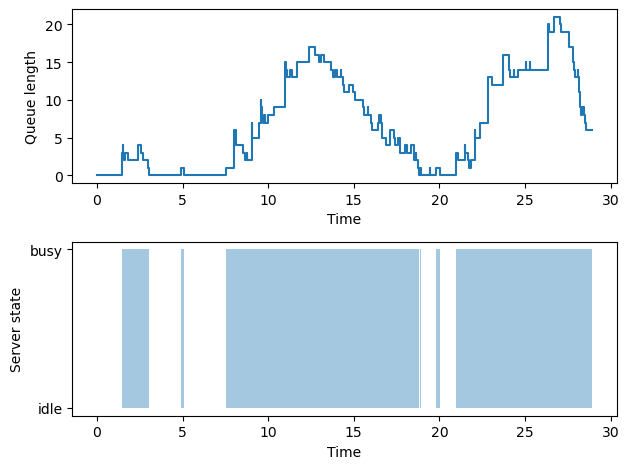

In [12]:
if LOGGED and PLOTTED:
    import matplotlib.pyplot as plt
    log = np.loadtxt('mm1-l%d-m%d.csv' %(LAMBDA, MU), delimiter = '\t')
    plt.subplot(2, 1, 1)
    plt.xlabel('Time')
    plt.ylabel('Queue length')
    plt.step(log[:200,0], log[:200,2], where='post')
    plt.subplot(2, 1, 2)
    plt.xlabel('Time' )
    plt.ylabel('Server state' )
    plt.yticks([0, 1], ['idle', 'busy'])
    #plt.step( log[:200,0], log[:200,1], where='post' )
    plt.fill_between(log[:200,0], 0, log[:200,1], step="post", alpha=.4)
    plt.tight_layout()
    plt.show()